## Import

In [1]:
import os

import numpy as np

import nengo
from nengo.params import Default, NumberParam
from nengo.utils.matplotlib import rasterplot
from nengo.dists import Uniform
from nengo.solvers import LstsqL2, NoSolver
from nengo.neurons import *
from nengo.builder.neurons import *

from nengolib.signal import s, nrmse, LinearSystem
from nengolib.synapses import Lowpass

from hyperopt import fmin, tpe, hp, STATUS_OK, Trials

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(context='poster', style='whitegrid')
%matplotlib inline

## WilsonNeuron Definition

In [2]:
class WilsonNeuron(NeuronType):
    """
    Wilson Neuron Model.
    
    Description
    -----------
    
    TODO
    
    Paramters
    ---------
    
    time constants in seconds
    voltages in mV
    
    References
    ----------
    [1] Wilson, Hugh R. "Simplified dynamics of human and mammalian neocortical neurons."
        Journal of theoretical biology 200.4 (1999): 375-388.

    
    """
    
    probeable = ('spikes', 'voltage', 'recovery', 'conductance', 'AP')
    threshold = NumberParam('threshold')
    tau_V = NumberParam('tau_V')
    tau_R = NumberParam('tau_R')
    tau_H = NumberParam('tau_H')
    
    def __init__(self, threshold=-0.20, tau_V=0.00097, tau_R=0.0056, tau_H=0.0990):
        super(WilsonNeuron, self).__init__()
        self.threshold = threshold
        self.tau_V = tau_V
        self.tau_R = tau_R
        self.tau_H = tau_H
        
    @property
    def _argreprs(self):
        args = []
        def add(attr, default):
            if getattr(self, attr) != default:
                args.append("%s=%s" %(attr, getattr(self, attr)))
        add("threshold", -0.20)
        add("tau_V", 0.00097)
        add("tau_R", 0.0056)
        add("tau_H", 0.0990)
        return args
        
    def rates(self, x, gain, bias):
        return x  # todo
    
    def gain_bias(self, max_rates, intercepts):
        return np.ones(len(max_rates)), np.ones(len(max_rates))  # todo
    
    def step_math(self, dt, J, spiked, voltage, recovery, conductance, AP):

        dV = -(17.81 + 47.58*voltage + 33.80*np.square(voltage))*(voltage - 0.48) - 26*recovery*(voltage + 0.95) - 13*conductance*(voltage + 0.95) + J
        dR = -recovery + 1.29*voltage + 0.79 + 3.30*np.square(voltage + 0.38)
        dH = -conductance + 11*(voltage + 0.754)*(voltage + 0.69)
        
        voltage[:] = (voltage + dV * dt/self.tau_V).clip(-0.9, 0.3)
        recovery[:] = (recovery + dR * dt/self.tau_R)  # .clip(0.18, 0.42)
        conductance[:] = (conductance + dH * dt/self.tau_H)  # .clip(0, 0.23)
        spiked[:] = (voltage > self.threshold) & (~AP)
        spiked /= dt
        AP[:] = voltage > self.threshold
        
#         voltage[:] += dV * dt/self.tau_V
#         recovery[:] += dR * dt/self.tau_R
#         conductance[:] += dH * dt/self.tau_H
#         spiked[:] = (voltage > self.threshold) & (~AP)
#         spiked /= dt
#         AP[:] = voltage > self.threshold



@Builder.register(WilsonNeuron)
def build_wilsonneuron(model, neuron_type, neurons):
    model.sig[neurons]['voltage'] = Signal(
        -0.754*np.ones(neurons.size_in), name="%s.voltage" % neurons)
    model.sig[neurons]['recovery'] = Signal(
        0.279*np.ones(neurons.size_in), name="%s.recovery" % neurons)
    model.sig[neurons]['conductance'] = Signal(
        0.0*np.ones(neurons.size_in), name="%s.conductance" % neurons)
    model.sig[neurons]['AP'] = Signal(
        np.zeros(neurons.size_in, dtype=bool), name="%s.AP" % neurons)
    model.add_op(SimNeurons(
        neurons=neuron_type,
        J=model.sig[neurons]['in'],
        output=model.sig[neurons]['out'],
        states=[model.sig[neurons]['voltage'],
            model.sig[neurons]['recovery'],
            model.sig[neurons]['conductance'],
            model.sig[neurons]['AP']]))

## Network Definition


In [3]:
def norms(signal, freq, amp, ss, tau, t, dt=0.001, plot=False):
    lpf=nengo.Lowpass(tau)
    with nengo.Network() as model:
        if signal == 'cos':
            stim = nengo.Node(output=lambda t: amp*np.cos(freq*t))
        elif signal == 'white_noise':
            stim = nengo.Node(nengo.processes.WhiteSignal(period=t/2, high=freq, rms=amp, seed=ss))
        p_stim = nengo.Probe(stim, synapse=None)
        p_integral = nengo.Probe(stim, synapse=1/s)
    with nengo.Simulator(model, progress_bar=False, dt=dt) as sim:
        sim.run(t, progress_bar=False)
    stimulus = sim.data[p_stim]
    target = sim.data[p_integral]
    target_f = lpf.filt(sim.data[p_integral], dt=dt)
    norm_s = np.max(np.abs(stimulus))
    norm = np.max(np.abs(target))
    norm_f = np.max(np.abs(target_f))
    if plot:
        plt.plot(sim.trange(), stimulus, label='stim', alpha=0.5)
        plt.plot(sim.trange(), target, label='integral', alpha=0.5)
        plt.plot(sim.trange(), lpf.filt(sim.data[p_integral]/norm_f, dt=dt), label='target', alpha=0.5)
        plt.legend()
        plt.show()
    return norm, norm_s, norm_f

In [4]:
def simulate(  
    d,
    d_JL,
    t=1,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    signal='cos',
    freq=1,
    amp=1,
    reg=0.01,
    n_unroll=0,
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    neuron_type=nengo.LIF(),
    max_rates=Default,
    gain=Default,
    bias=Default,
    **kwargs):
    
    # transform input signal u so that the integral x is normalized to np.max(x)==1
    norm, norm_s, norm_f = norms(signal, freq, amp, seeds['ss'], taus['network'], t, dt=dt, plot=False)
    d_full = np.hstack((d, d_JL))
    dim = d_full.shape[1]
#     fb_dim = d.shape[1]
#     jl_dim = d_JL.shape[1]
    
    # Simulate the full network, skipping simulation of supv or bio when possible.
    with nengo.Network(seed=seeds['ns']) as model:
        # Nodes
        model.T = t
        def flip(t, x):
            if t<model.T/2: return x
            elif t>=model.T/2: return -1.0*x
        if signal == 'cos':
            u_raw = nengo.Node(output=lambda t: amp*np.cos(freq*t))
        elif signal == 'white_noise':
            u_raw = nengo.Node(nengo.processes.WhiteSignal(period=model.T/2, high=freq, rms=amp, seed=seeds['ss']))
        u = nengo.Node(output=flip, size_in=1)
                                              
        # Ensembles
        pre_u = nengo.Ensemble(n_pre, 1, max_rates=max_rates, seed=seeds['es'], radius=norm_s)
        pre_x = nengo.Ensemble(n_pre, 1, max_rates=max_rates, seed=seeds['es'], radius=norm)
        ens_list = []
        for n in range(n_unroll+1):
            ens_list.append(
                nengo.Ensemble(n_neurons, dim,
                    gain=gain, bias=bias, max_rates=max_rates,
                    neuron_type=neuron_type, normalize_encoders=False,
                    seed=seeds['es'], label='%s'%n))
        unsupv = nengo.Ensemble(n_neurons, dim,
                gain=gain, bias=bias, max_rates=max_rates,
                neuron_type=neuron_type, normalize_encoders=False,
                seed=seeds['es'], label='unsupv')
        lif = nengo.Ensemble(n_neurons, 1, max_rates=max_rates, neuron_type=nengo.LIF(), seed=seeds['es'])
        tar = nengo.Ensemble(1, 1, neuron_type=nengo.Direct())

        # normal connections
        nengo.Connection(u_raw, u, synapse=None, seed=seeds['cs'])
        nengo.Connection(u, pre_u, synapse=None, seed=seeds['cs'])
        nengo.Connection(u, pre_x, synapse=1/s, seed=seeds['cs'])
        nengo.Connection(u, tar, synapse=1/s, transform=1.0/norm_f)
        nengo.Connection(pre_u, lif, synapse=taus['network'], transform=taus['network']/norm_f)
#         nengo.Connection(pre_x, lif, synapse=taus['network'], transform=1.0/norm_f)  # proxy for accuracy
        nengo.Connection(lif, lif, synapse=taus['network'])
        
        # supervised connections (train)
        u_ens_list = []
        for n in range(n_unroll+1):
            u_ens_list.append(nengo.Connection(pre_u, ens_list[n][0],
                synapse=taus['network'],
                transform=taus['network']/norm_f,
                seed=seeds['cs']))
        ens_ens_list = []
        for n in range(n_unroll):
            ens_ens_list.append(nengo.Connection(ens_list[n], ens_list[n+1],
                synapse=taus['network'],
                solver=NoSolver(d_full),
                seed=seeds['cs']))
        nengo.Connection(pre_x, ens_list[0][0],
            synapse=taus['network'],
            transform=1.0/norm_f,
            seed=seeds['cs'])
        
        # unsupervised connections (test)
        nengo.Connection(pre_u, unsupv[0],
            synapse=taus['network'],
            transform=taus['network']/norm_f)
        nengo.Connection(unsupv, unsupv,
            synapse=taus['network'],
            solver=NoSolver(d_full),
            seed=seeds['cs'])

        # probes (down sample to dt_sample in post-processing for spiking ensembles)
        p_stim = nengo.Probe(u, synapse=None, sample_every=dt)
        p_target = nengo.Probe(tar, synapse=None, sample_every=dt)
        p_spk_list = []
        for n in range(n_unroll+1):
            p_spk_list.append(nengo.Probe(ens_list[n].neurons, synapse=None, sample_every=dt))
        p_spk_unsupv = nengo.Probe(unsupv.neurons, synapse=None, sample_every=dt)
        p_spk_lif = nengo.Probe(lif.neurons, sample_every=dt)
        p_lif = nengo.Probe(lif, synapse=taus['readout'], sample_every=dt)
        

    # Run the simulation
    with nengo.Simulator(model, seed=seeds['ss'], dt=dt, progress_bar=False) as sim:
        sim.run(t, progress_bar=True)
        
    spk_list = [sim.data[p_spk_list[n]] for n in range(n_unroll+1)]
        
    return sim.data[p_stim], sim.data[p_target], spk_list, sim.data[p_spk_unsupv],  sim.data[p_lif]

## Optimization

In [5]:
def optimize_h_d(
    d,
    d_JL, 
    h,
    n_unroll,
    stim_data,
    target_data,
    spk_list_data,
    spk_unsupv_data,
    lif_data,
    n_neurons=100,
    reg=0.1,
    taus={'network': 0.1, 'readout': 0.1},
    dt=0.001,
    dt_sample=0.001,
    optimize=True,
    n_zeros=1,
    n_poles=3,
    z_min=2, 
    z_max=3, 
    p_min=1, 
    p_max=2, 
    max_evals=100,
    plot=False,
    **kwargs):
    
    ''' Collect spikes, activities and lif estimates '''
    lpf = nengo.Lowpass(taus['readout'])
    stim = lpf.filt(stim_data, dt=dt)[::int(dt_sample/dt)]
    target = lpf.filt(target_data, dt=dt)[::int(dt_sample/dt)]
    times = dt_sample * np.arange(0, len(target), 1)
    A = np.zeros((n_unroll+1, len(times), n_neurons))
    all_spikes = np.array([spk_list_data[n] for n in range(n_unroll+1)])
    A_stack = np.zeros((len(times)*(n_unroll+1), n_neurons))
#     A_unsupv = lpf.filt(spk_unsupv_data, dt=dt)[::int(dt_sample/dt)]
    A_unsupv = h.filt(spk_unsupv_data, dt=dt)[::int(dt_sample/dt)]
    Y = np.zeros((n_unroll+1, len(times), 1))
    Y_stack = np.zeros((len(times)*(n_unroll+1), 1))
    for n in range(n_unroll+1):
        A[n] = h.filt(spk_list_data[n], dt=dt)[::int(dt_sample/dt)]
#         A[n] = lpf.filt(spk_list_data[n], dt=dt)[::int(dt_sample/dt)]
        Y[n] = np.array(target)
        A_stack[n*len(times):(n+1)*len(times)] = A[n]
        Y_stack[n*len(times):(n+1)*len(times)] = Y[n]
    xhat_lif = lif_data[::int(dt_sample/dt)]
    nrmse_lif = nrmse(xhat_lif, target=target)
    xhats = np.zeros_like(Y)
    nrmses = np.zeros((n_unroll+1))
    for n in range(n_unroll+1):
        xhats[n] = np.dot(A[n], d)
        nrmses[n] = nrmse(xhats[n], target=target)
    xhat_unsupv = np.dot(A_unsupv, d)
    nrmse_unsupv = nrmse(xhat_unsupv, target=target)

    ''' Compute new recurrent decoder from a stacked A and Y matrix '''
    if optimize:
#         print("optimizing h ...")
        savefile = "/home/pduggins/nengo_bioneurons/nengo_bioneurons/tests/data/trinity/stacked_spikes_targets.npz"
        np.savez(savefile, spikes=all_spikes, target=Y_stack)
#         h_new, d_new = hyperopt_filter_polezero(
        h_new, d_new = hyperopt_filter_transferfunction(
            savefile,
            n_neurons,
            n_unroll,
            taus['readout'],
            dt=dt,
            dt_sample=dt_sample,
            n_zeros=n_zeros,
            n_poles=n_poles,
            z_min=z_min,
            z_max=z_max,
            p_min=p_min,
            p_max=p_max,
            reg=reg,
            max_evals=max_evals,
            normalize=True,
            plot=plot,
            **kwargs)
    else:
        h_new = h
        d_new = LstsqL2(reg=reg)(A_stack, Y_stack)[0]

    ''' Plot 'em, mash 'em, stick 'em in a stew '''
    if plot:
#         fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8), sharex=True)
#         rasterplot(sim.trange(), spikes_unsupv, ax=ax1)
#         ax2.plot(times, lpf.filt(sim.data[p_spike_list[-1]], dt=dt_sample))
#         ax2.plot(sim.trange(), lpf.filt(spikes_unsupv, dt=dt))
#         ax1.set(xlabel='time', ylabel='neuron')
#         ax2.set(xlabel='time', ylabel='firing rate (Hz)')
#         plt.tight_layout()

#         fig, ax1 = plt.subplots(1, 1, figsize=(8, 4))
#         for n in range(n_unroll+1):
#             sns.distplot(np.ravel(A[n]), ax=ax1, label='%s unrolling' %n)
#         sns.distplot(np.ravel(A_unsupv), ax=ax1, label='unsupervised', hist=True)
#         ax1.set(xlim=((1, 400)), ylim=((0, 0.03)), xlabel='firing rate (Hz)', ylabel='frequency')
#         plt.legend()
#         plt.tight_layout()

        cmap = sns.color_palette('hls', n_unroll)
        fig, ax = plt.subplots(1, 1, figsize=(8, 4))
        ax.plot(times, target, label='target', linestyle='--')
        ax.plot(times, xhat_lif, alpha=0.5, label='lif, nrmse=%.3f' %nrmse_lif)
        for n in range(n_unroll+1):
            ax.plot(times, xhats[n], alpha=0.5)  # , label='unroll %s, nrmse=%.3f' %(n, nrmses[n]) 
        ax.plot(times, xhat_unsupv, label='unsupervised, nrmse=%.3f' %nrmse_unsupv)
        if d_JL.shape[1] > 0:
            ax.plot(times, np.dot(A_unsupv, d_JL), label='JL dim')
        ax.set(xlabel='time', ylabel='$\mathbf{x}$')
        ax.legend(loc='lower left')
        plt.tight_layout()
        plt.show()

    return h_new, d_new, nrmse_unsupv

In [6]:
def hyperopt_filter_transferfunction(
    savefile,
    n_neurons,
    n_unroll,
    tau,
    dt=0.001,
    dt_sample=0.001,
    n_zeros=2,
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    reg=0.01,
    max_evals=100,
    normalize=True,
    plot=False,
    **kwargs):
    
    hyps = dict()  # hyperparameters
    hyps['savefile'] = savefile
    for z in range(n_zeros):  
        hyps['%s_num'%z] = hp.uniform('%s_num'%z, z_min, z_max)
    for p in range(n_poles): # terms in denominator (not poles)
        hyps['%s_den'%p] = hp.uniform('%s_den'%p, p_min, p_max)

    def objective(hyps):
        num = 1  # constant term?
        den = 1  # constant term?
        for z in range(n_zeros): # terms in numerator (not zeros)
            num += s**(z+1) * hyps['%s_num'%z]
        for p in range(n_poles): # terms in denominator (not poles)
            den += s**(p+1) * hyps['%s_den'%p]  
        h = num / den
        if normalize:
            h /= h.dcgain
        
        spikes = np.load(hyps['savefile'])['spikes']
        target = np.load(hyps['savefile'])['target']
        A_stack = np.zeros((len(spikes[0])*(n_unroll+1), n_neurons))
        for n in range(n_unroll+1):
            A_stack[n*len(spikes[0]):(n+1)*len(spikes[0])] = h.filt(spikes[n], dt=dt)[::int(dt_sample/dt)]
        if np.sum(A_stack) != 0:
            d = nengo.solvers.LstsqL2(reg=reg)(A_stack, target)[0]
        else:
            d = np.zeros((n_neurons, 1))
        xhat = np.dot(A_stack, d)
        if np.sum(target) != 0:
            loss = nrmse(xhat, target=target)
        else:
            loss = rmse(xhat, target)

        return {'loss': loss, 'h': h, 'd': d, 'status': STATUS_OK }

    trials = Trials()

    best = fmin(objective,
        rstate=np.random.RandomState(seed=kwargs['seeds']['ss']+n_unroll),
        space=hyps,
        algo=tpe.suggest,
        max_evals=max_evals,
        trials=trials)

    best_idx = np.array(trials.losses()).argmin()
    best_h = trials.trials[best_idx]['result']['h']
    best_d = trials.trials[best_idx]['result']['d']
    
    if plot:
        times = np.arange(0, 1, 0.001)
        xs = [t['tid'] for t in trials.trials]
        ys = [t['result']['loss'] for t in trials.trials]
        fig, (ax, ax2) = plt.subplots(2, 1, figsize=((8, 8)))
        ax.scatter(xs, ys)
        ax.set(xlabel='hyperopt iteration', ylabel='nrmse')
        ax2.plot(times, Lowpass(tau).impulse(len(times)), label='lowpass')
        ax2.plot(times, best_h.impulse(len(times)), label='optimized')
        plt.tight_layout()
        plt.show()
        

    return best_h, best_d

In [7]:
def hyperopt_filter_polezero(
    savefile,
    n_neurons,
    n_unroll,
    tau,
    dt=0.001,
    dt_sample=0.001,
    n_zeros=1,
    n_poles=3,
    z_min=2,
    z_max=3,
    p_min=1,
    p_max=2,
    reg=0.01,
    max_evals=100,
    normalize=True,
    plot=False,
    **kwargs):
    
    hyps = dict()  # hyperparameters
    hyps['savefile'] = savefile
    for z in range(n_zeros):
#         hyps['%s_zero'%z] = hp.uniform('%s_zero'%z, z_min, z_max)
        hyps['%s_zero'%z] = hp.loguniform('%s_zero'%z, z_min, z_max)
    for p in range(n_poles):
#         hyps['%s_pole'%p] = hp.uniform('%s_pole'%p, p_min, p_max)
        hyps['%s_pole'%p] = hp.loguniform('%s_pole'%p, p_min, p_max)

    def objective(hyps):
        zeros = np.array([hyps['%s_zero'%z] for z in range(n_zeros)])
        poles = np.array([-1.0*hyps['%s_pole'%p] for p in range(n_poles)])
        h = LinearSystem((zeros, poles, 1.0))
        if normalize:
            h /= h.dcgain
        
        spikes = np.load(hyps['savefile'])['spikes']
        target = np.load(hyps['savefile'])['target']
        A_stack = np.zeros((len(spikes[0])*(n_unroll+1), n_neurons))
        for n in range(n_unroll+1):
            A_stack[n*len(spikes[0]):(n+1)*len(spikes[0])] = h.filt(spikes[n], dt=dt)[::int(dt_sample/dt)]
        if np.sum(A_stack) != 0:
            d = nengo.solvers.LstsqL2(reg=reg)(A_stack, target)[0]
        else:
            d = np.zeros((n_neurons, 1))
        xhat = np.dot(A_stack, d)
        if np.sum(target) != 0:
            loss = nrmse(xhat, target=target)
        else:
            loss = rmse(xhat, target)

        return {'loss': loss, 'h': h, 'd': d, 'status': STATUS_OK }

    trials = Trials()

    best = fmin(objective,
        rstate=np.random.RandomState(seed=kwargs['seeds']['ss']+n_unroll),
        space=hyps,
        algo=tpe.suggest,
        max_evals=max_evals,
        trials=trials)

    best_idx = np.array(trials.losses()).argmin()
    best_h = trials.trials[best_idx]['result']['h']
    best_d = trials.trials[best_idx]['result']['d']
    
    if plot:
        times = np.arange(0, 1, 0.001)
        xs = [t['tid'] for t in trials.trials]
        ys = [t['result']['loss'] for t in trials.trials]
        fig, (ax, ax2) = plt.subplots(2, 1, figsize=((8, 8)))
        ax.scatter(xs, ys)
        ax.set(xlabel='hyperopt iteration', ylabel='nrmse')
        ax2.plot(times, Lowpass(tau).impulse(len(times)), label='lowpass')
        ax2.plot(times, best_h.impulse(len(times)), label='optimized')
        plt.tight_layout()
        plt.show()
        

    return best_h, best_d

## Control Structure

In [8]:
def unroll_best(n_unroll, signal='cos', optimize=True, plot=False, **kwargs):
    d = np.zeros((kwargs['n_neurons'], 1))
    h = Lowpass(kwargs['taus']['readout'])
#     d_JL = np.random.RandomState(seed=kwargs['seeds']['ls']).normal(
#         0, kwargs['jl_sigma'], size=(kwargs['n_neurons'], kwargs['jl_dim']))
    d_JL = np.random.RandomState(seed=kwargs['seeds']['ls']).randn(
        kwargs['n_neurons'], kwargs['jl_dim']) * kwargs['jl_sigma']

    nrmses = np.zeros((n_unroll+1))
    ds = np.zeros((n_unroll+1, kwargs['n_neurons'], 1))
    hs = np.empty((n_unroll+1), dtype=object)
    for n in range(n_unroll+1):
        print("unrolling #%s" %n)
        ds[n] = d
        hs[n] = h
        stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data = simulate(
            d, d_JL, n_unroll=n, signal=signal, **kwargs)
        h, d, nrmse = optimize_h_d(
            d, d_JL, h, n, stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data,
            optimize=optimize, plot=plot, **kwargs)
        nrmses[n] = nrmse
        print('nrmse = %.3f' %nrmse)
    
    d_best = ds[np.argmin(nrmses)]
    h_best = np.array(hs)[np.argmin(nrmses)]
    
    fig, ax = plt.subplots(1, 1, figsize=((8, 4)))
    ax.plot(np.arange(0, n_unroll+1), nrmses)
    ax.set(xlabel='unrollings', ylabel='nrmse')
    plt.show()

    times = np.arange(0, 1, 0.001)
    fig, ax = plt.subplots(1, 1, figsize=((8, 4)))
    ax.plot(times, Lowpass(kwargs['taus']['readout']).impulse(len(times)), label='lowpass')
    ax.plot(times, h.impulse(len(times)), label='optimized')
    ax.set(xlabel='time', ylabel='amplitude')
    plt.legend()
    plt.show()
    
    # test the unsupervised network
    kwargs['seeds']['ss'] = kwargs['seeds']['ss'] + 1  # new white_noise seed
    kwargs['freq'] = 1  # for fixed white-noise testing
    kwargs['t'] = 10  # for fixed white-noise testing
    stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data = simulate(
        d_best, d_JL, n_unroll=0, signal='white_noise', **kwargs)
    _, _, _ = optimize_h_d(
        d_best, d_JL, h_best, 0, stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data,
        optimize=False, plot=True, **kwargs)
    
    return d_best, h_best

In [9]:
def filter_first(n_unroll, signal='cos', optimize=True, plot=False, **kwargs):
    d = np.zeros((kwargs['n_neurons'], 1))
    h = Lowpass(kwargs['taus']['readout'])
    d_JL = np.random.RandomState(seed=kwargs['seeds']['ls']).randn(
        kwargs['n_neurons'], kwargs['jl_dim']) * kwargs['jl_sigma']
    nrmses = np.zeros((n_unroll+1))
    ds = np.zeros((n_unroll+1, kwargs['n_neurons'], 1))

    # first calculate a readout filter "h" for the 0th unrolling ensemble
    stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data = simulate(
            d, d_JL, n_unroll=0, signal=signal, **kwargs)
    h, _, _ = optimize_h_d(
        d, d_JL, h, 0, stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data,
        optimize=optimize, plot=True, **kwargs)
        
    for n in range(n_unroll+1):
        print("unrolling #%s" %n)
        ds[n] = d
        stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data = simulate(
            d, d_JL, n_unroll=n, signal=signal, **kwargs)
        h, d, nrmse = optimize_h_d(
            d, d_JL, h, n, stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data,
            optimize=False, plot=plot, **kwargs)
        nrmses[n] = nrmse
        print('nrmse = %.3f' %nrmse)
    
    d_best = ds[np.argmin(nrmses)]
    
    fig, ax = plt.subplots(1, 1, figsize=((8, 4)))
    ax.plot(np.arange(0, n_unroll+1), nrmses)
    ax.set(xlabel='unrollings', ylabel='nrmse')
    plt.show()
    
    # test the unsupervised network
    kwargs['seeds']['ss'] = kwargs['seeds']['ss'] + 1  # new white_noise seed
    kwargs['freq'] = 1  # for fixed white-noise testing
    stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data = simulate(
        d_best, d_JL, n_unroll=0, signal='white_noise', **kwargs)
    _, _, _ = optimize_h_d(
        d_best, d_JL, h, 0, stim_data, target_data, spk_list_data, spk_unsupv_data, lif_data,
        optimize=False, plot=True, **kwargs)
    
    return d_best, h

# Simulations

## LIF

### baseline

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

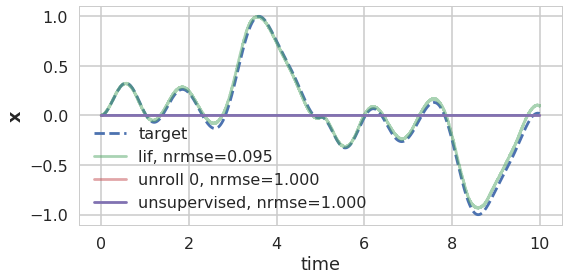

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

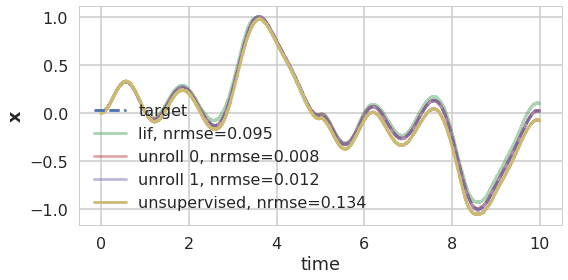

nrmse = 0.134
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

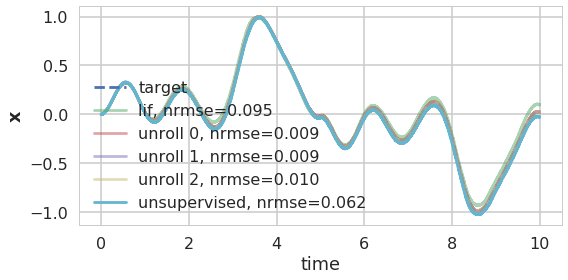

nrmse = 0.062
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

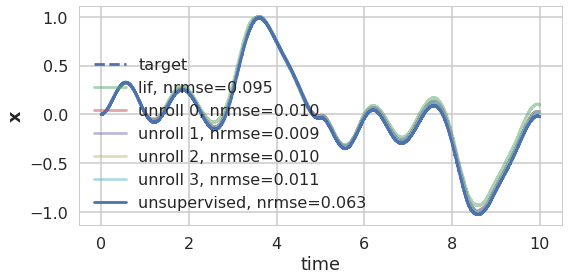

nrmse = 0.063
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

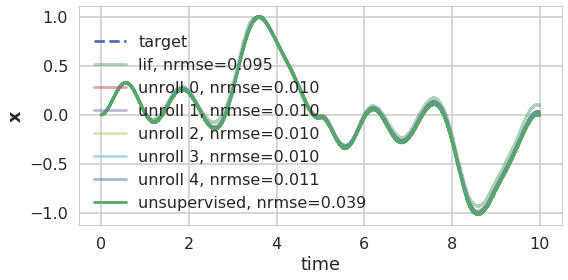

nrmse = 0.039
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

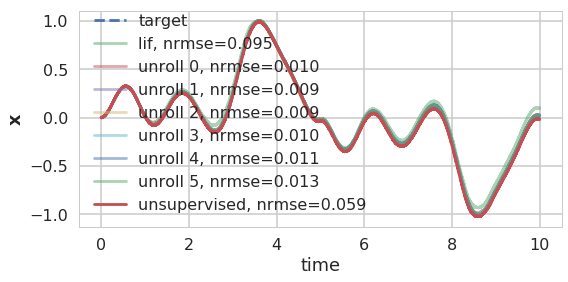

nrmse = 0.059
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

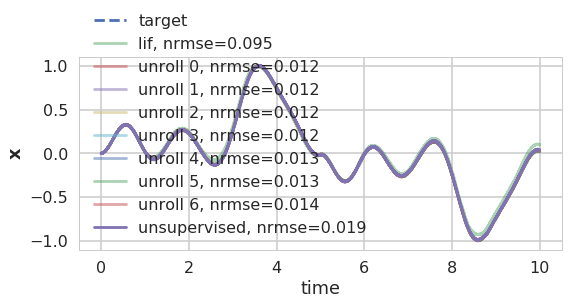

nrmse = 0.019


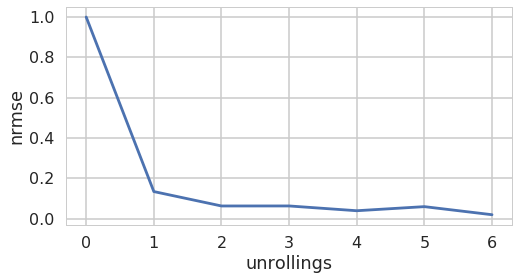

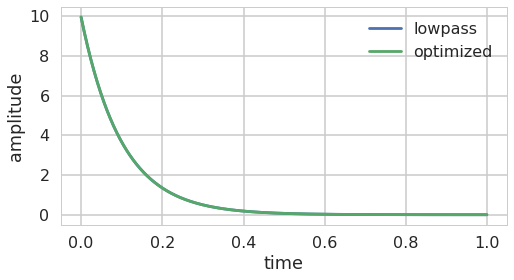

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

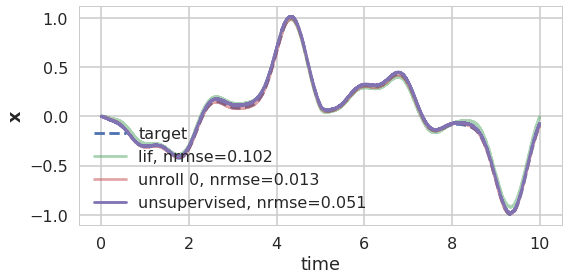

In [79]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

### JL dimensions

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

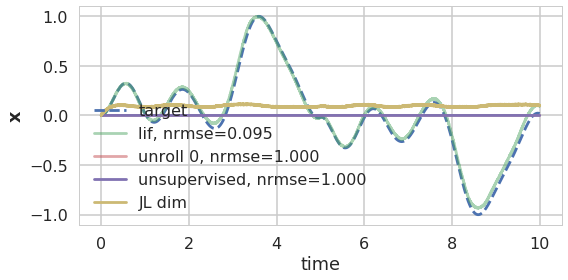

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

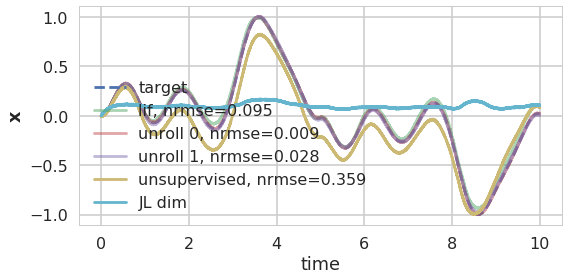

nrmse = 0.359
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

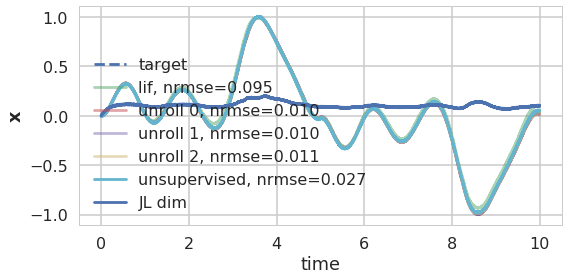

nrmse = 0.027
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

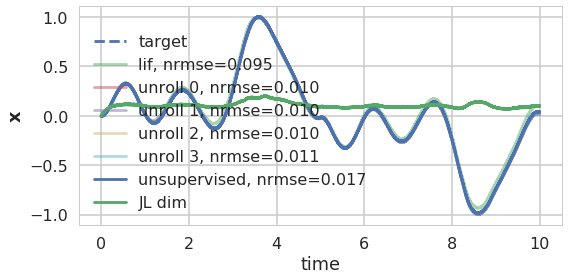

nrmse = 0.017
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

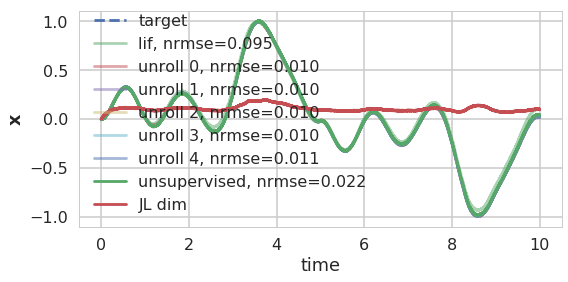

nrmse = 0.022
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

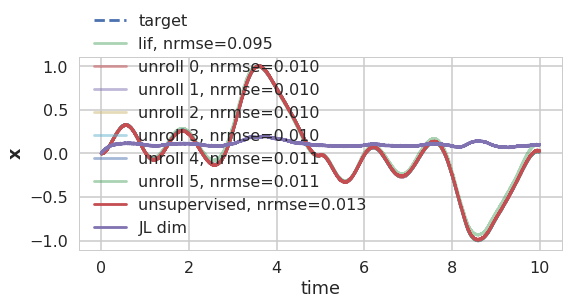

nrmse = 0.013
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

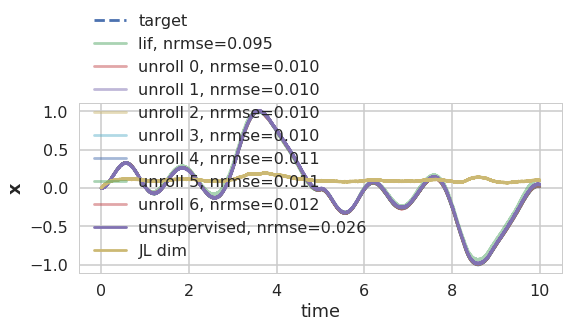

nrmse = 0.026


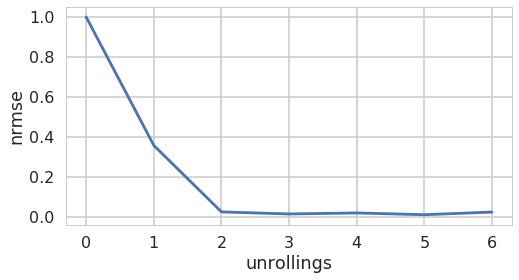

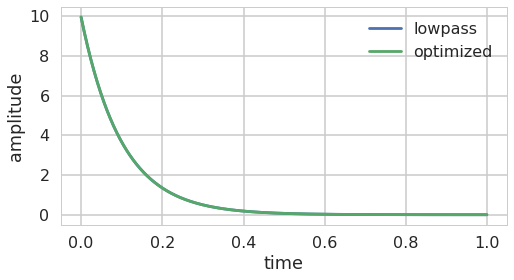

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

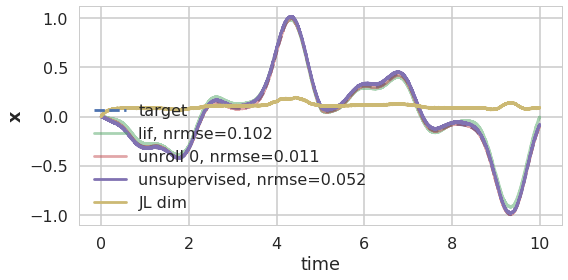

In [82]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

### filter

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

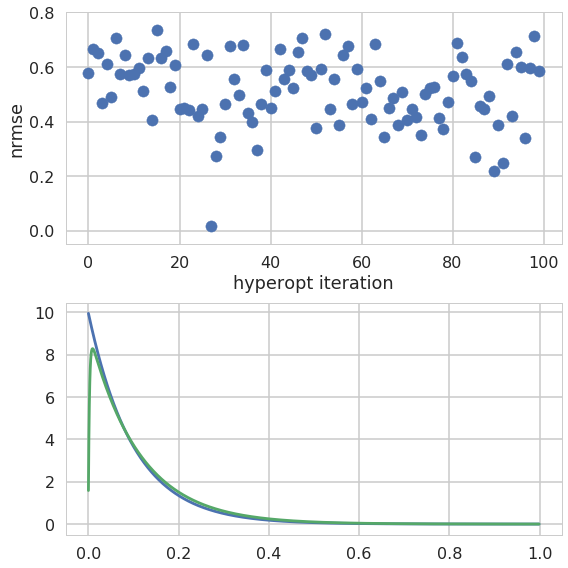

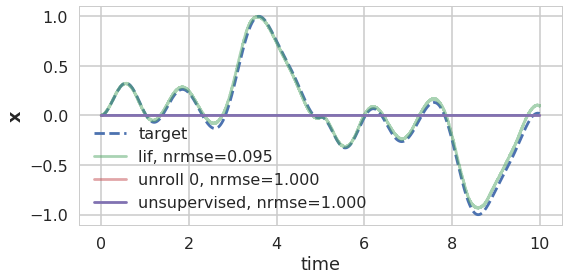

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

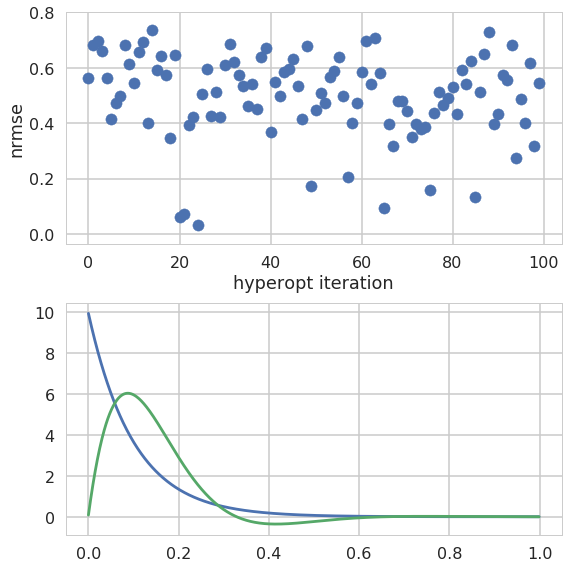

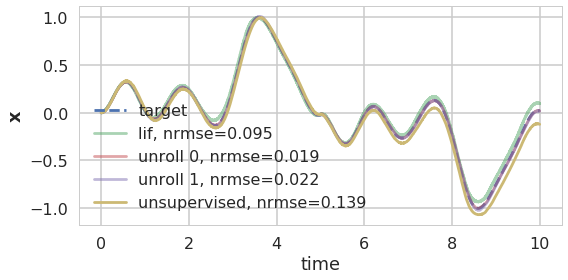

nrmse = 0.139
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

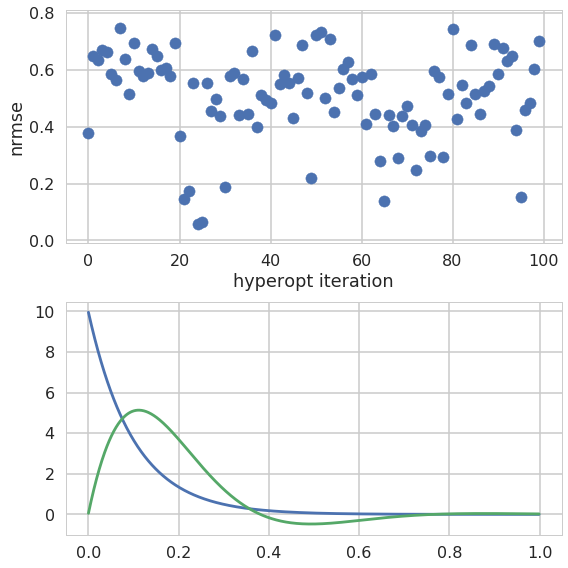

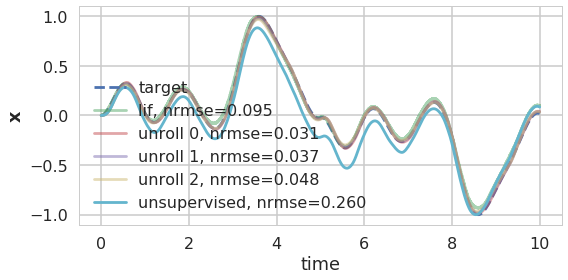

nrmse = 0.260
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

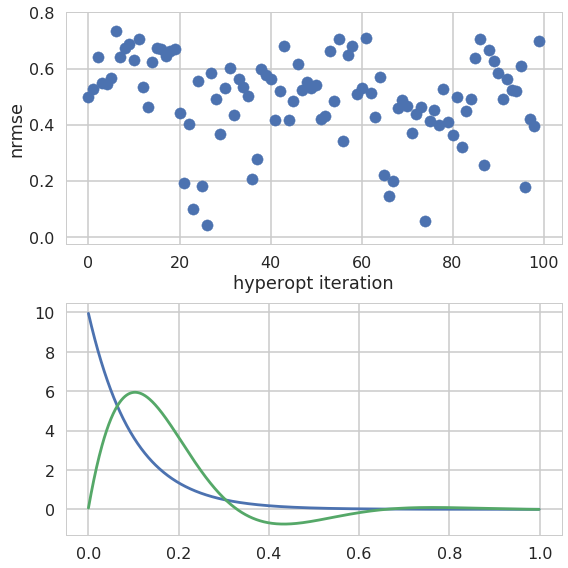

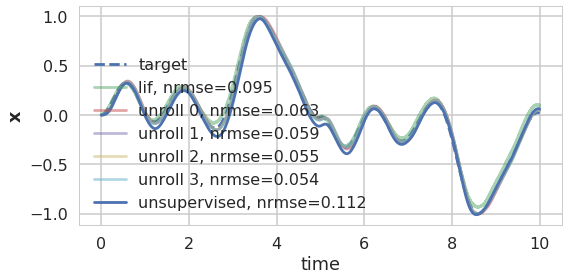

nrmse = 0.112
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

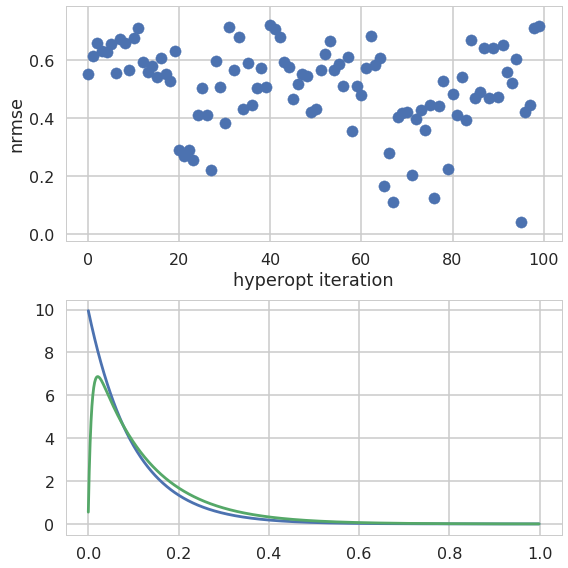

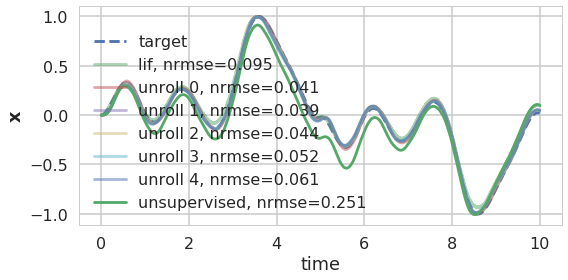

nrmse = 0.251
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

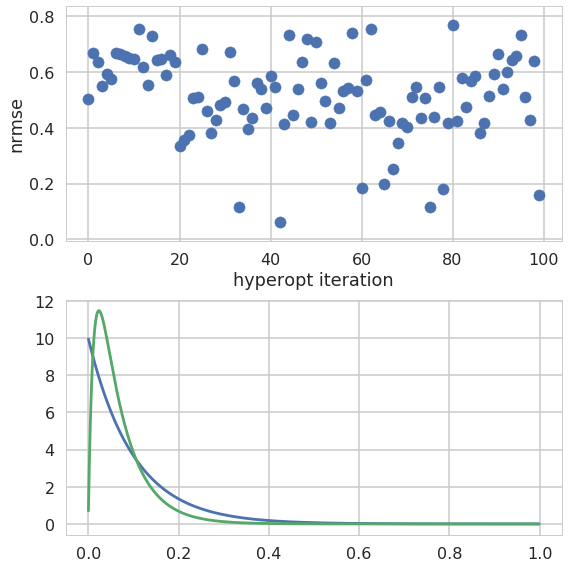

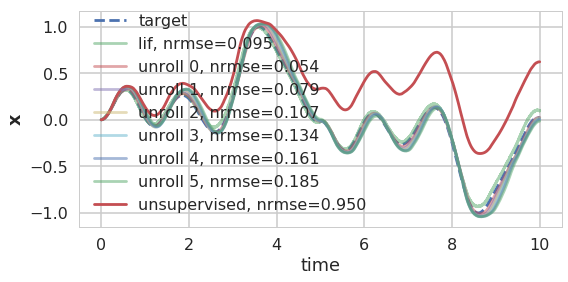

nrmse = 0.950
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

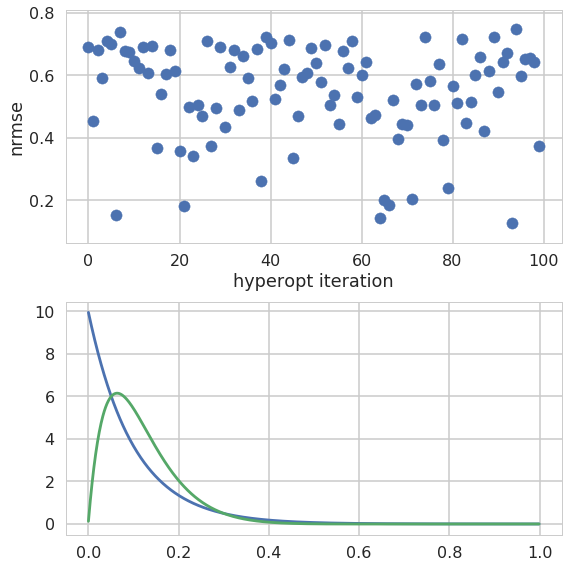

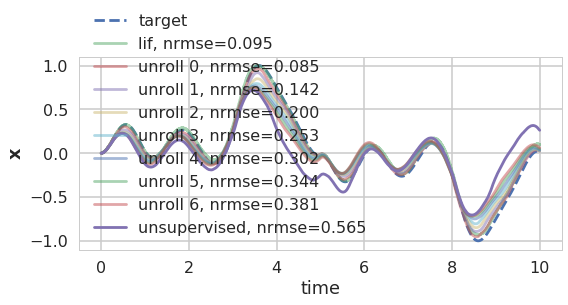

nrmse = 0.565


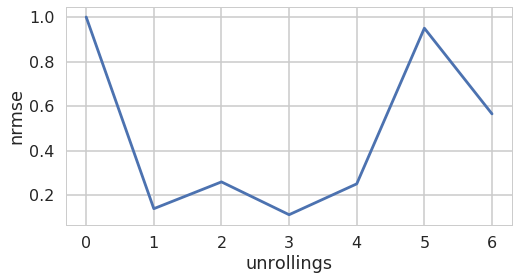

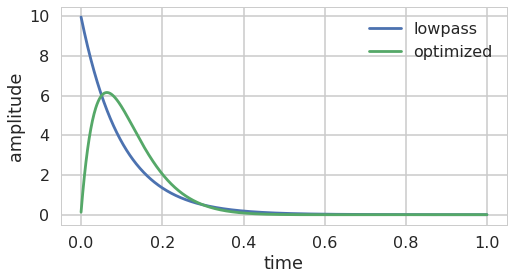

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

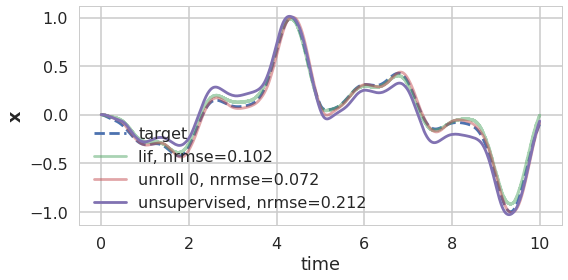

In [83]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=2,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

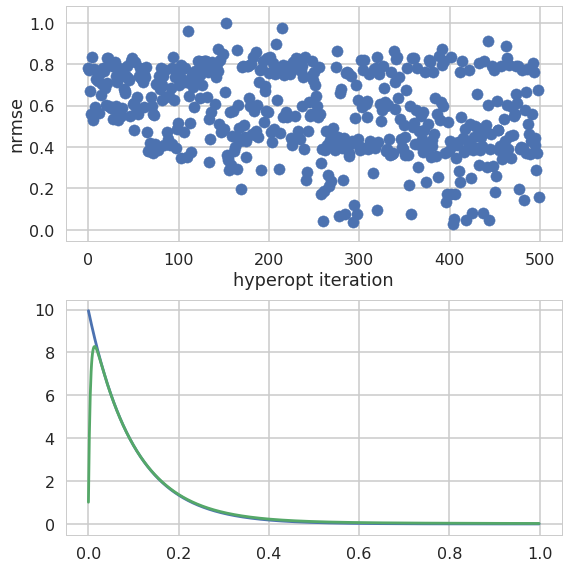

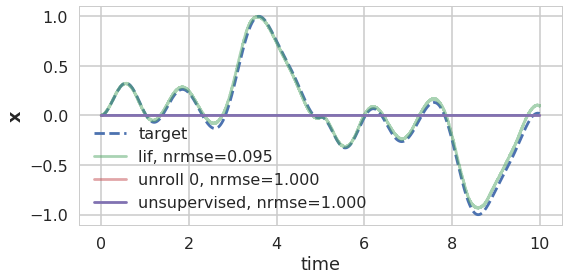

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

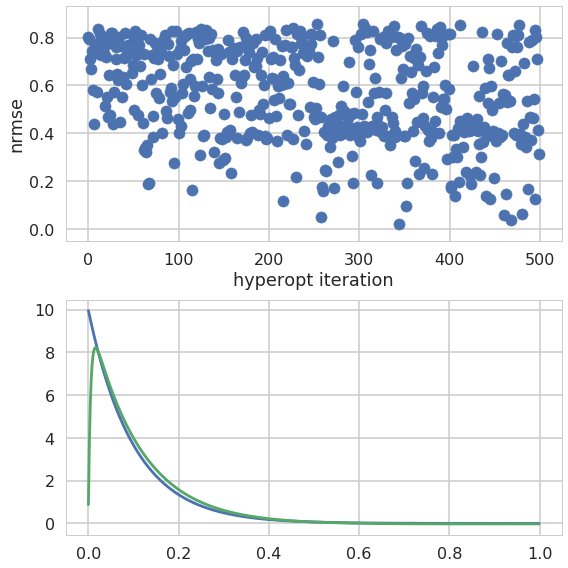

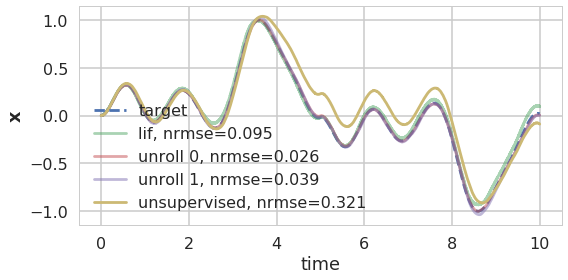

nrmse = 0.321
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

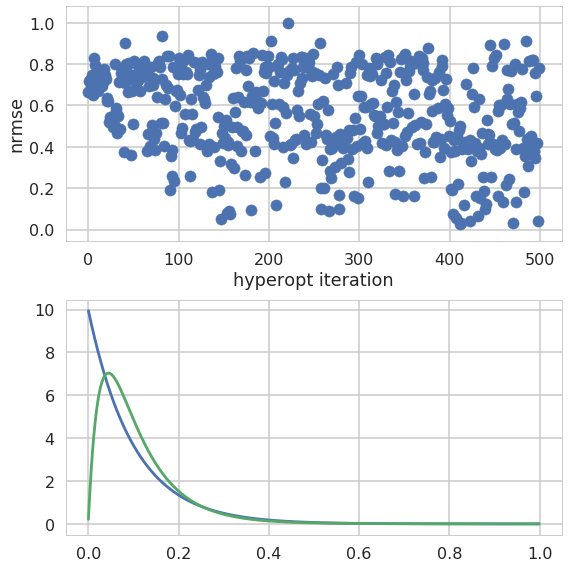

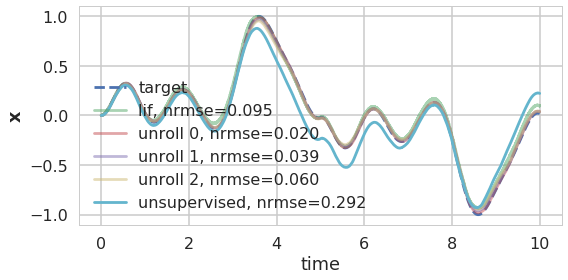

nrmse = 0.292
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

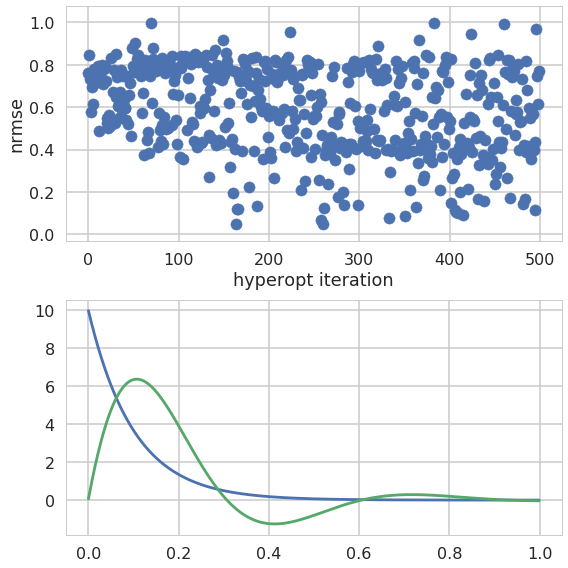

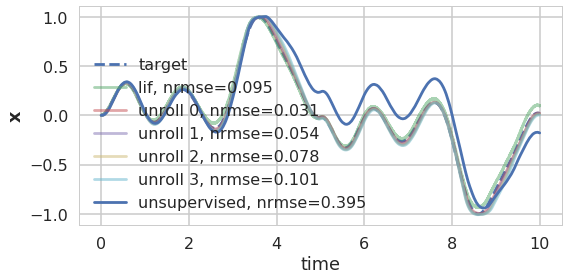

nrmse = 0.395
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

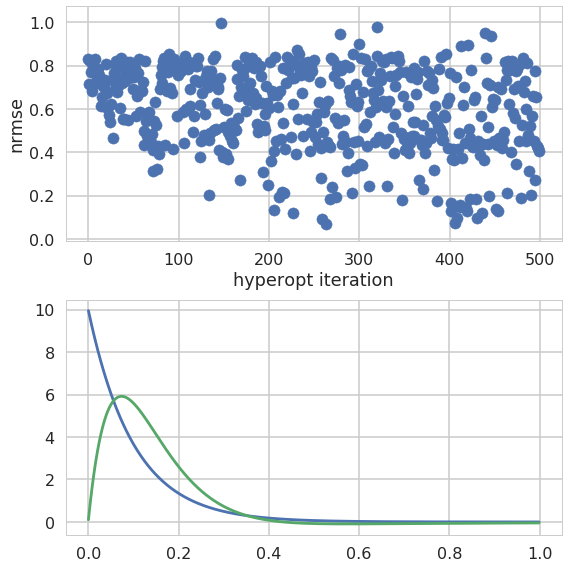

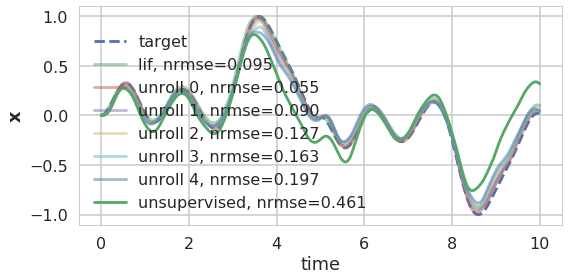

nrmse = 0.461
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

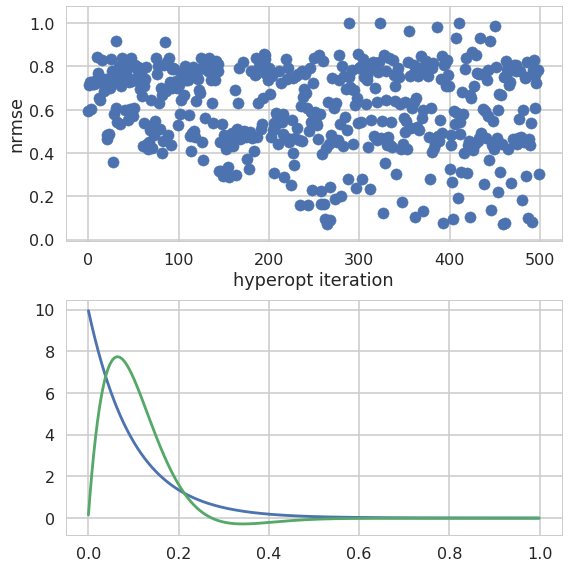

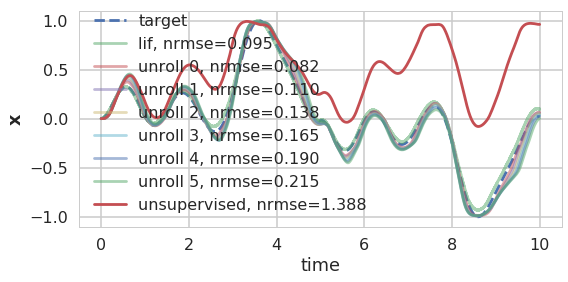

nrmse = 1.388
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

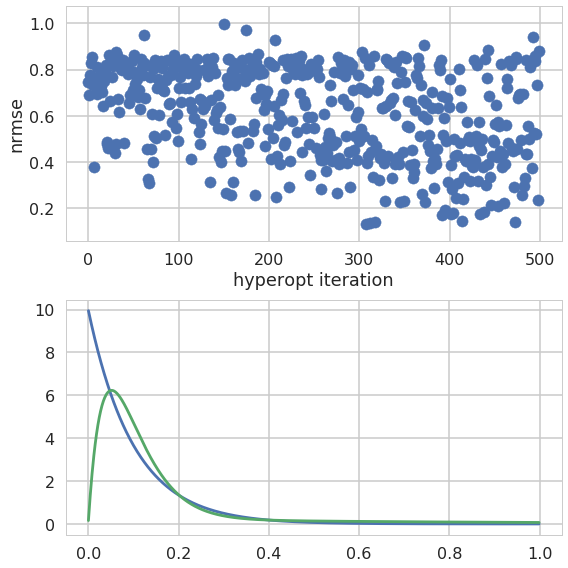

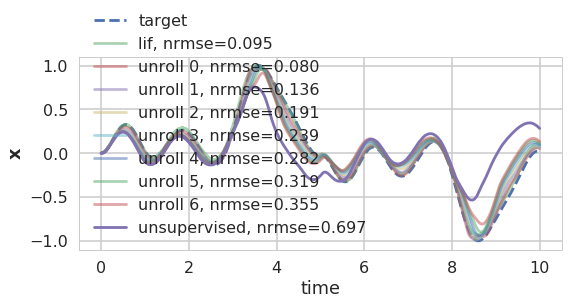

nrmse = 0.697


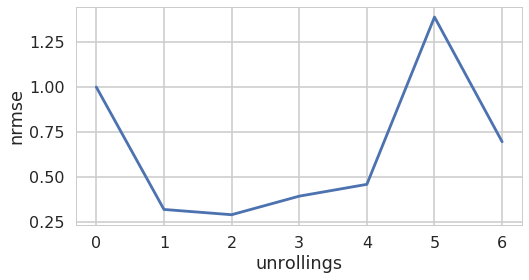

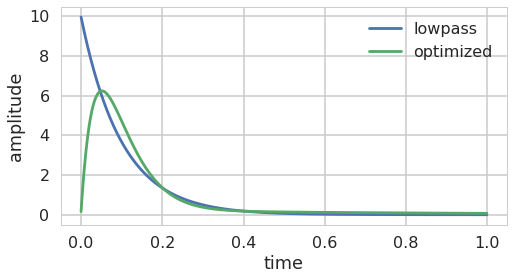

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

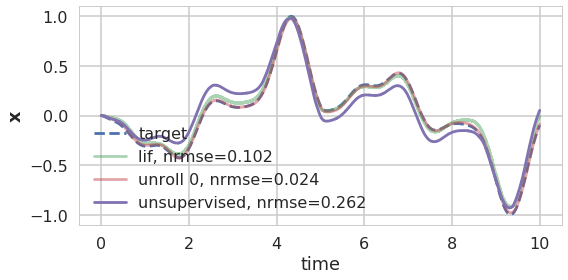

In [86]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=500)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

filter first

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

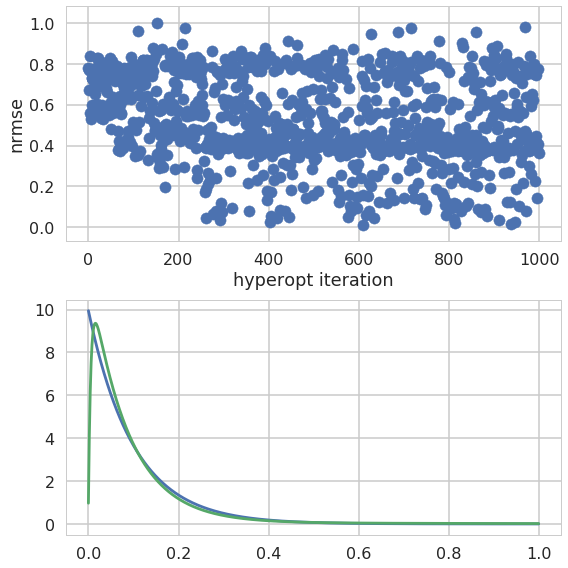

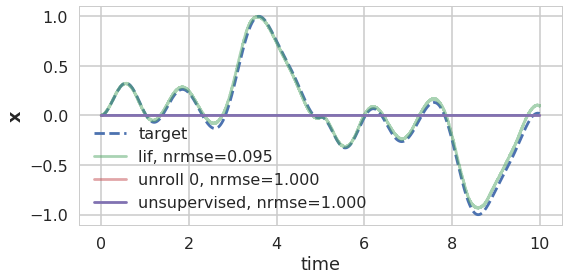

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

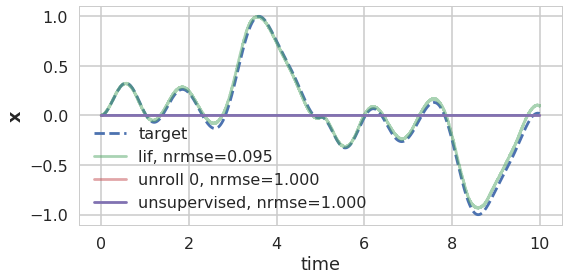

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

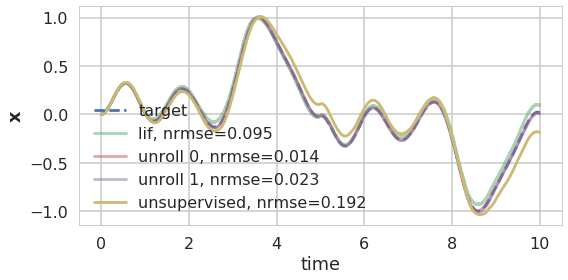

nrmse = 0.192
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

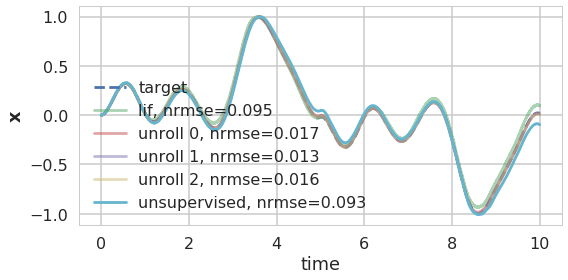

nrmse = 0.093
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

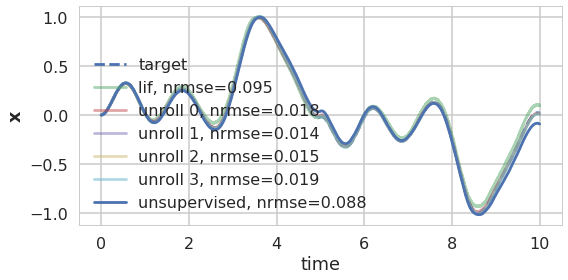

nrmse = 0.088
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

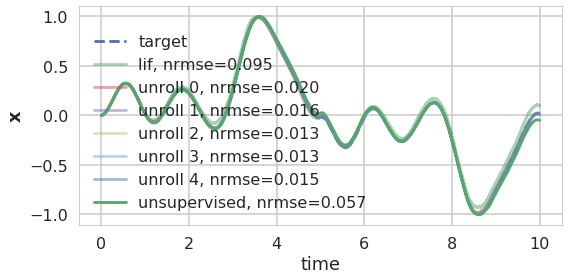

nrmse = 0.057
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

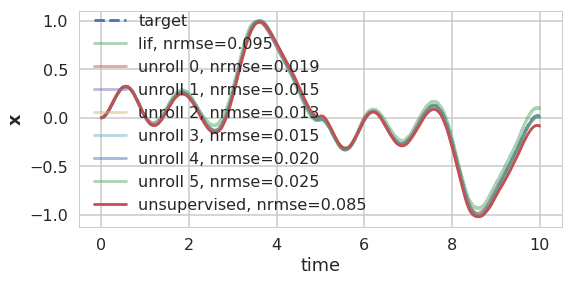

nrmse = 0.085
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

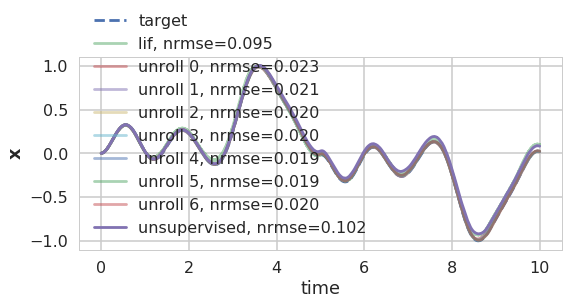

nrmse = 0.102


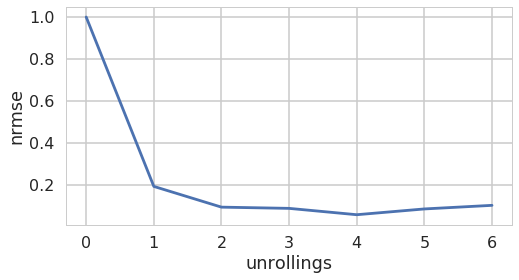

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

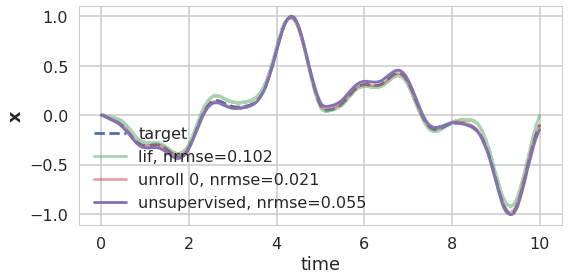

In [123]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

### JL dimensions and filter

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

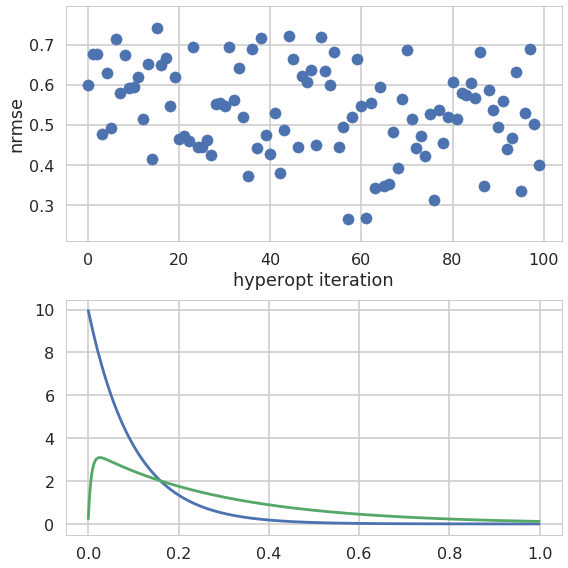

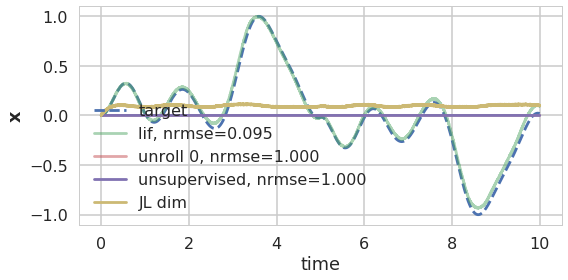

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

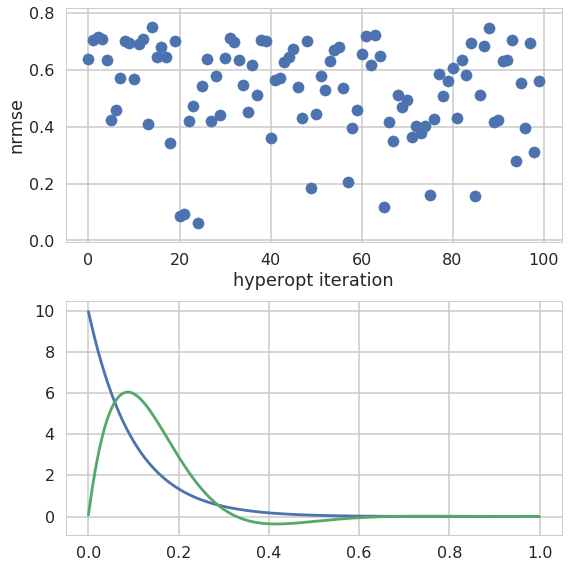

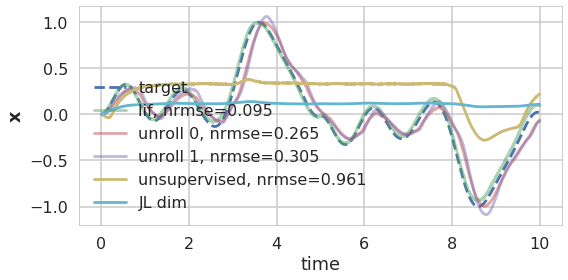

nrmse = 0.961
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

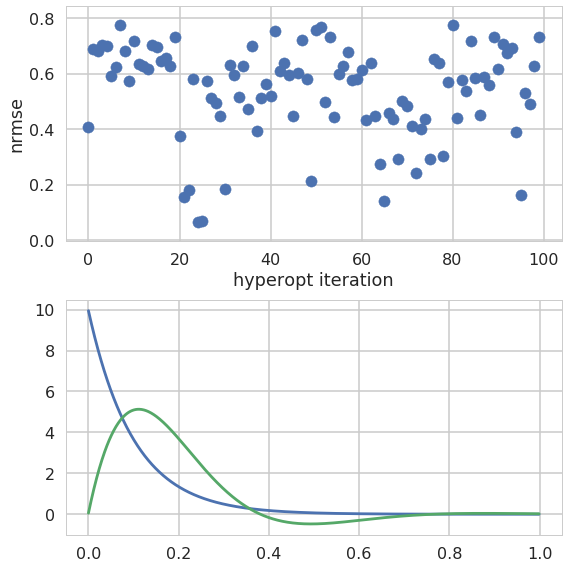

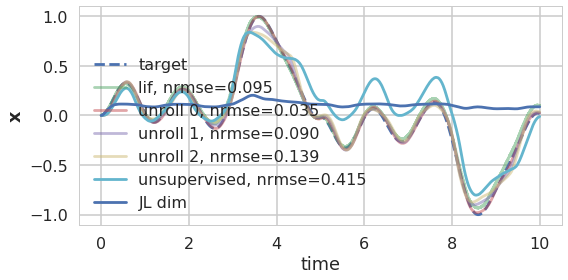

nrmse = 0.415
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

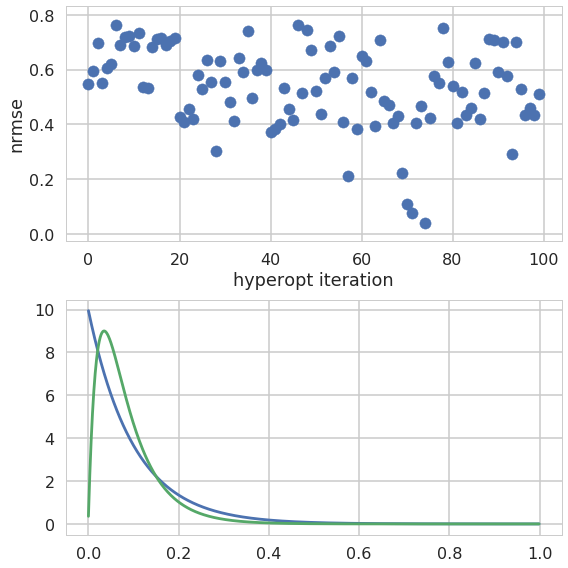

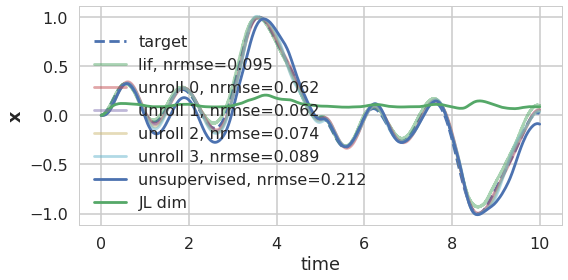

nrmse = 0.212
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

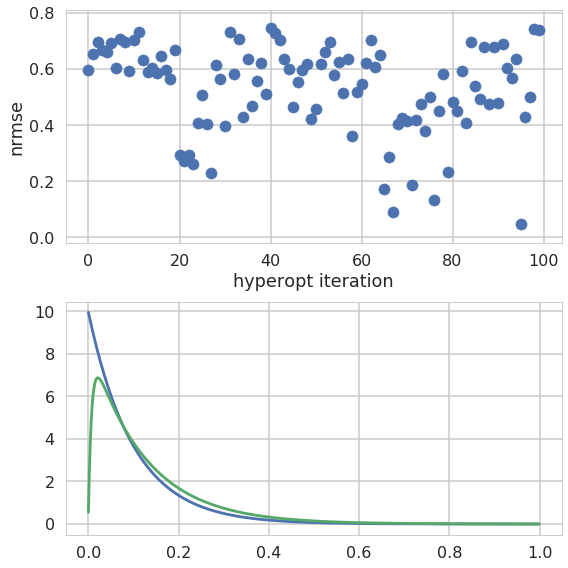

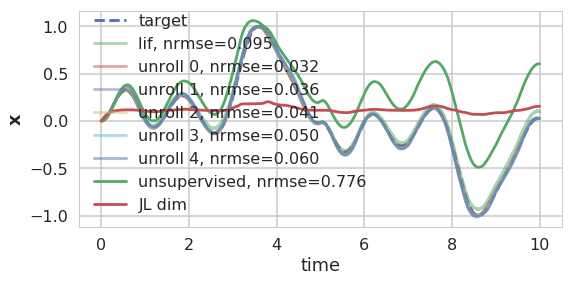

nrmse = 0.776
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

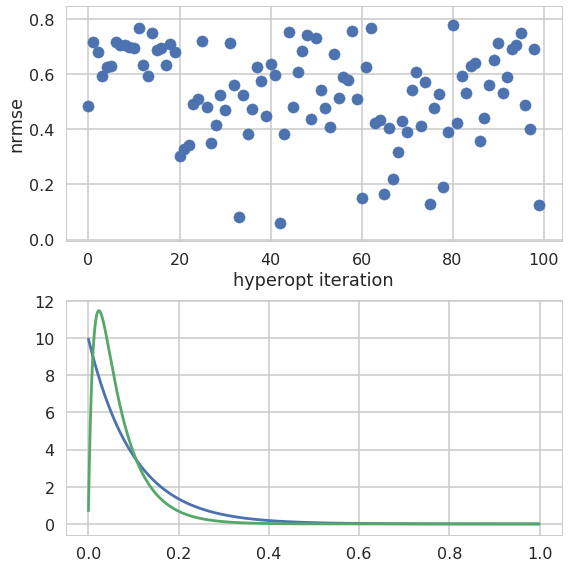

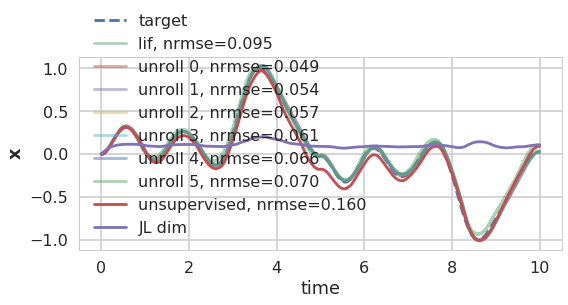

nrmse = 0.160
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

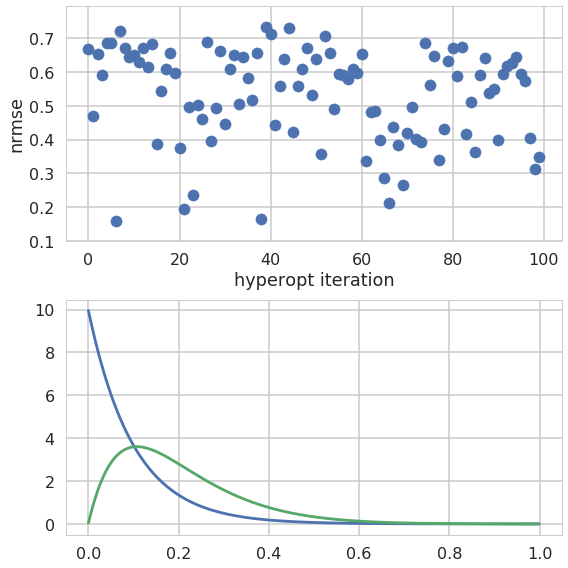

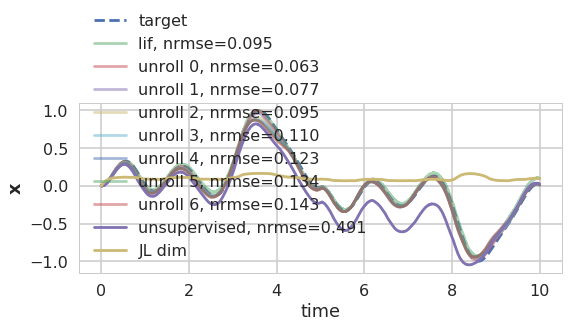

nrmse = 0.491


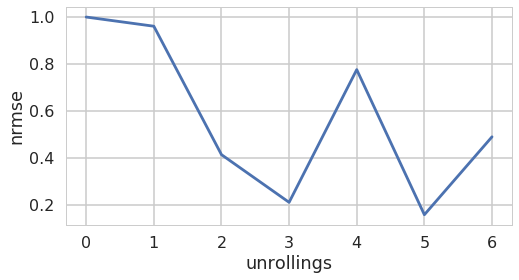

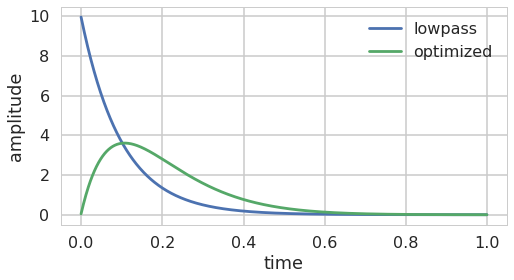

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

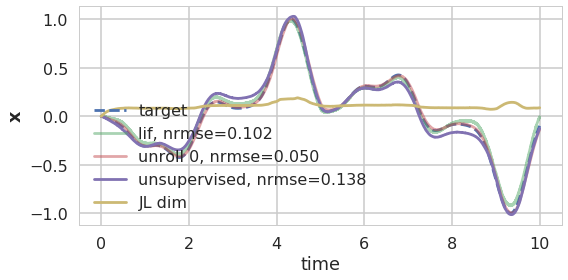

In [88]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=2,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

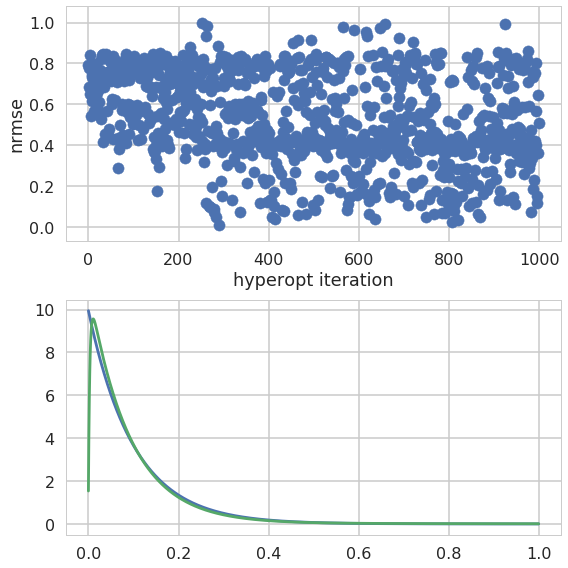

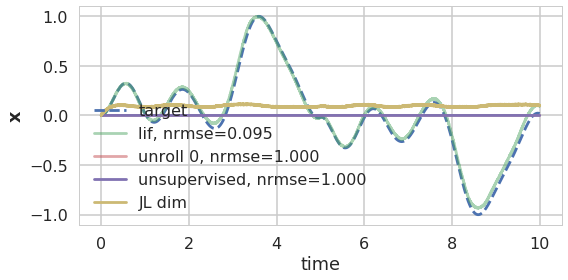

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

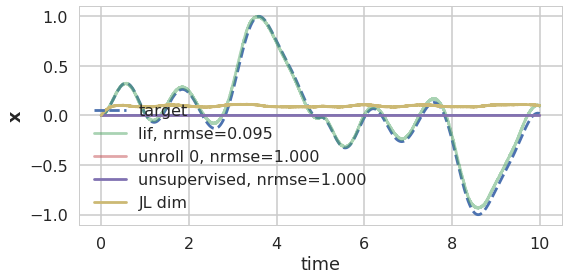

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

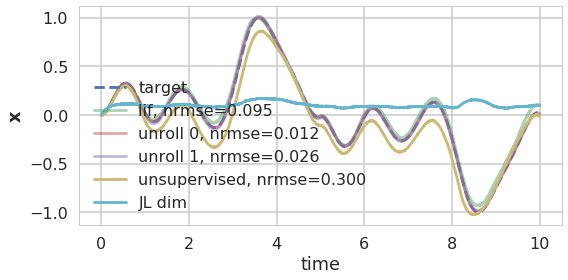

nrmse = 0.300
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

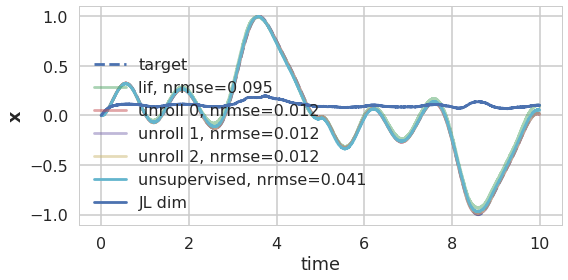

nrmse = 0.041
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

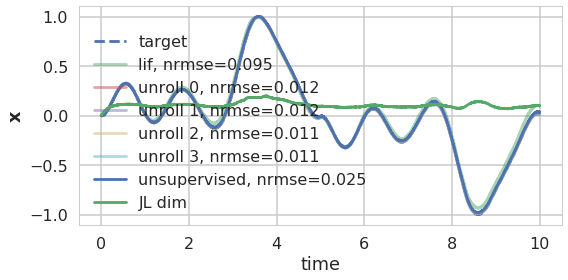

nrmse = 0.025
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

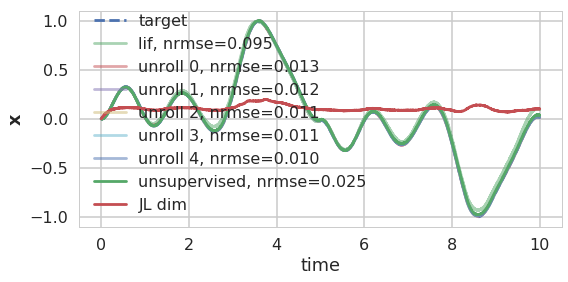

nrmse = 0.025
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

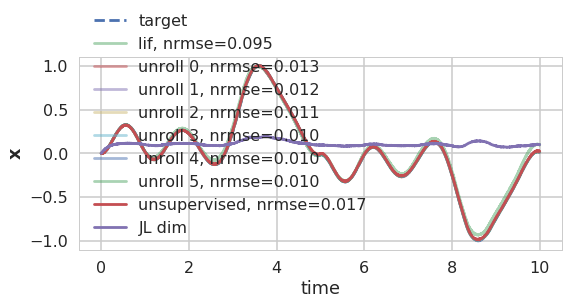

nrmse = 0.017
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

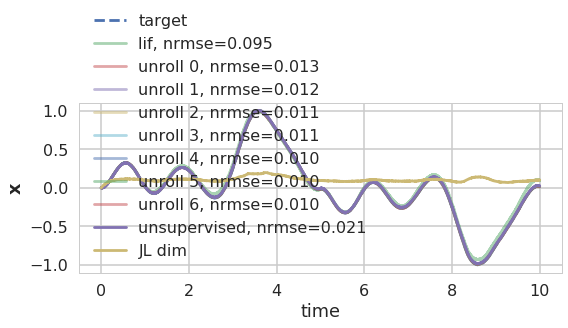

nrmse = 0.021


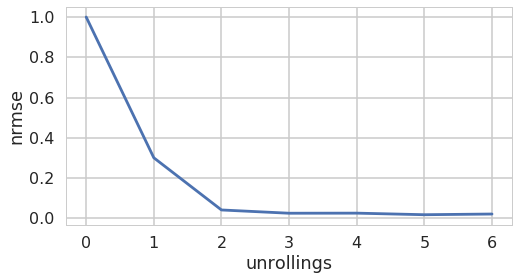

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

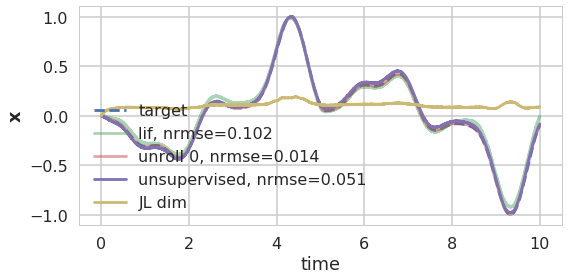

In [124]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

## ALIF

### baseline

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

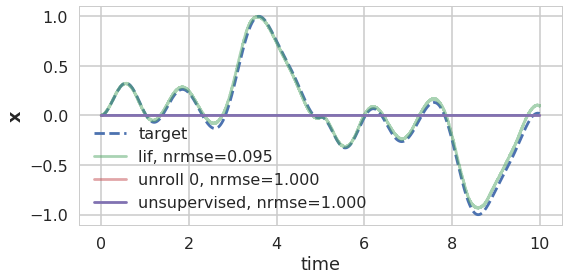

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

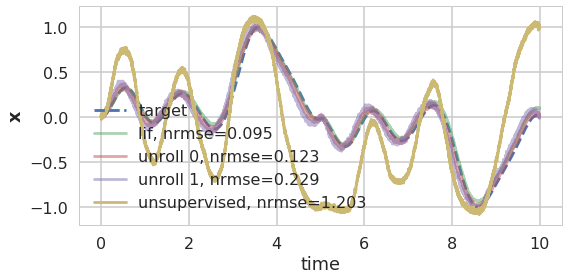

nrmse = 1.203
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

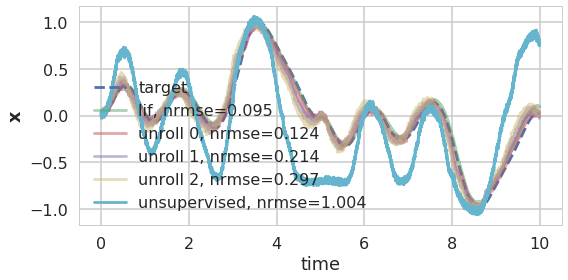

nrmse = 1.004
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

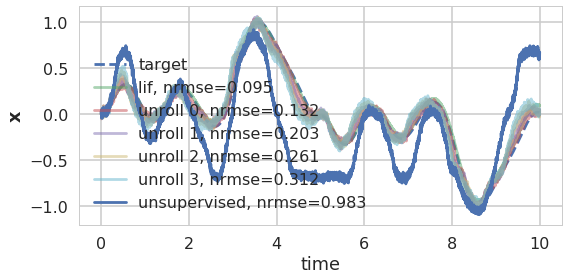

nrmse = 0.983
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

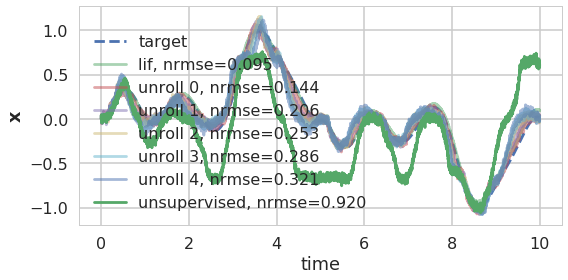

nrmse = 0.920
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

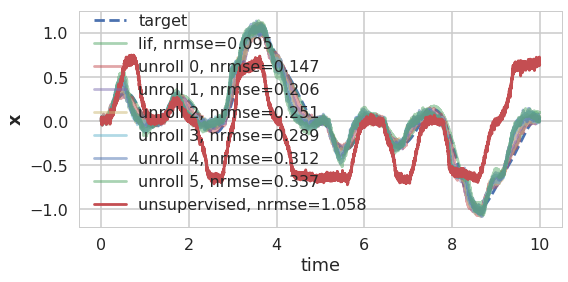

nrmse = 1.058
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

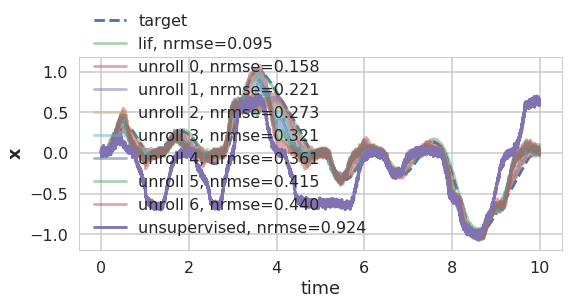

nrmse = 0.924


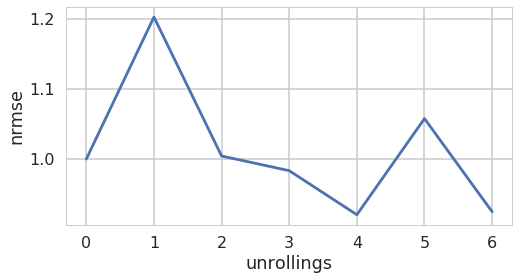

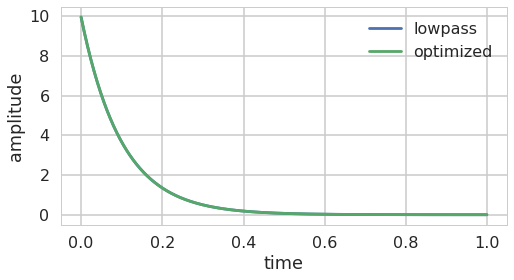

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

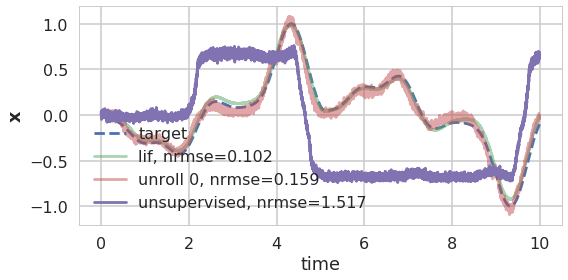

In [89]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

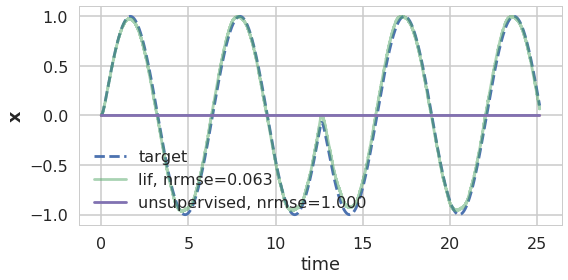

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

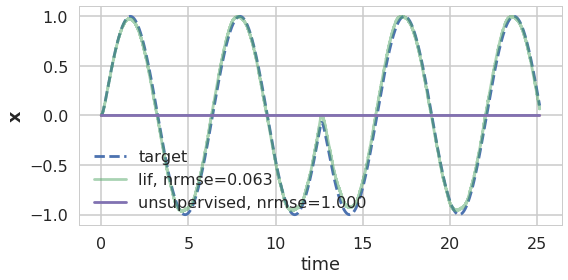

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

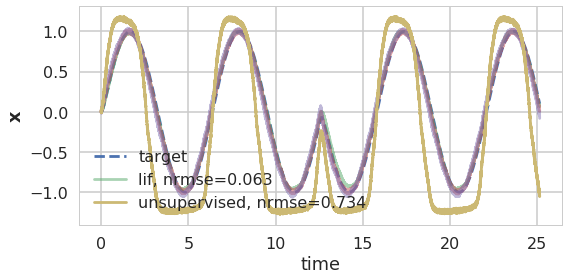

nrmse = 0.734
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

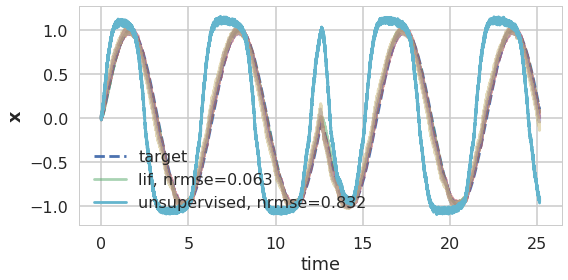

nrmse = 0.832
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

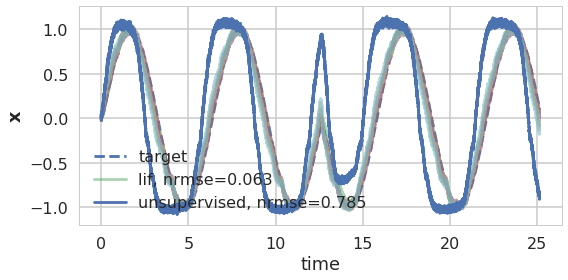

nrmse = 0.785
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

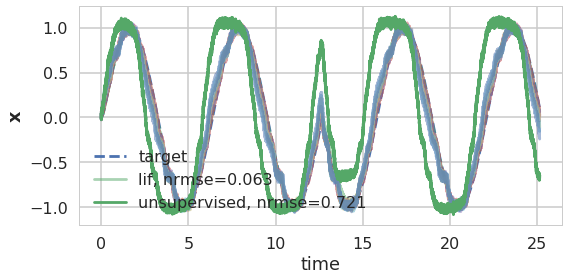

nrmse = 0.721
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

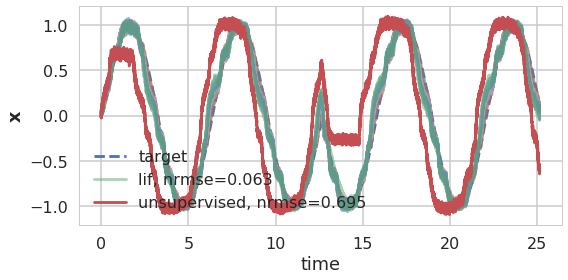

nrmse = 0.695
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

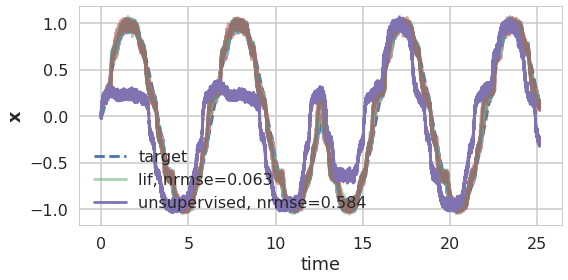

nrmse = 0.584
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

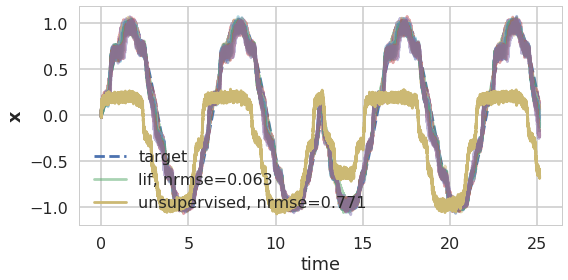

nrmse = 0.771
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

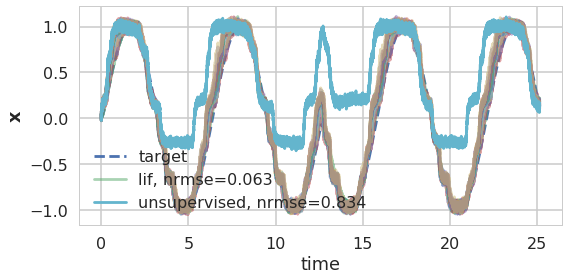

nrmse = 0.834
unrolling #9


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

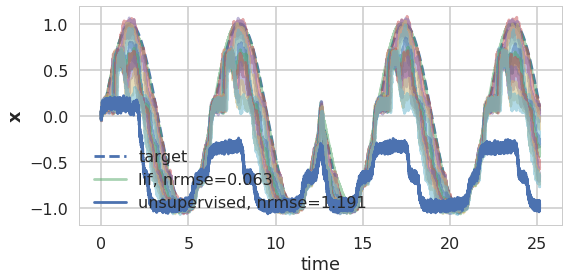

nrmse = 1.191
unrolling #10


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

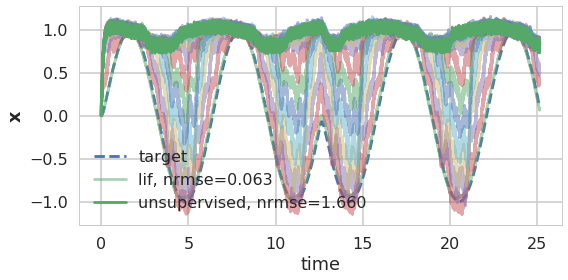

nrmse = 1.660


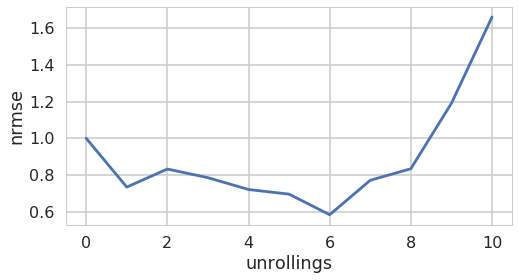

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

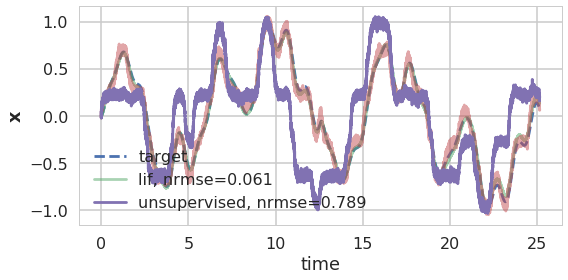

In [162]:
kwargs = dict(
    t=8*np.pi,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=10, signal='cos', optimize=False, plot=True, **kwargs)

### regularization

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

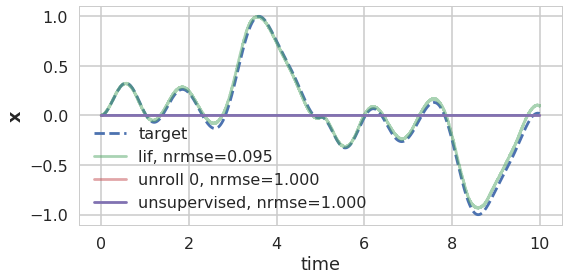

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

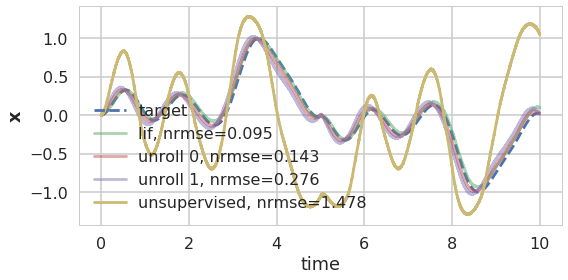

nrmse = 1.478
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

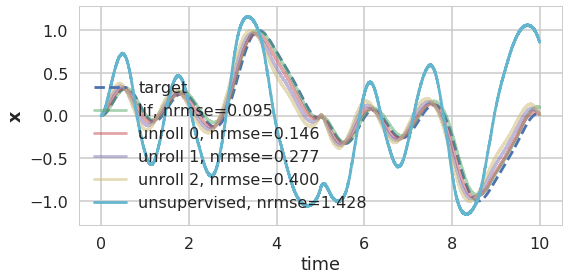

nrmse = 1.428
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

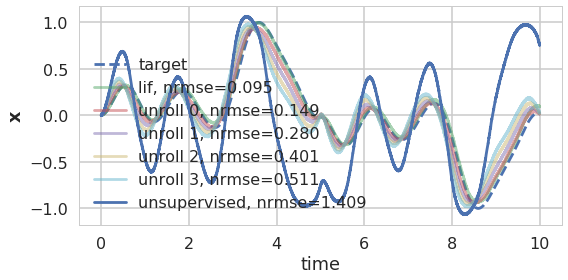

nrmse = 1.409
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

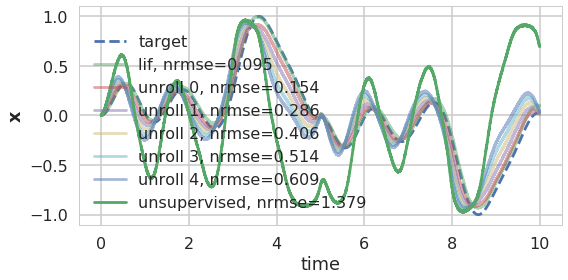

nrmse = 1.379
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

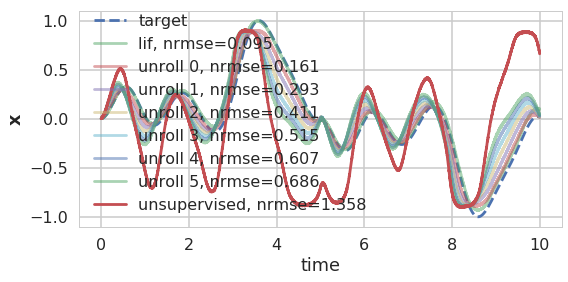

nrmse = 1.358
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

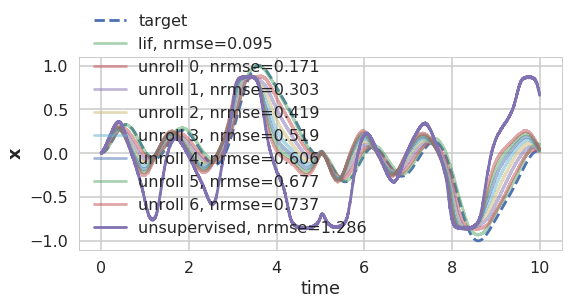

nrmse = 1.286


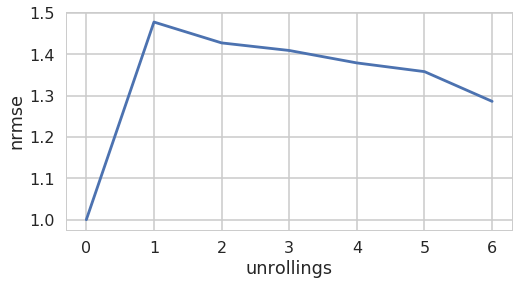

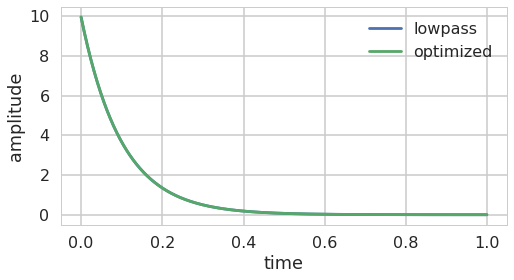

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

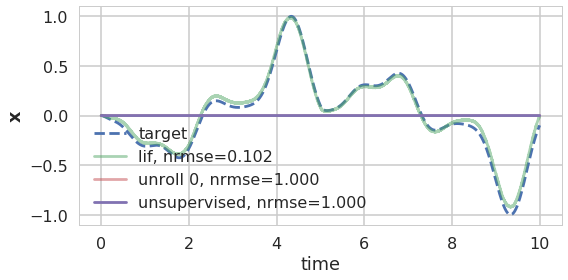

In [90]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.1,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

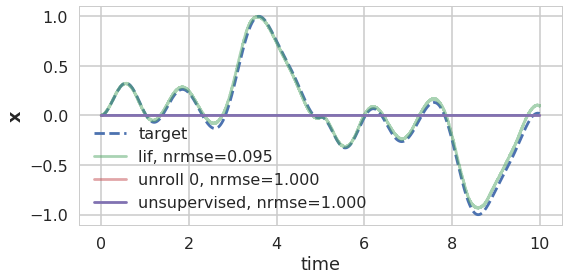

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

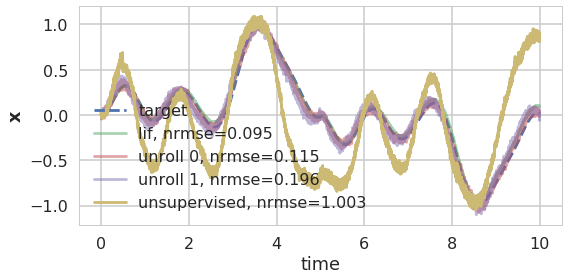

nrmse = 1.003
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

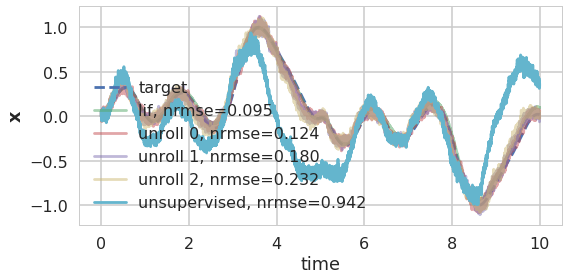

nrmse = 0.942
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

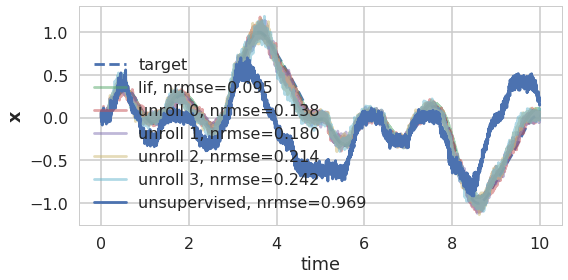

nrmse = 0.969
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

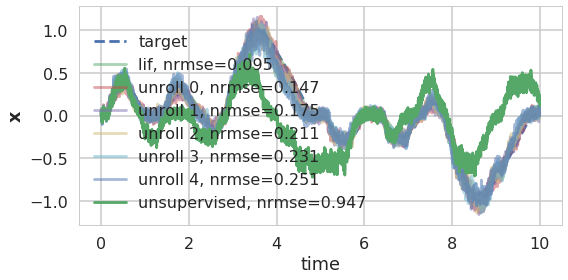

nrmse = 0.947
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

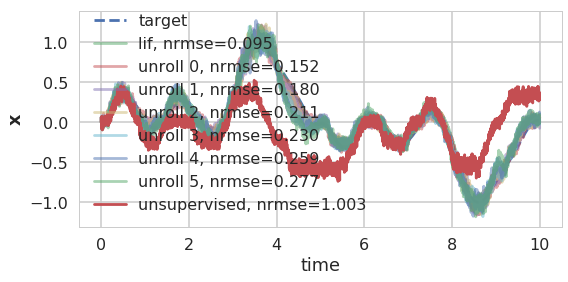

nrmse = 1.003
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

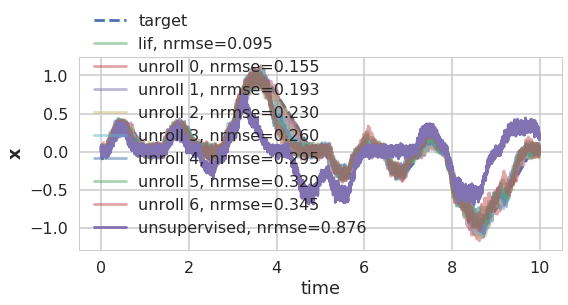

nrmse = 0.876


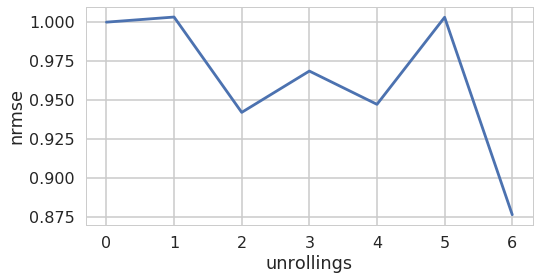

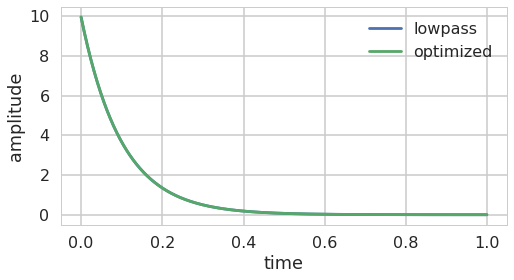

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

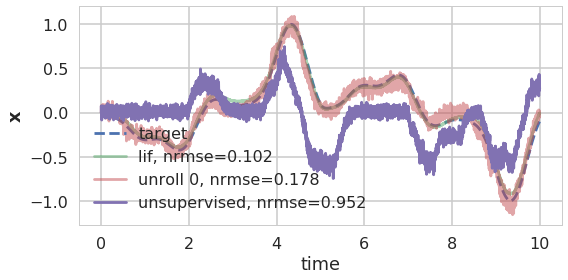

In [91]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.001,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

### JL dims

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

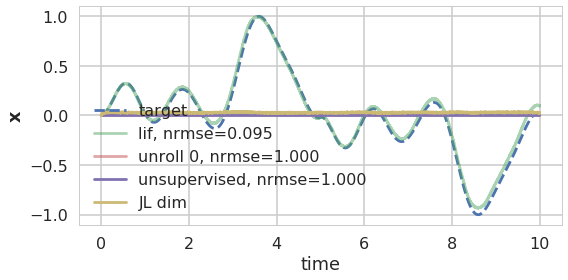

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

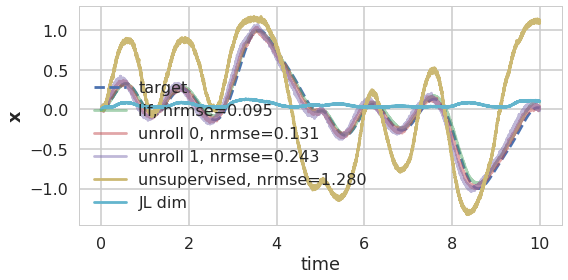

nrmse = 1.280
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

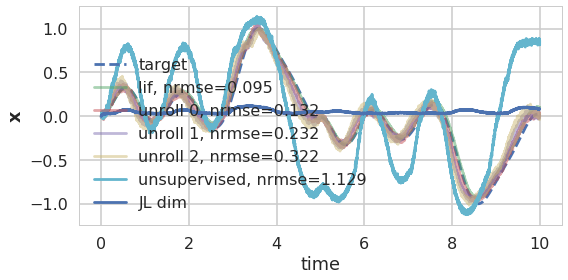

nrmse = 1.129
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

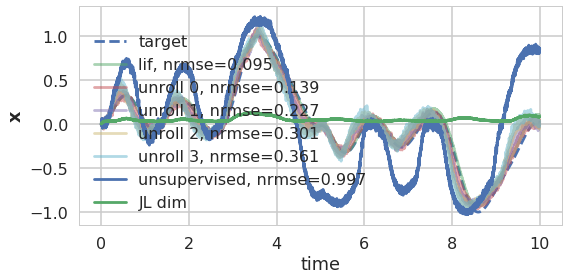

nrmse = 0.997
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

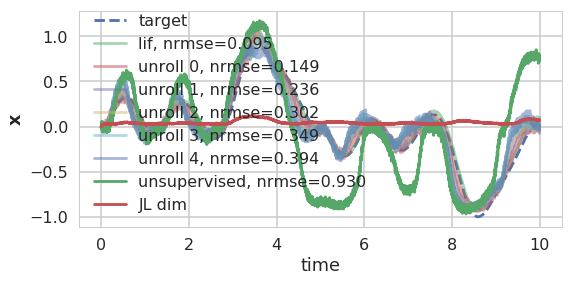

nrmse = 0.930
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

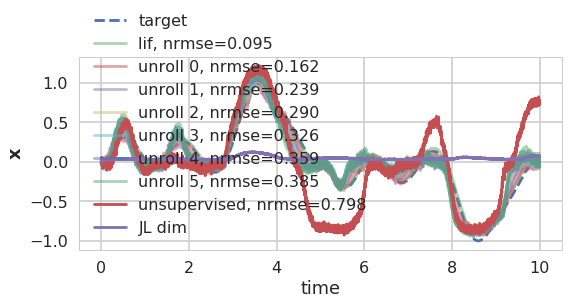

nrmse = 0.798
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

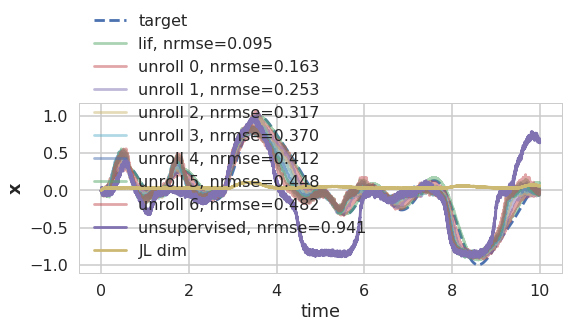

nrmse = 0.941


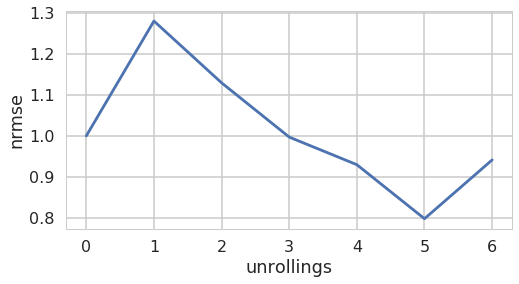

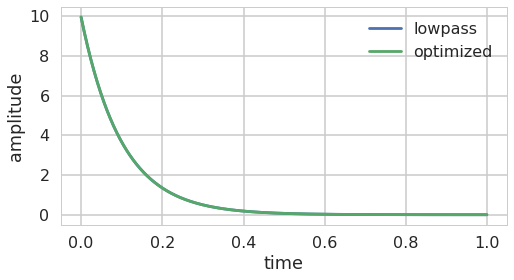

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

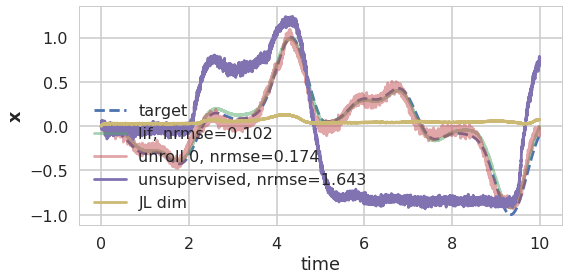

In [92]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

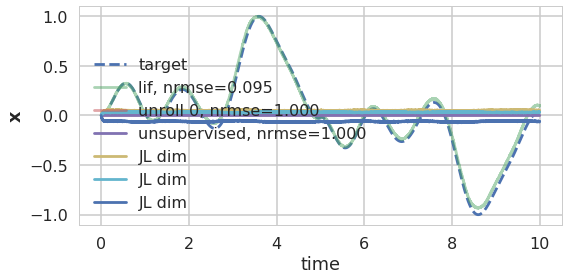

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

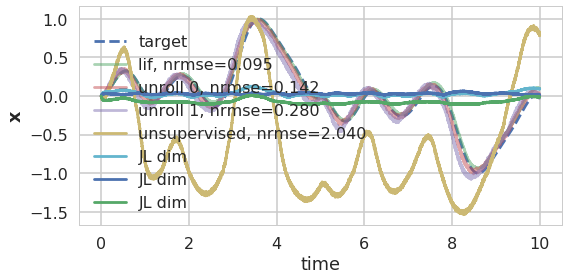

nrmse = 2.040
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

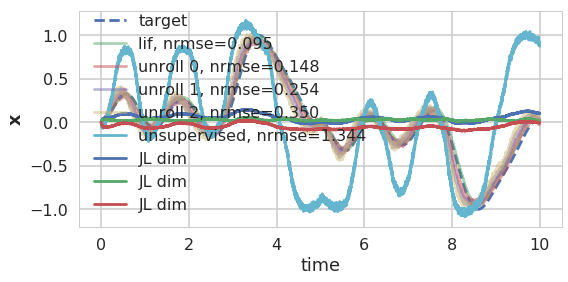

nrmse = 1.344
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

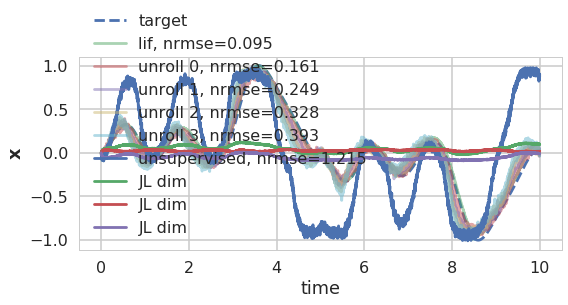

nrmse = 1.215
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

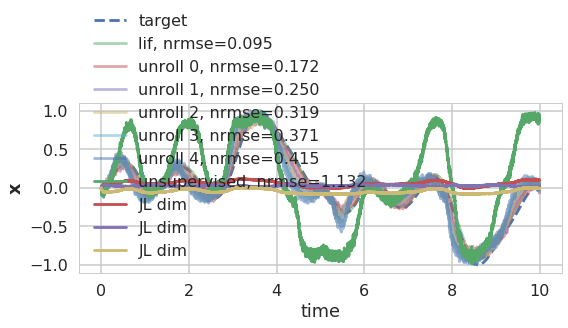

nrmse = 1.132
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

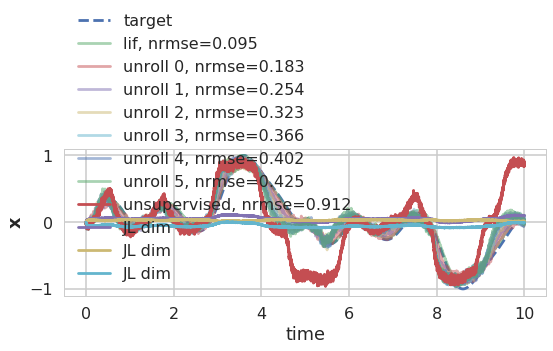

nrmse = 0.912
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

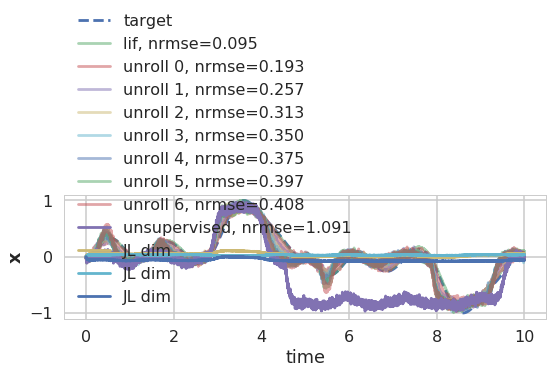

nrmse = 1.091


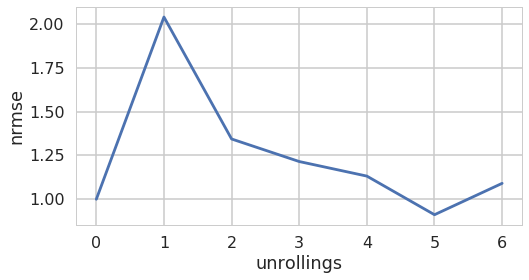

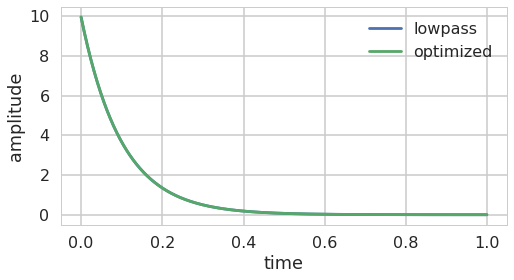

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

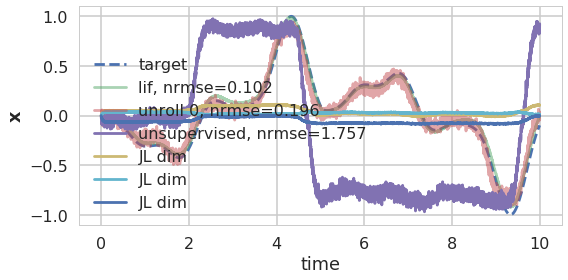

In [93]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

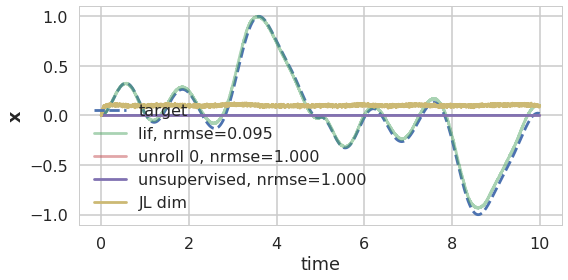

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

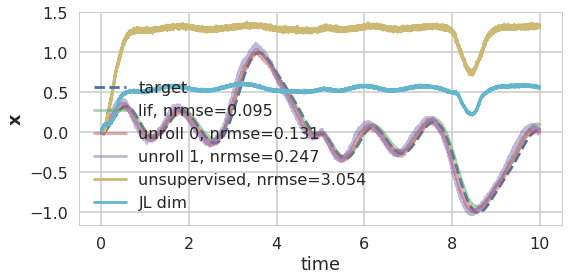

nrmse = 3.054
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

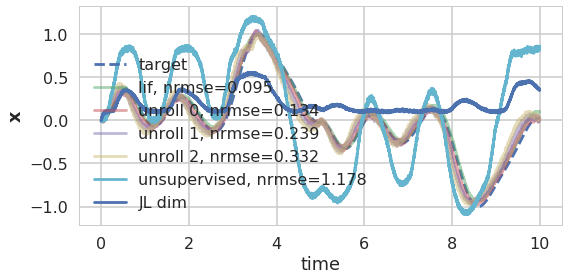

nrmse = 1.178
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

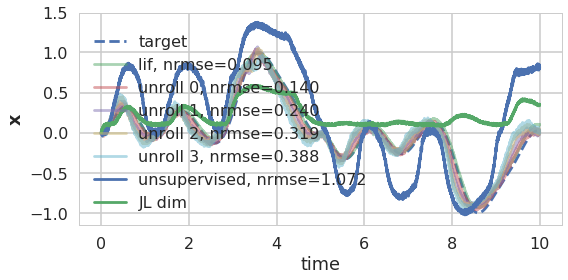

nrmse = 1.072
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

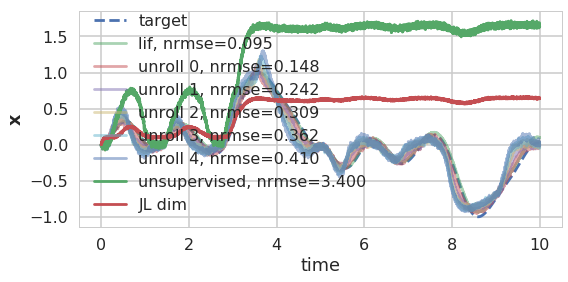

nrmse = 3.400
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

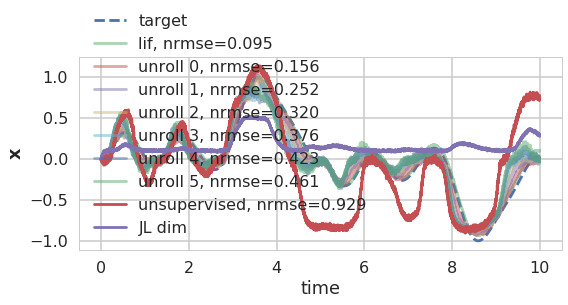

nrmse = 0.929
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

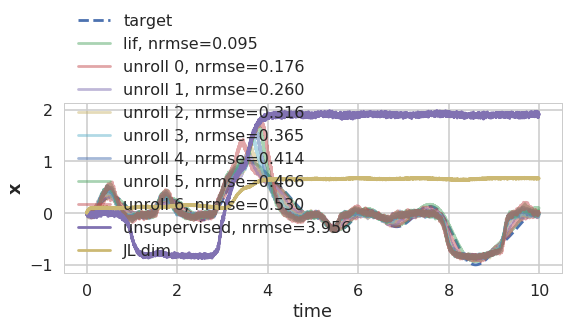

nrmse = 3.956


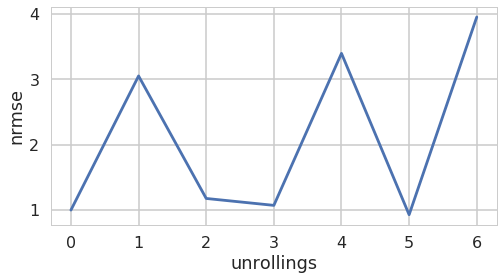

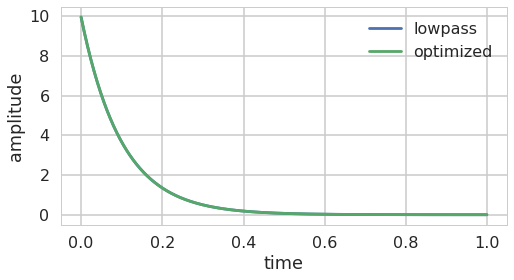

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

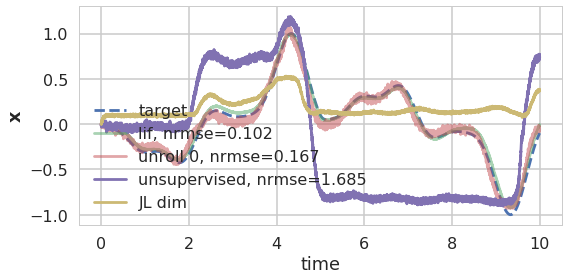

In [94]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=3e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

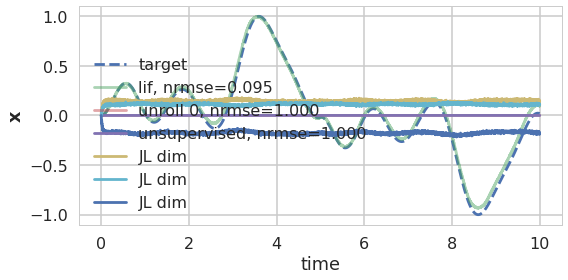

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

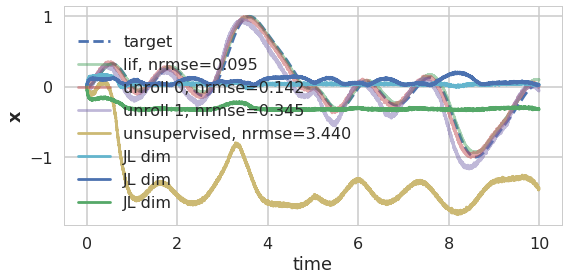

nrmse = 3.440
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

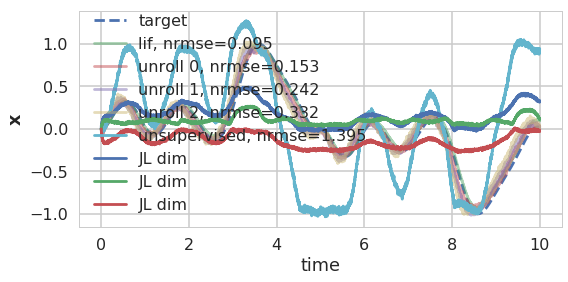

nrmse = 1.395
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

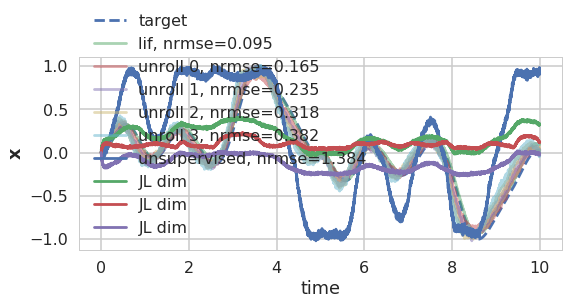

nrmse = 1.384
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

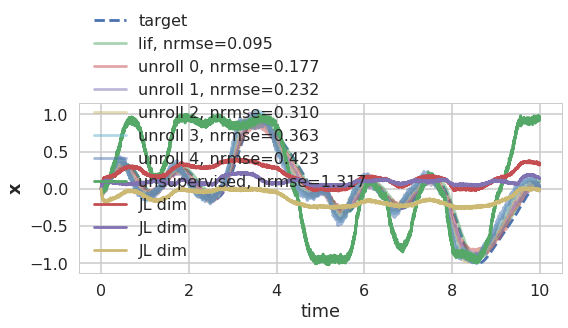

nrmse = 1.317
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

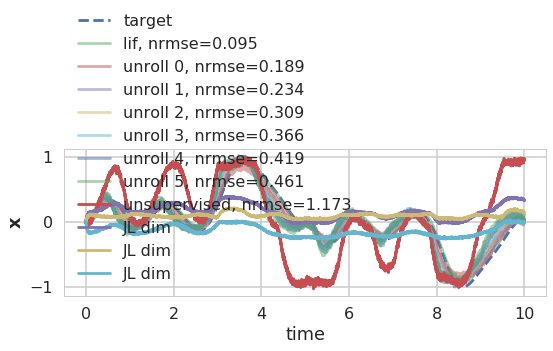

nrmse = 1.173
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

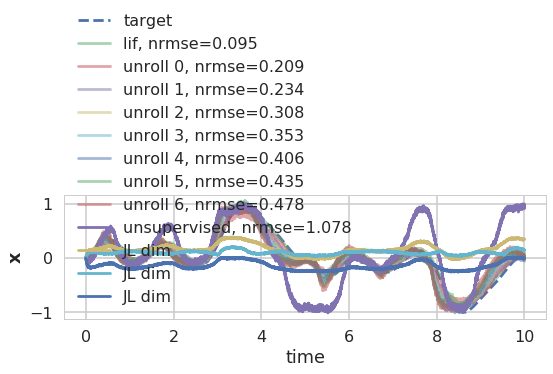

nrmse = 1.078


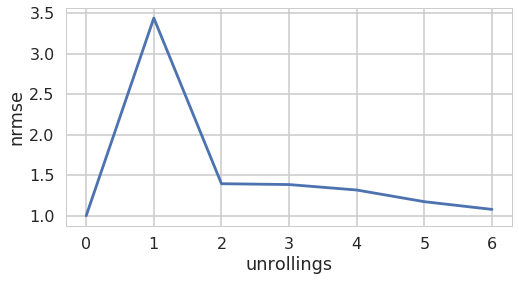

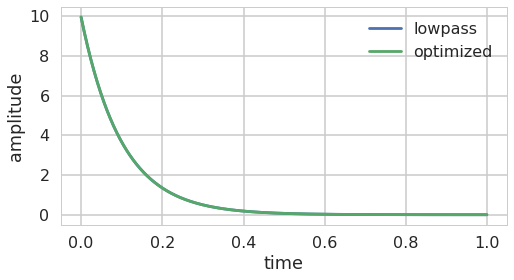

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

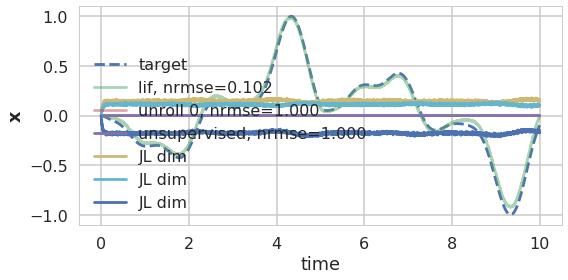

In [95]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=3e-4,
    reg=0.01,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

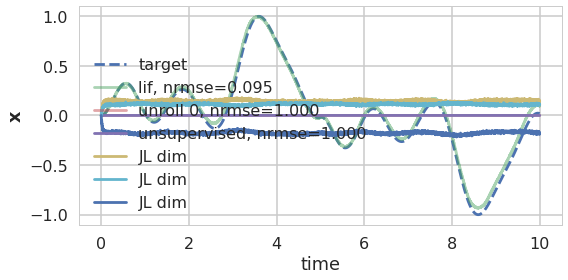

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

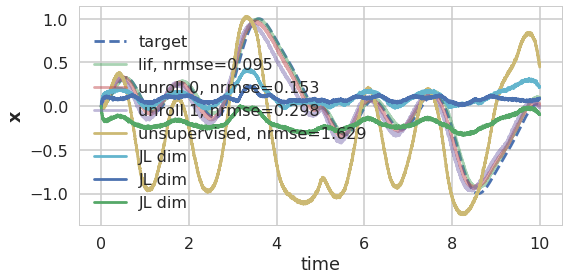

nrmse = 1.629
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

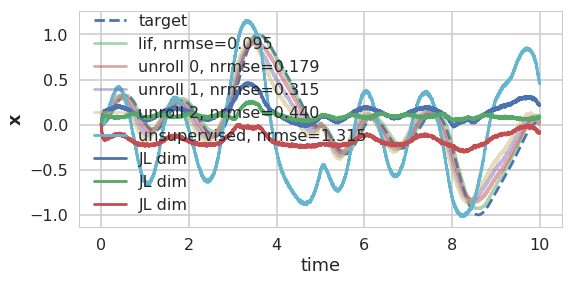

nrmse = 1.315
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

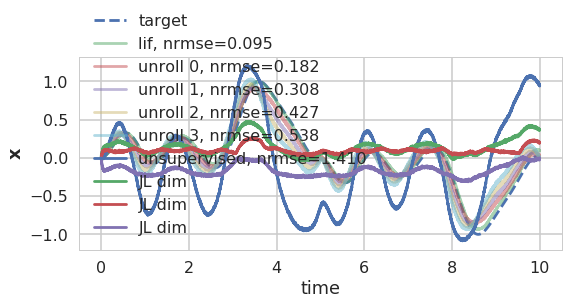

nrmse = 1.410
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

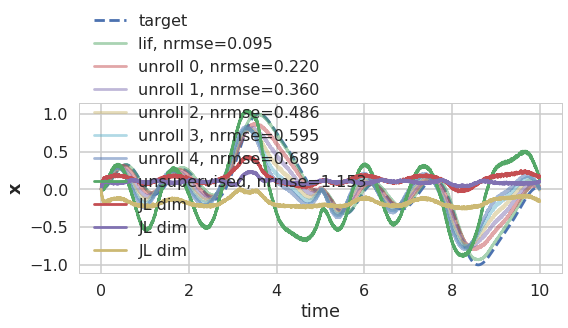

nrmse = 1.153
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

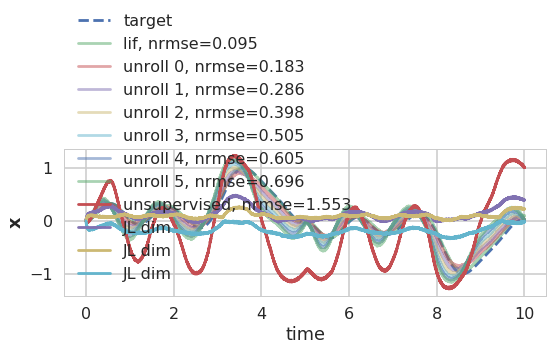

nrmse = 1.553
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

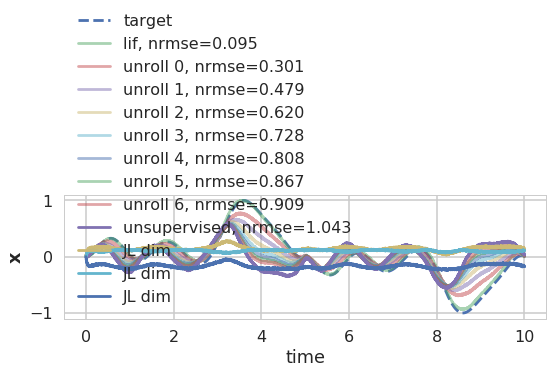

nrmse = 1.043


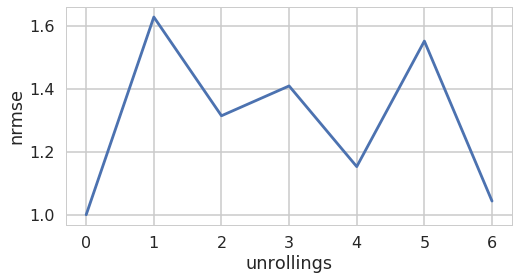

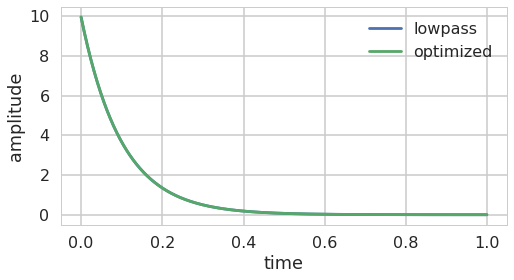

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

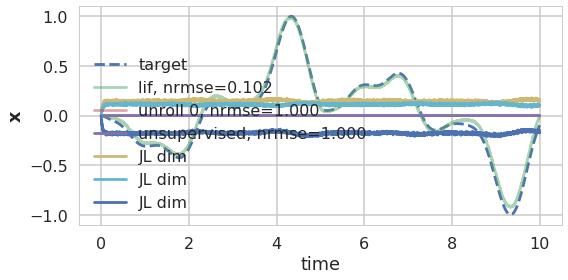

In [96]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=3e-4,
    reg=0.1,
    n_zeros=0, 
    n_poles=1,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=100)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=False, plot=True, **kwargs)

### optimized filter

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

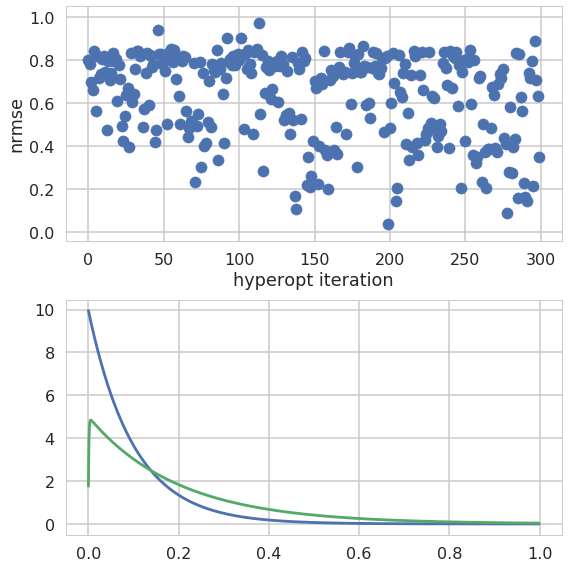

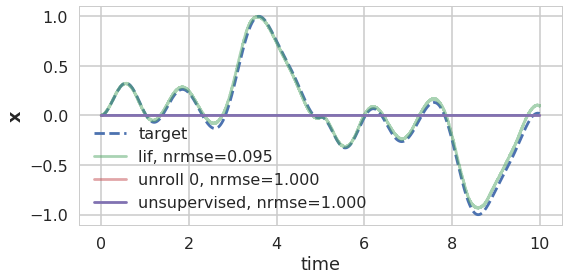

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

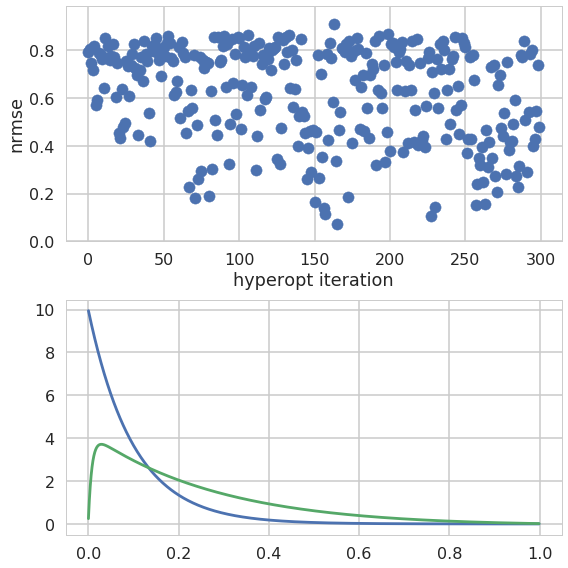

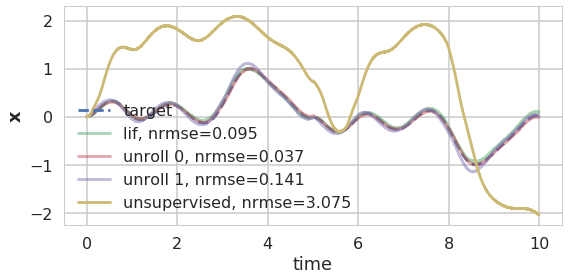

nrmse = 3.075
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

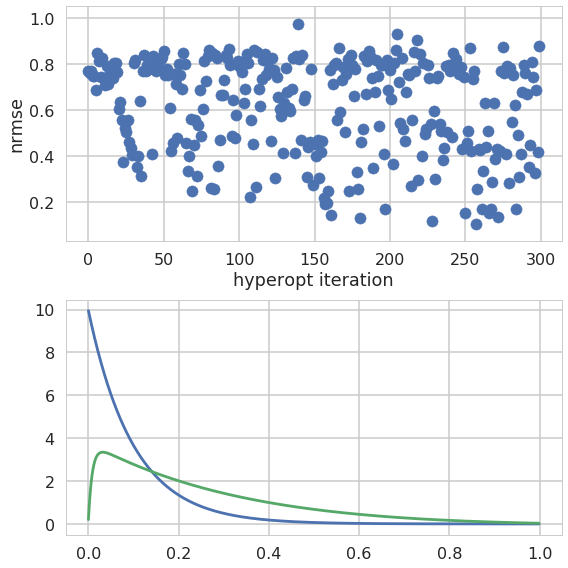

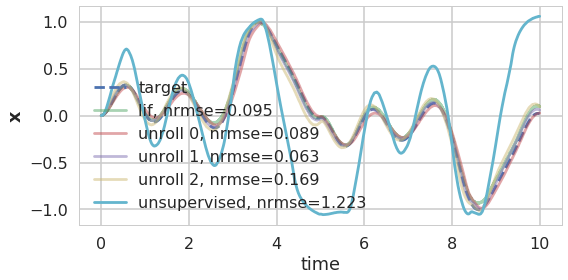

nrmse = 1.223
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

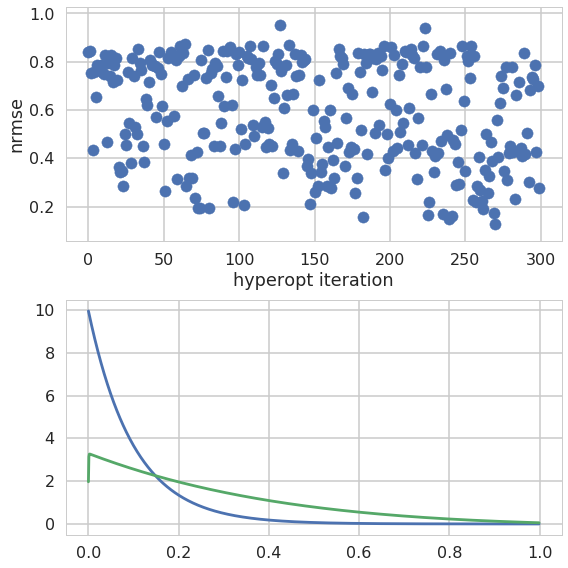

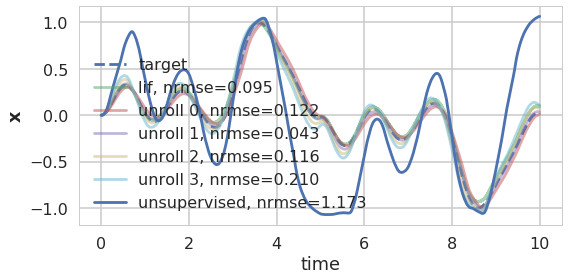

nrmse = 1.173
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

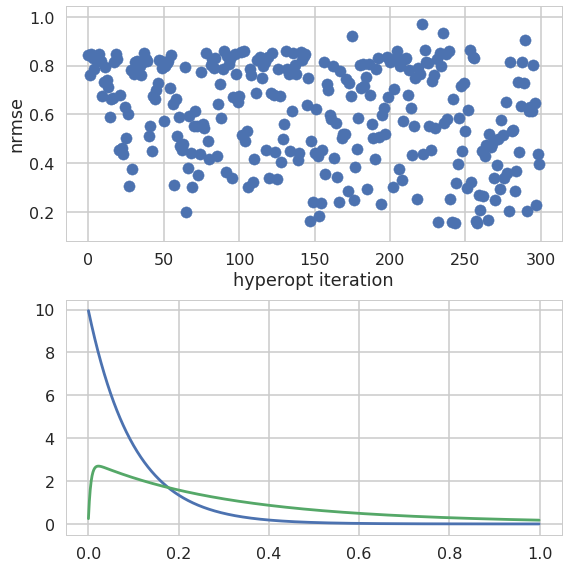

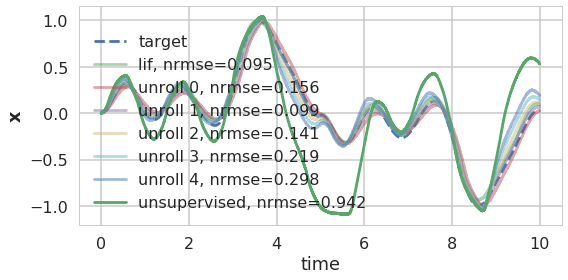

nrmse = 0.942
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

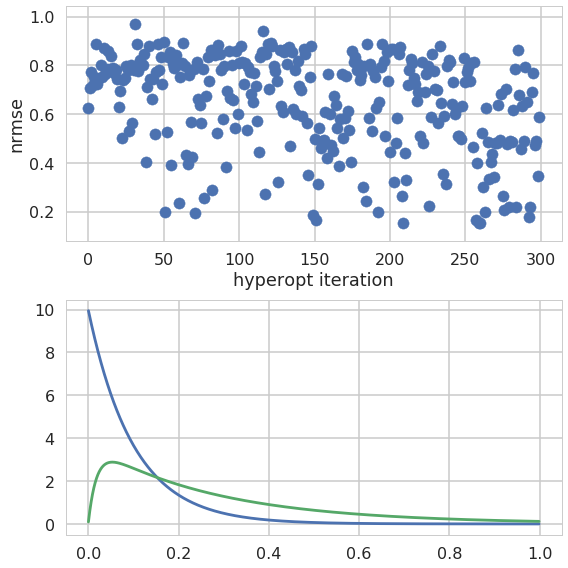

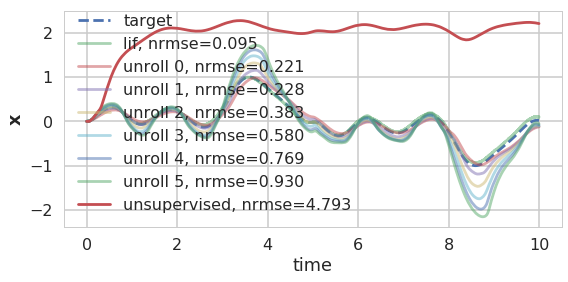

nrmse = 4.793
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

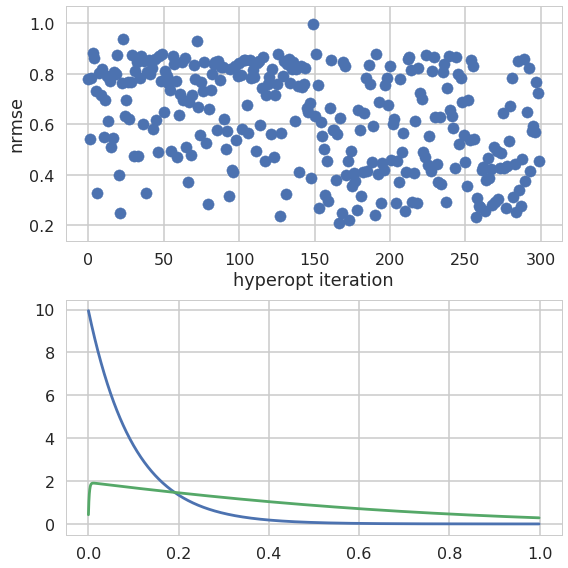

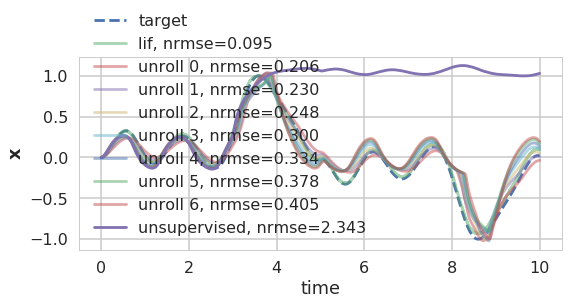

nrmse = 2.343


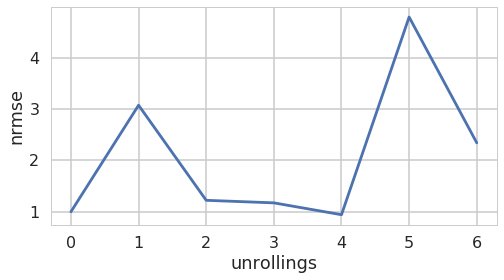

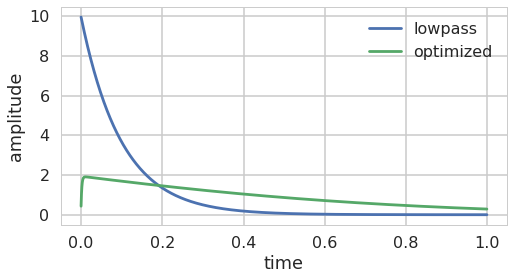

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

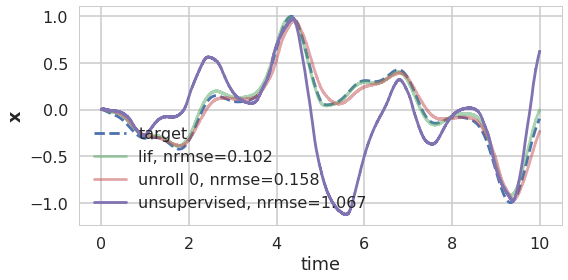

In [97]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=300)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

unrolling #0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

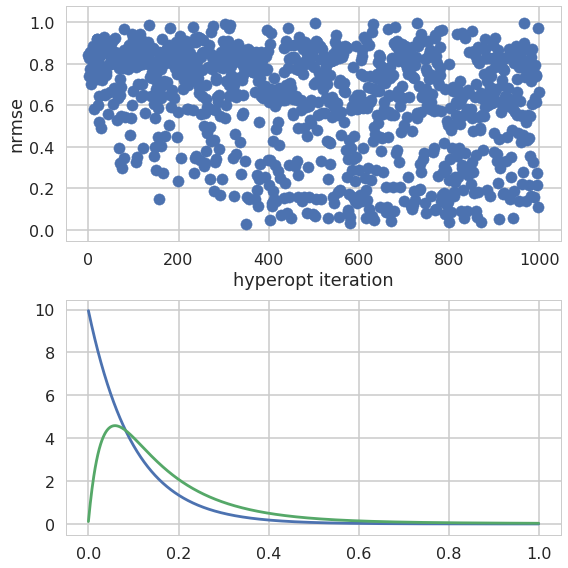

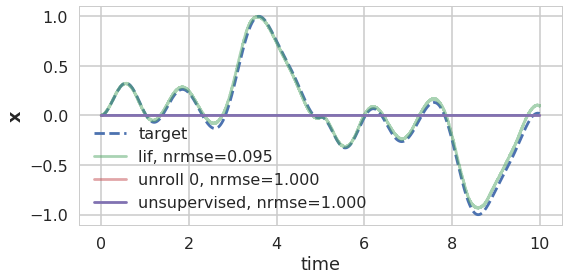

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

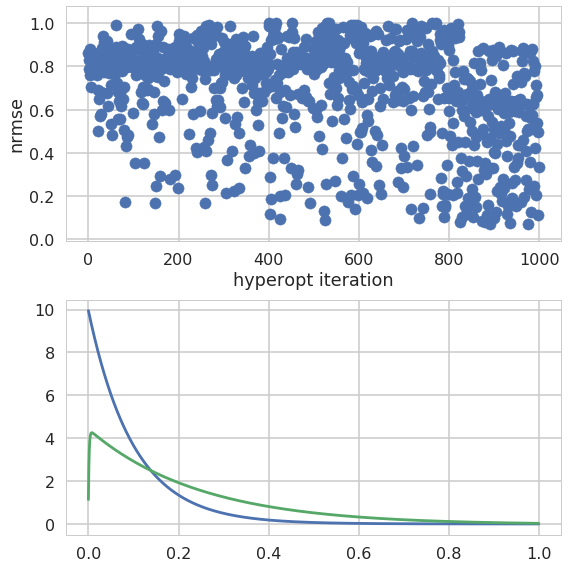

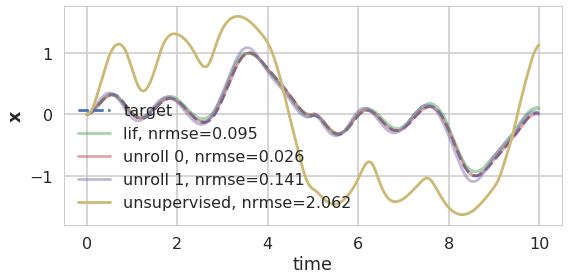

nrmse = 2.062
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

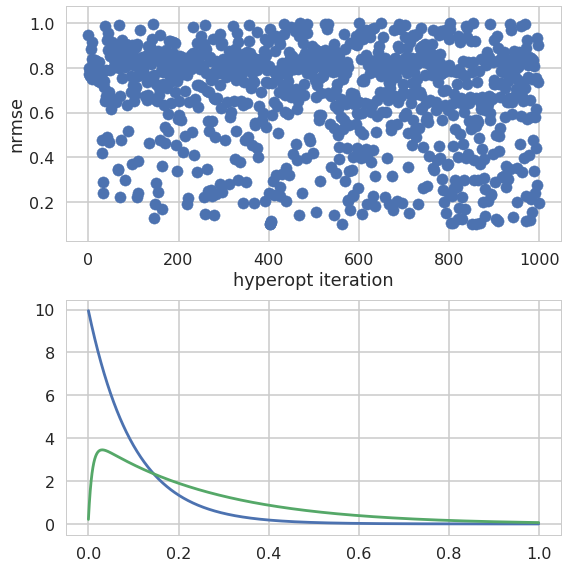

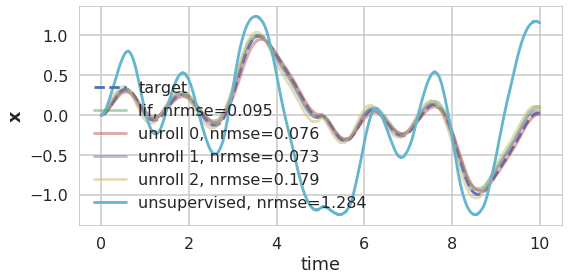

nrmse = 1.284
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

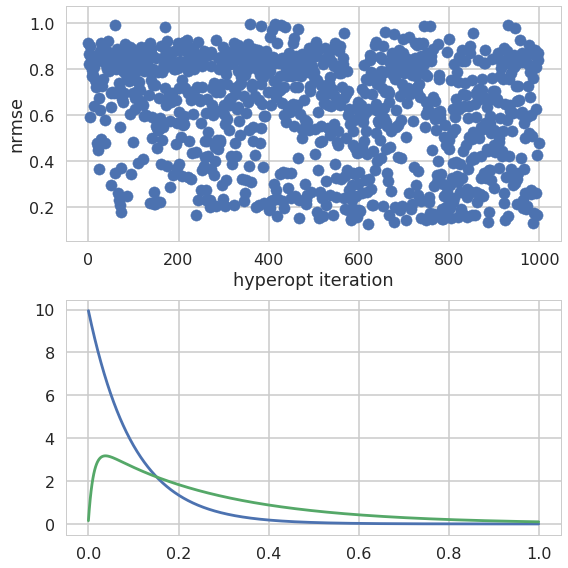

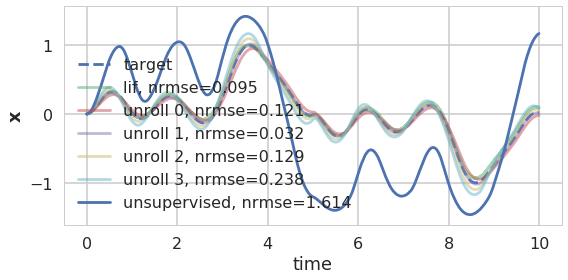

nrmse = 1.614
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

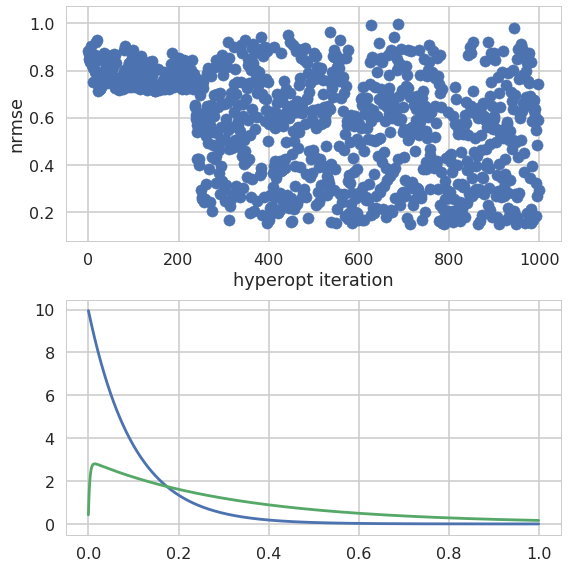

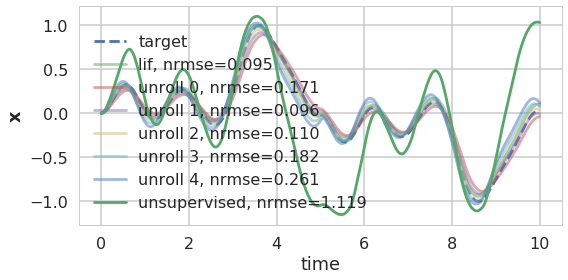

nrmse = 1.119
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

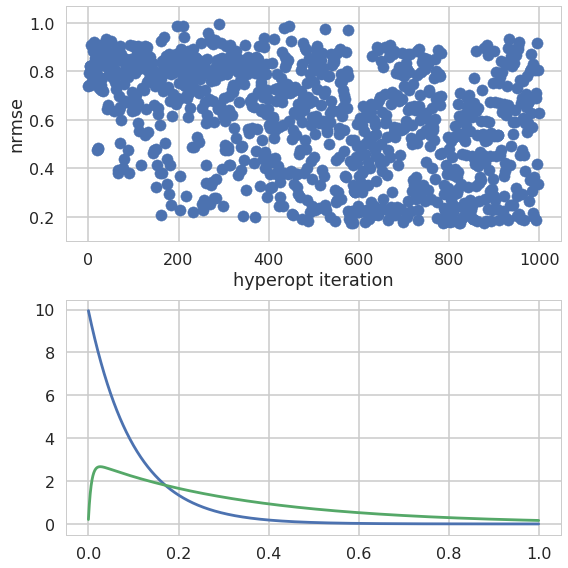

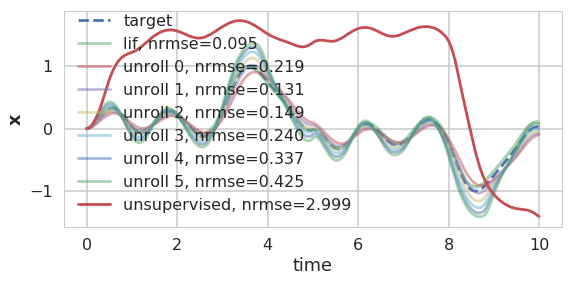

nrmse = 2.999
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

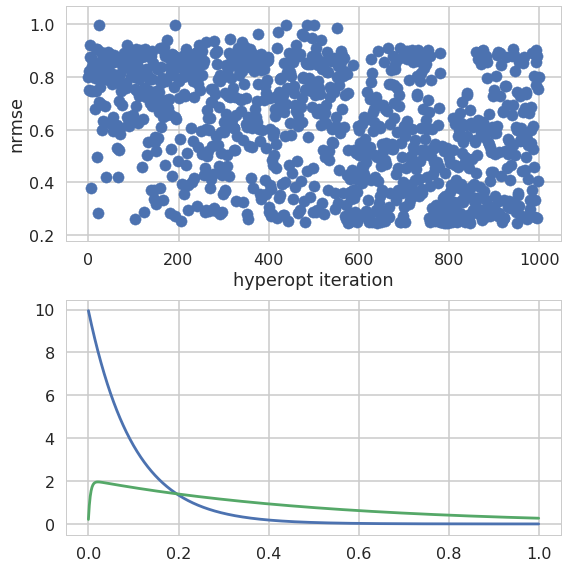

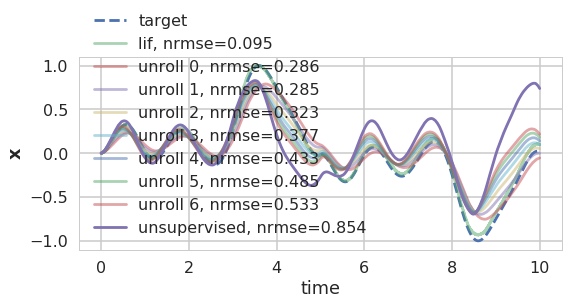

nrmse = 0.854


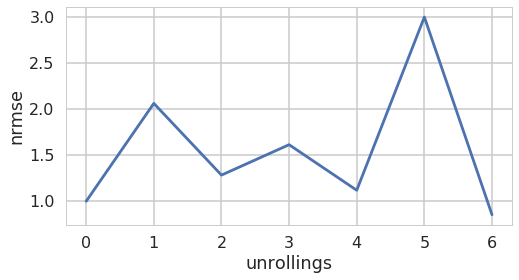

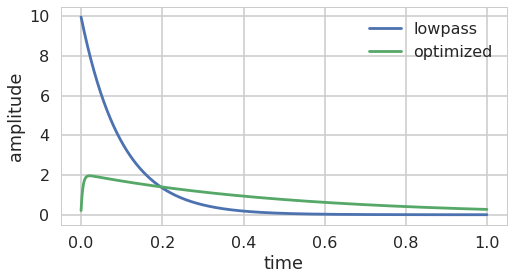

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

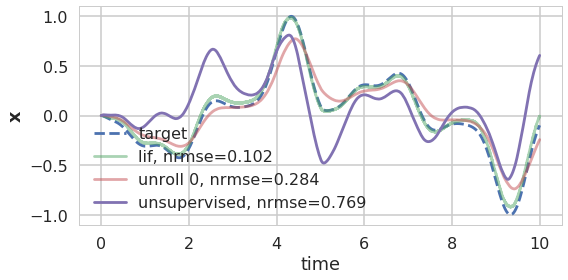

In [98]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.1,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = unroll_best(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

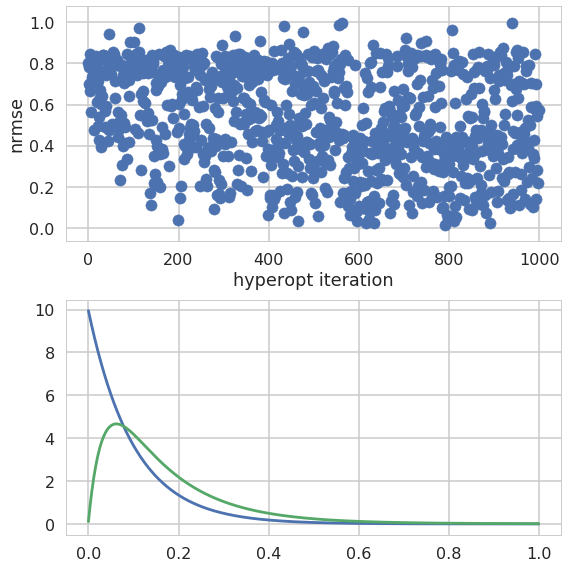

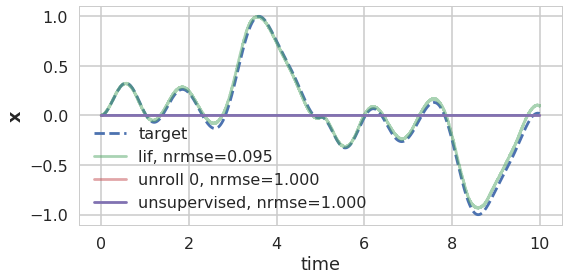

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

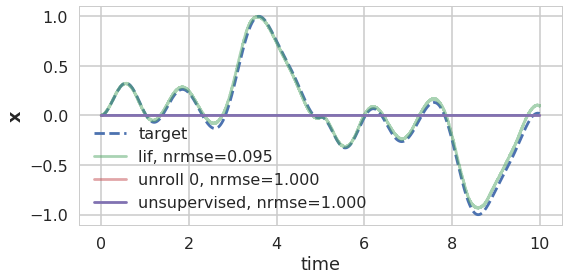

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

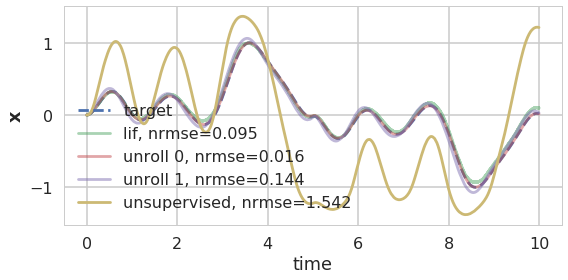

nrmse = 1.542
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

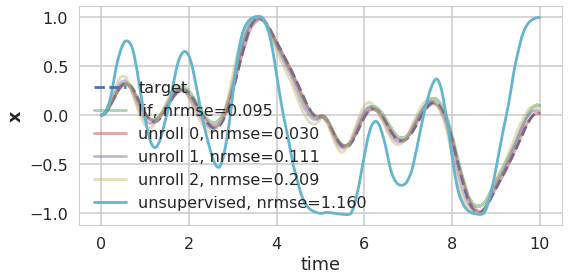

nrmse = 1.160
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

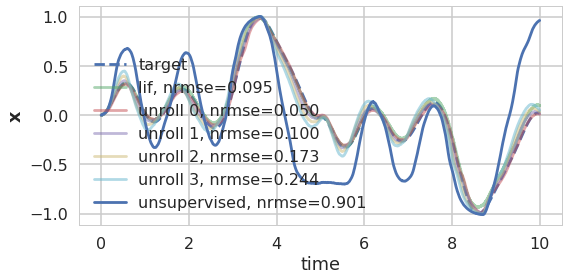

nrmse = 0.901
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

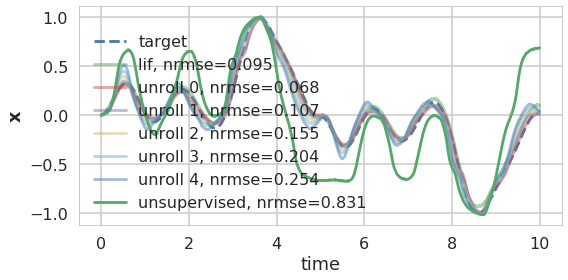

nrmse = 0.831
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

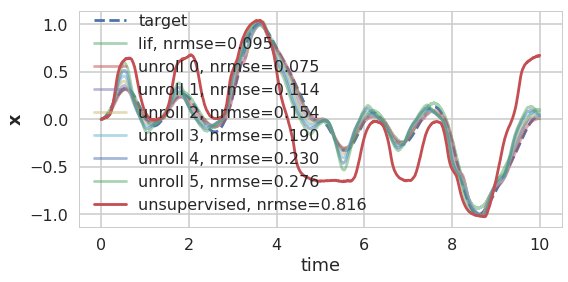

nrmse = 0.816
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

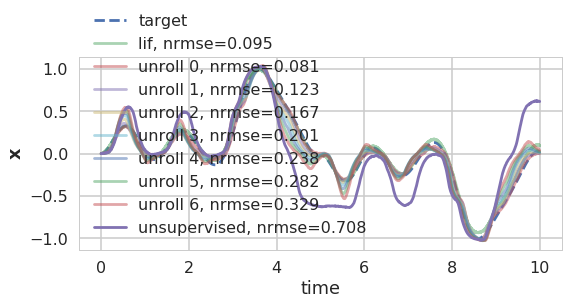

nrmse = 0.708


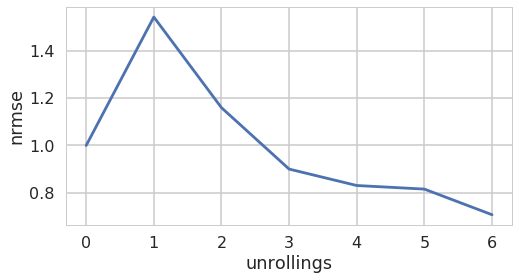

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

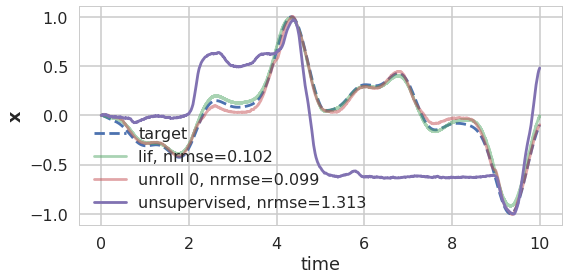

In [125]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

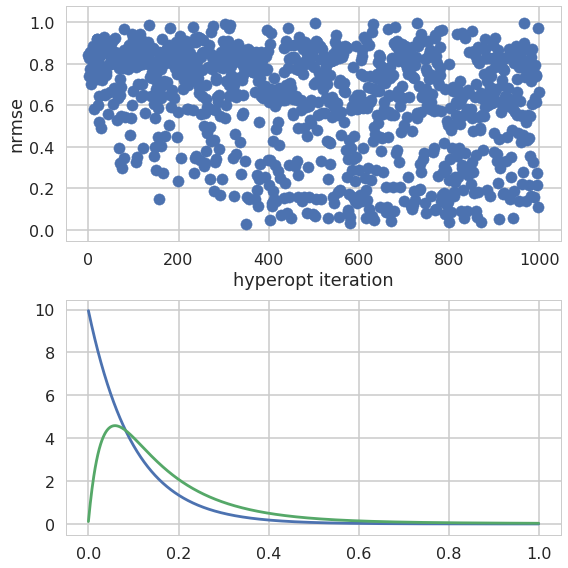

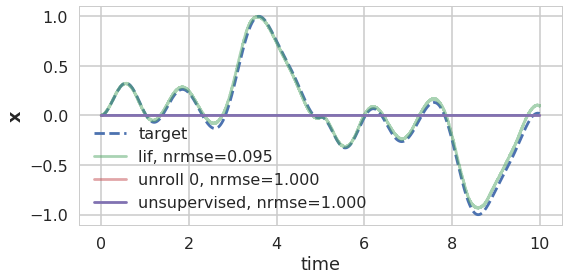

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

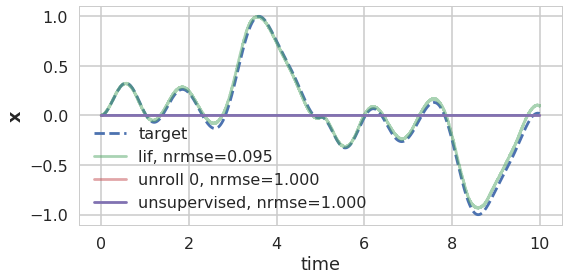

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

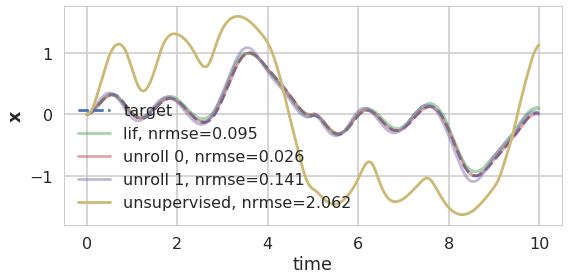

nrmse = 2.062
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

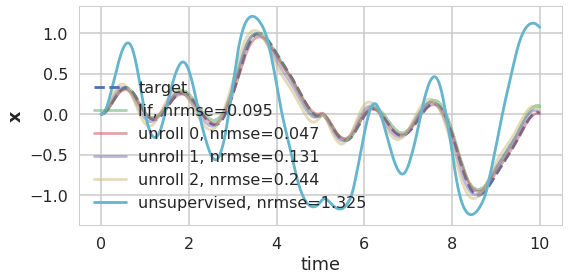

nrmse = 1.325
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

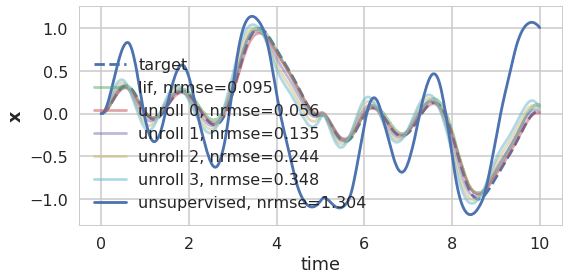

nrmse = 1.304
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

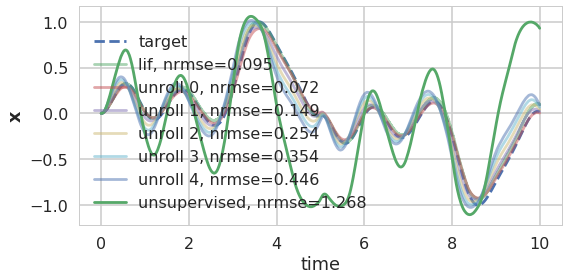

nrmse = 1.268
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

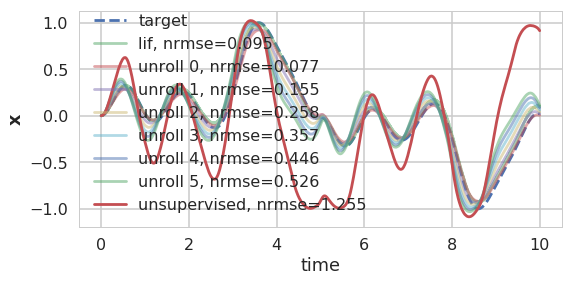

nrmse = 1.255
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

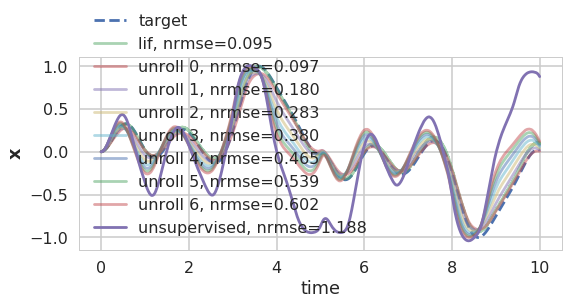

nrmse = 1.188


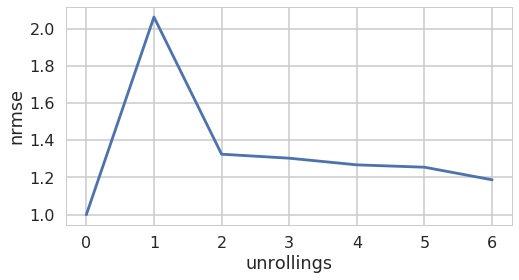

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

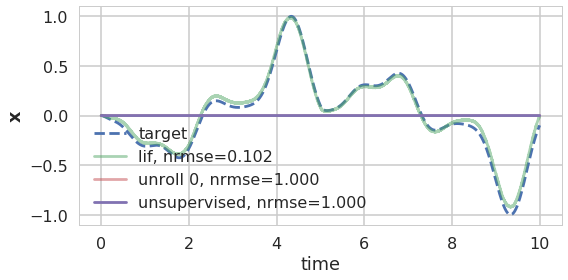

In [126]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.1,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

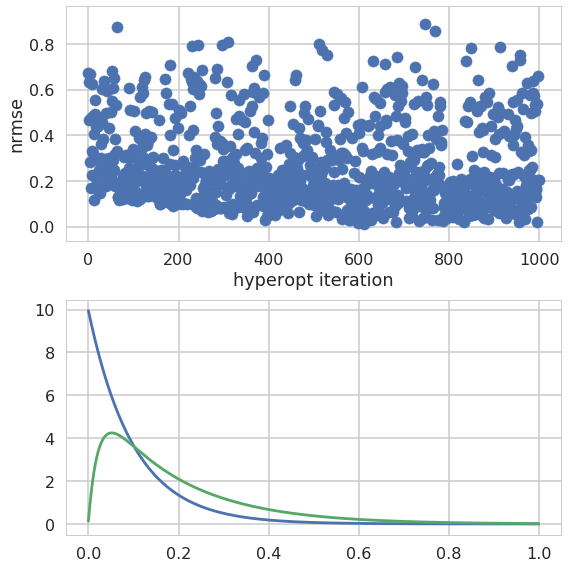

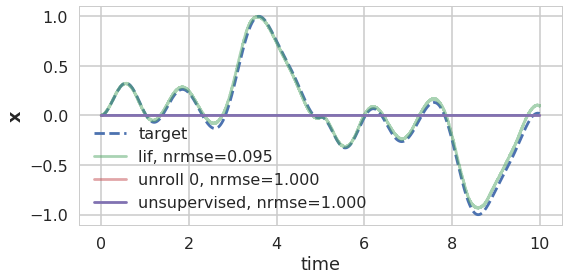

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

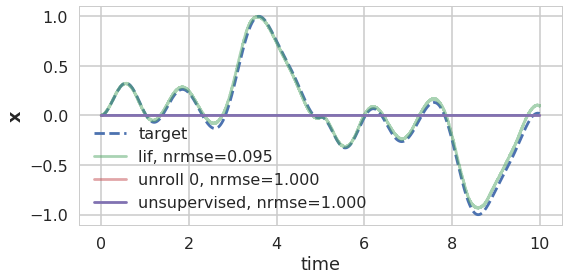

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

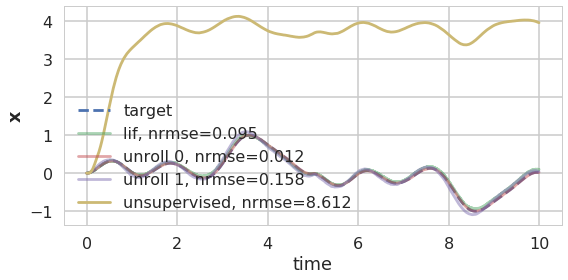

nrmse = 8.612
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

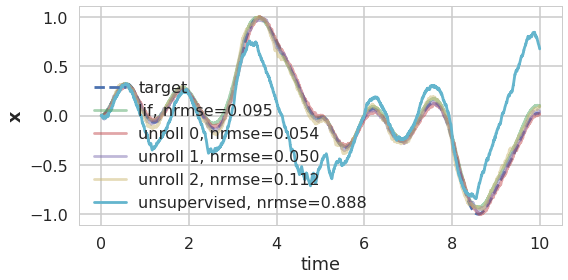

nrmse = 0.888
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

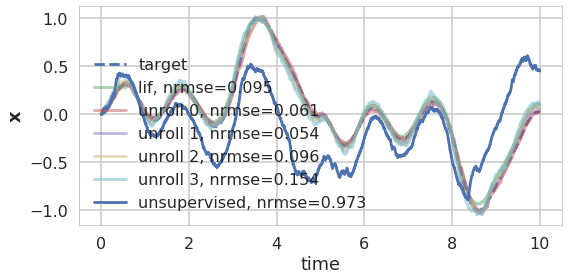

nrmse = 0.973
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

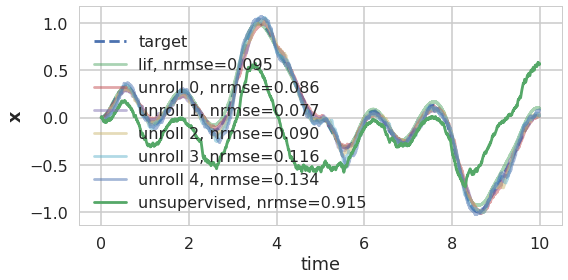

nrmse = 0.915
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

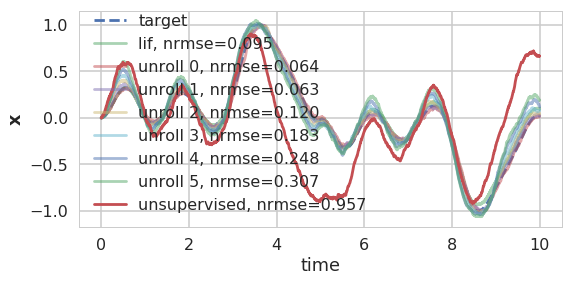

nrmse = 0.957
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

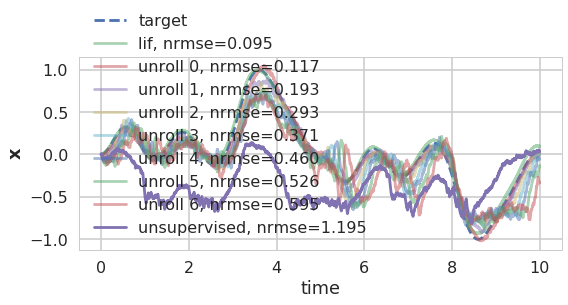

nrmse = 1.195


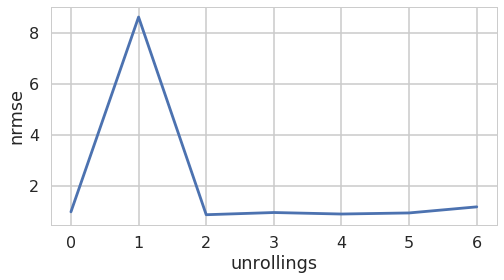

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

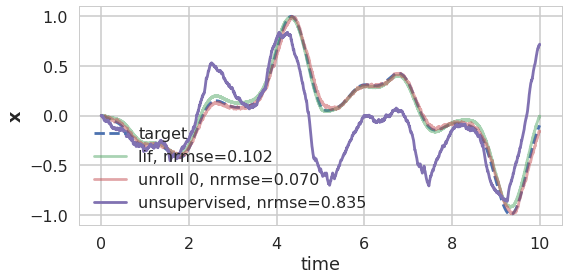

In [127]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

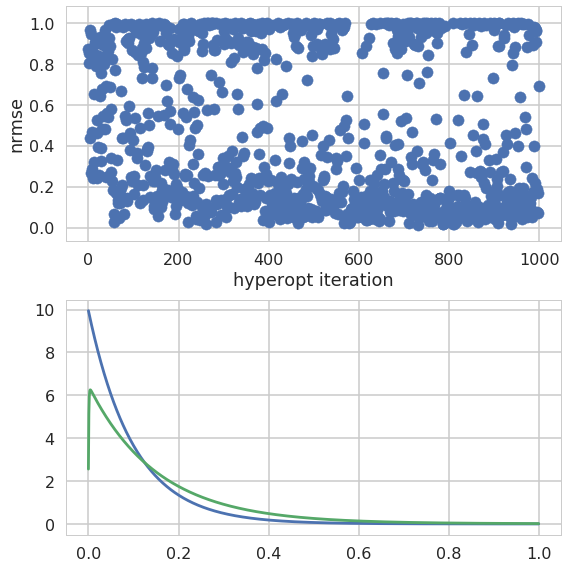

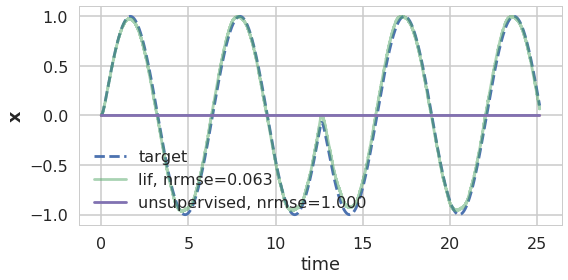

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

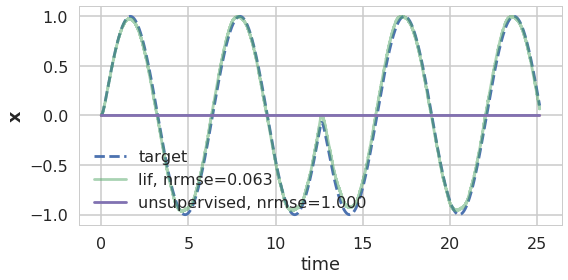

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

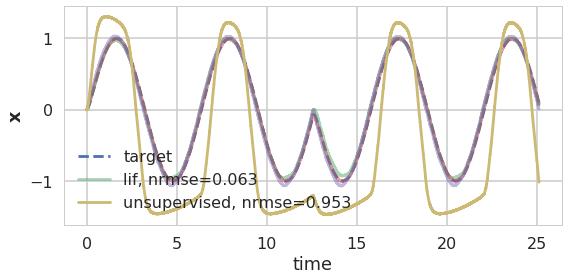

nrmse = 0.953
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

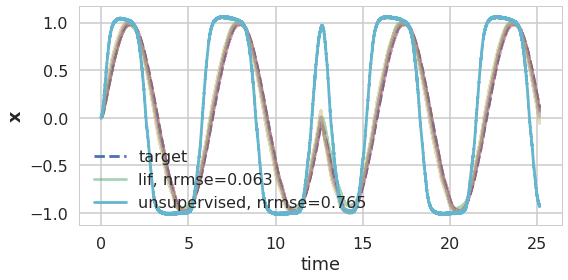

nrmse = 0.765
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

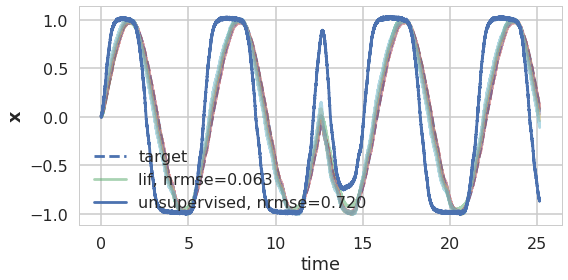

nrmse = 0.720
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

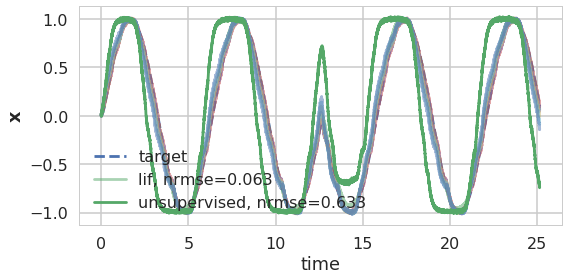

nrmse = 0.633
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

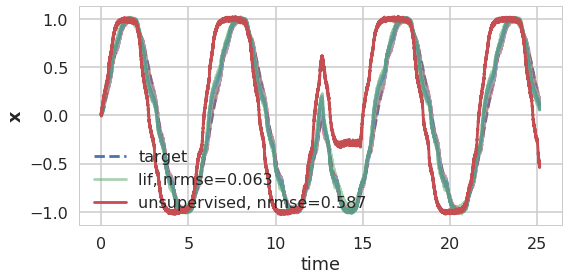

nrmse = 0.587
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

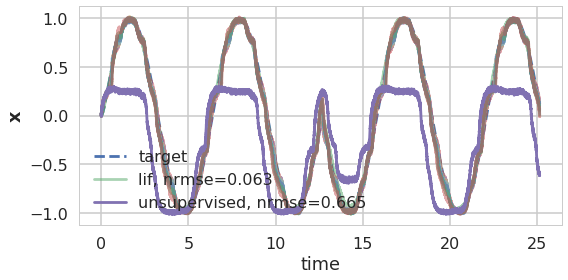

nrmse = 0.665


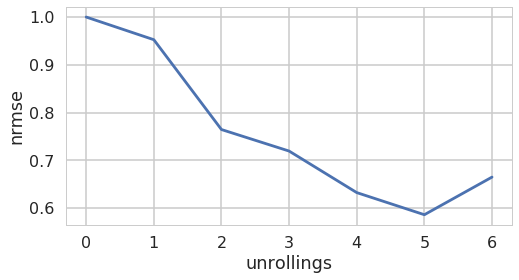

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

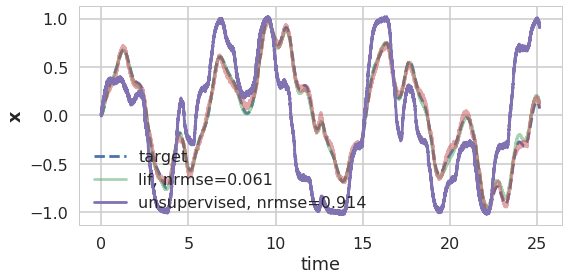

In [164]:
kwargs = dict(
    t=8*np.pi,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=0,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

### filter and JL dims

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

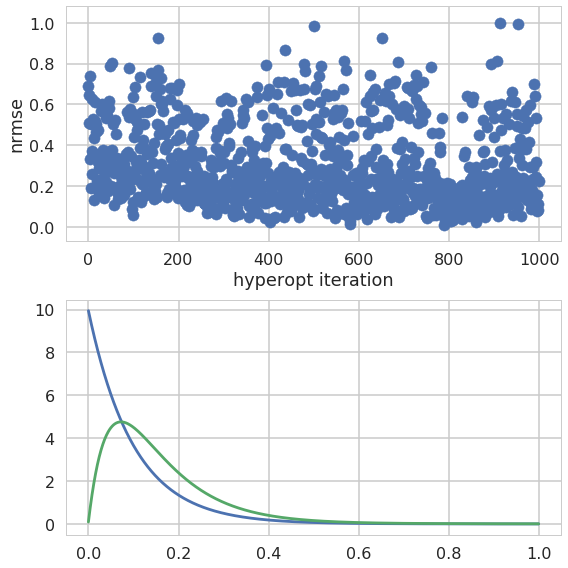

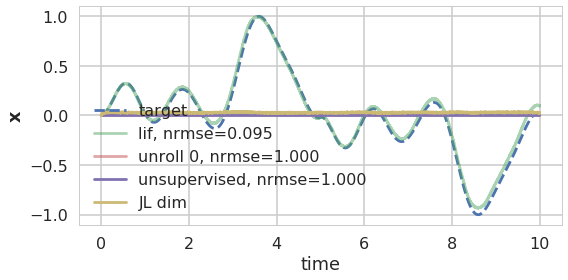

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

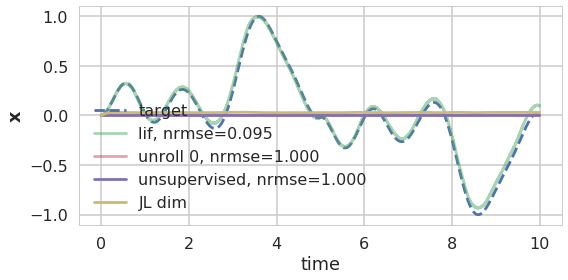

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

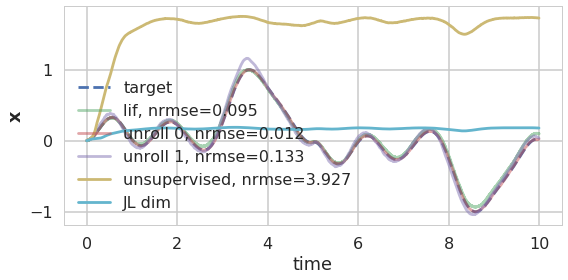

nrmse = 3.927
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

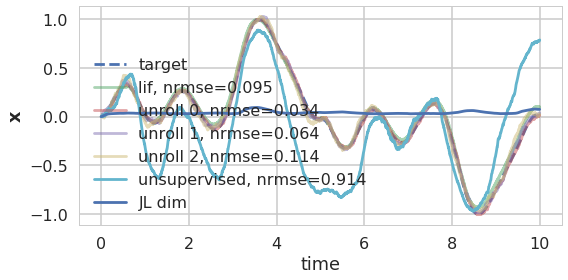

nrmse = 0.914
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

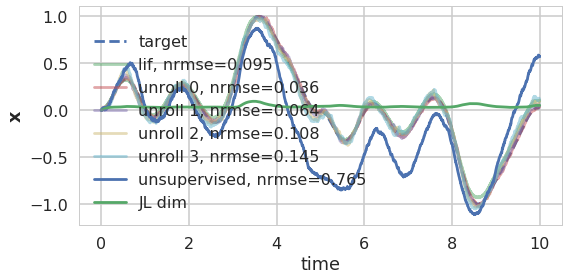

nrmse = 0.765
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

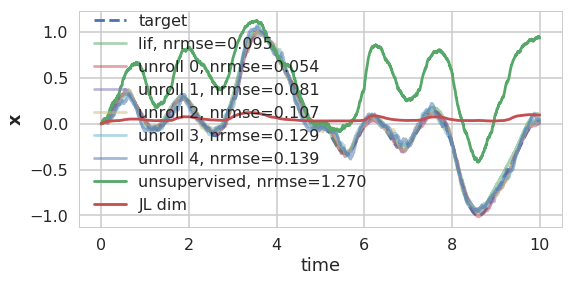

nrmse = 1.270
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

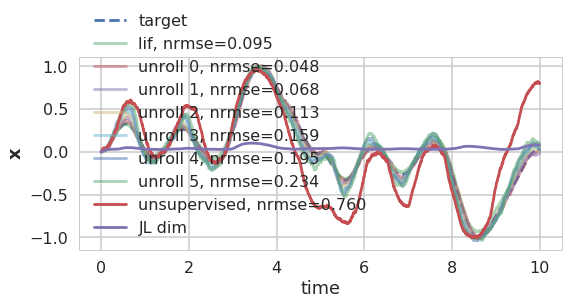

nrmse = 0.760
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

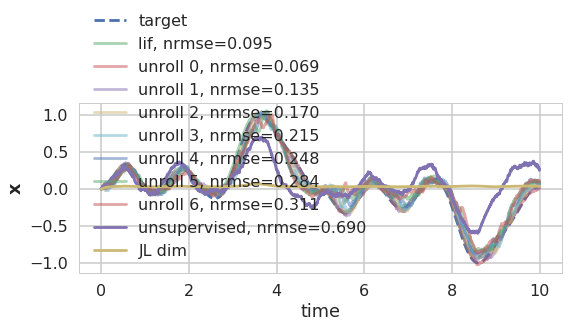

nrmse = 0.690
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

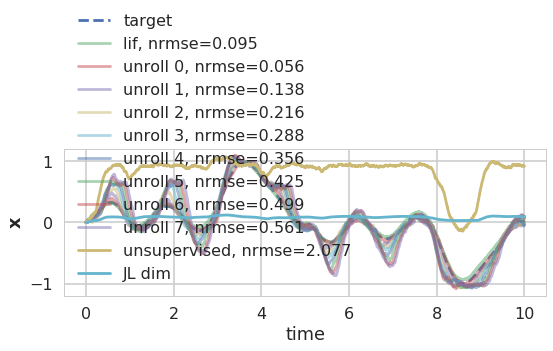

nrmse = 2.077
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

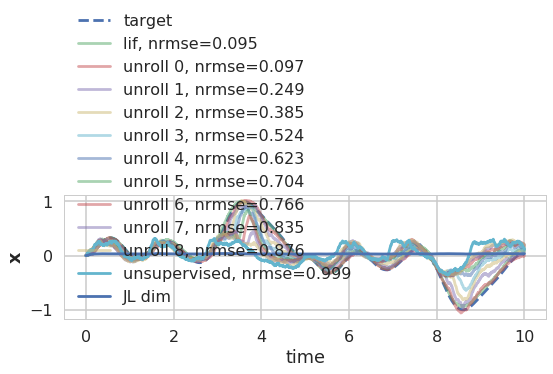

nrmse = 0.999


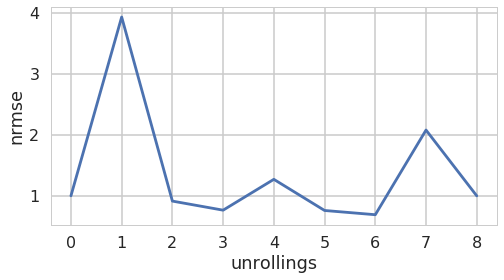

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

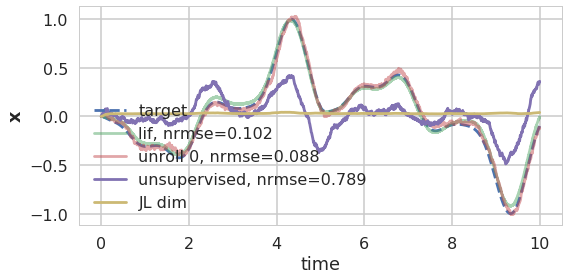

In [128]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

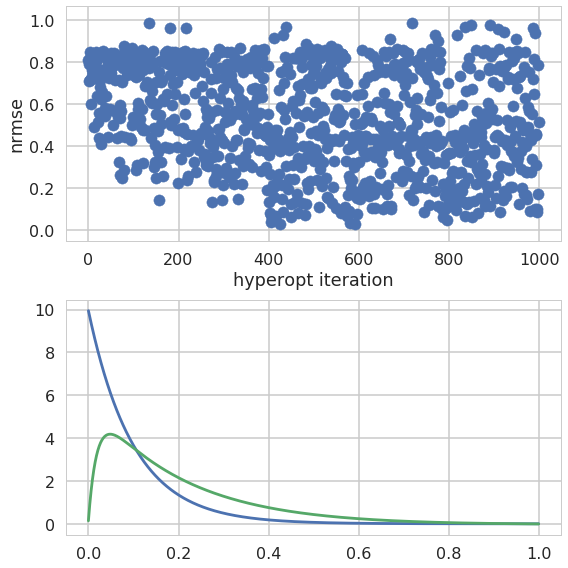

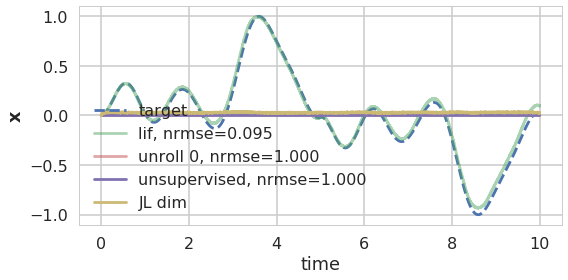

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

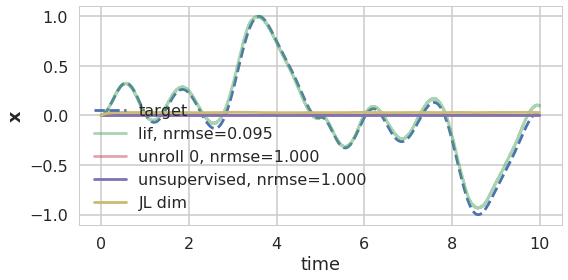

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

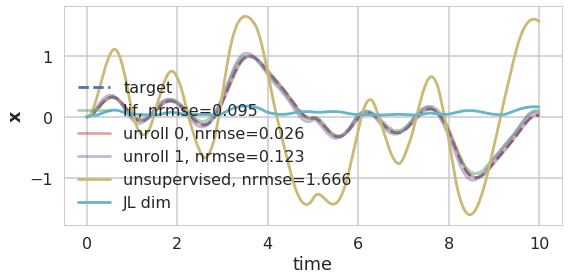

nrmse = 1.666
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

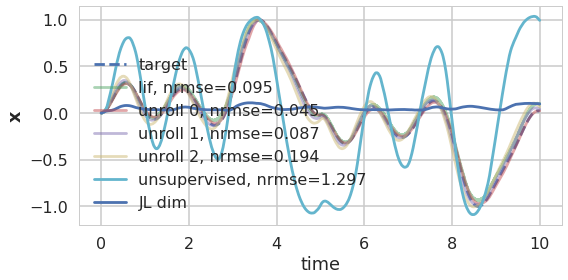

nrmse = 1.297
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

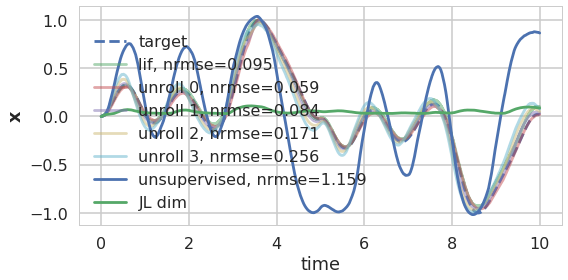

nrmse = 1.159
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

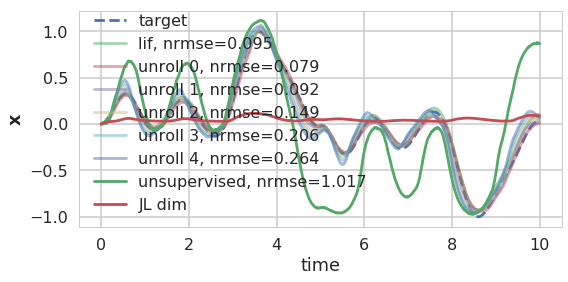

nrmse = 1.017
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

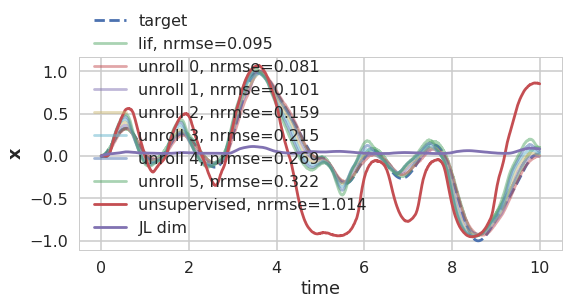

nrmse = 1.014
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

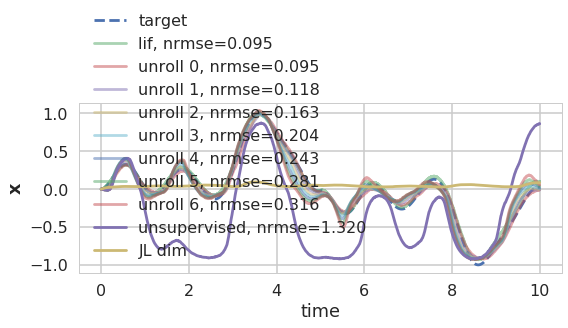

nrmse = 1.320
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

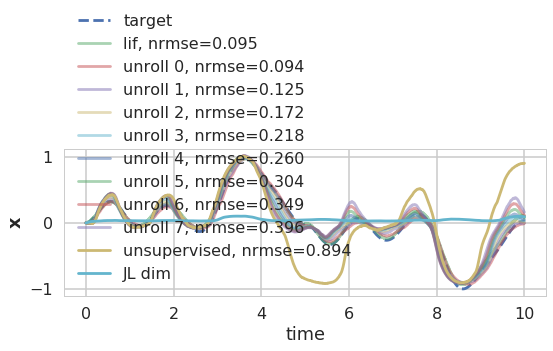

nrmse = 0.894
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

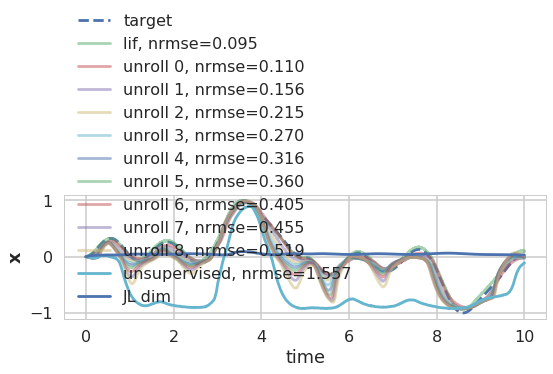

nrmse = 1.557


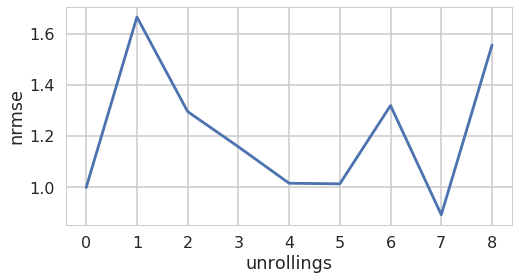

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

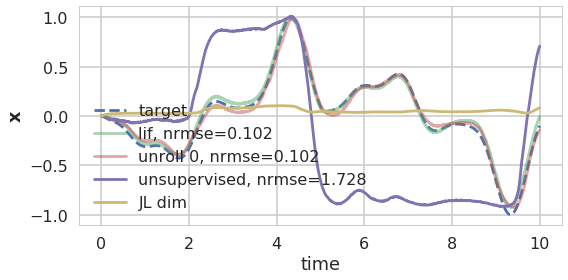

In [129]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

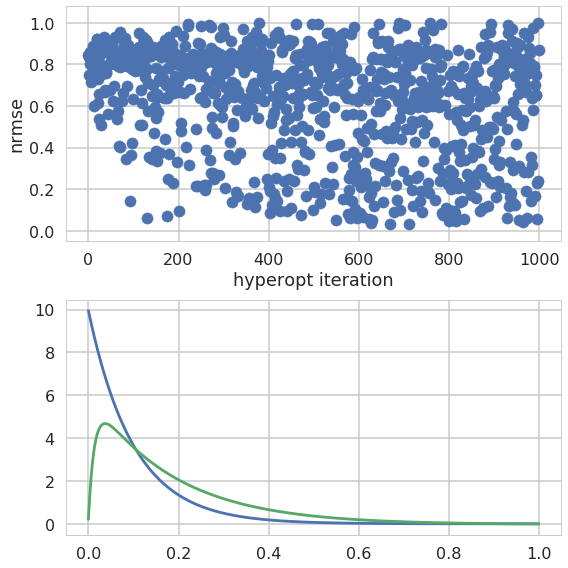

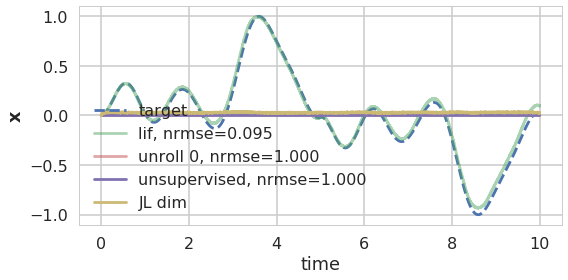

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

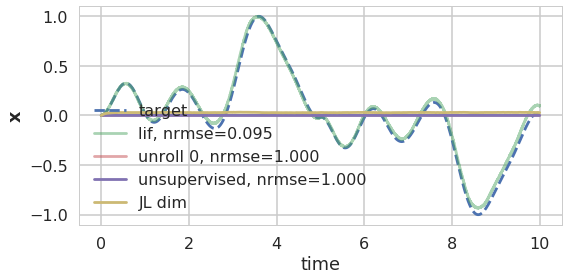

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

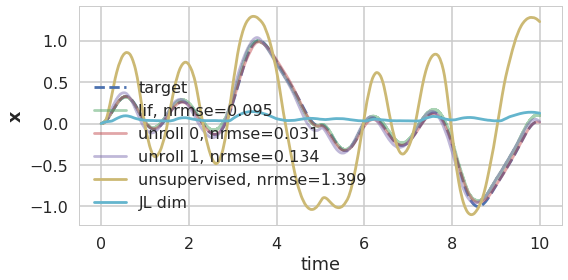

nrmse = 1.399
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

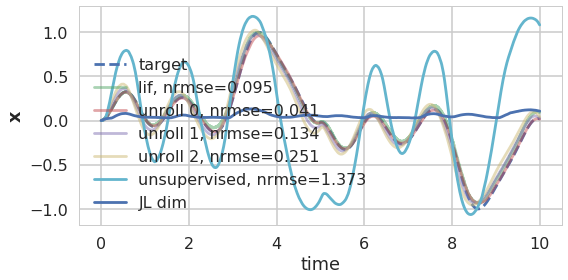

nrmse = 1.373
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

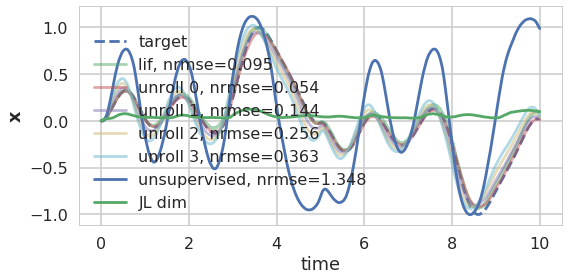

nrmse = 1.348
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

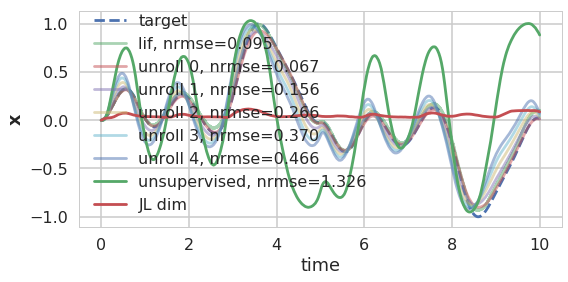

nrmse = 1.326
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

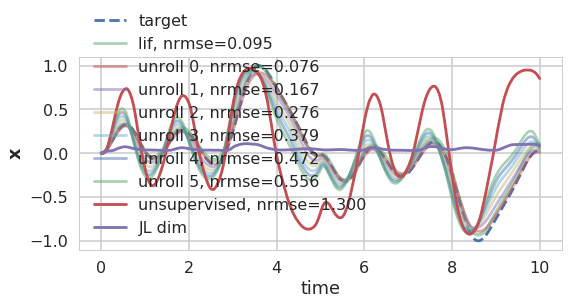

nrmse = 1.300
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

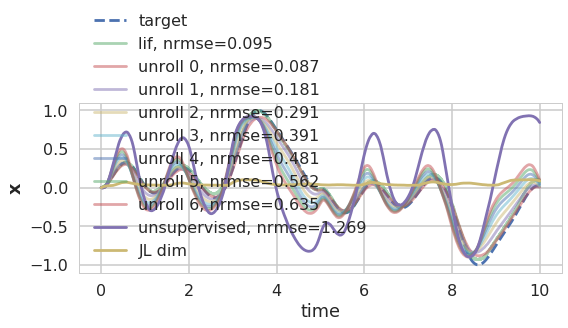

nrmse = 1.269
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

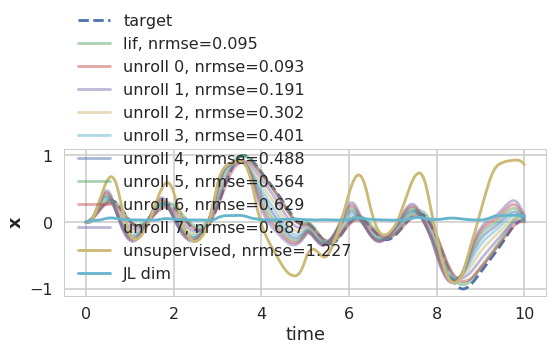

nrmse = 1.227
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

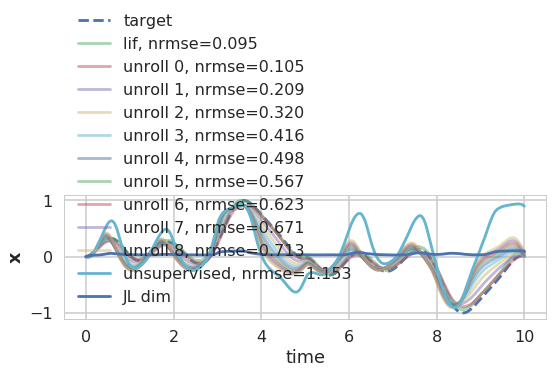

nrmse = 1.153


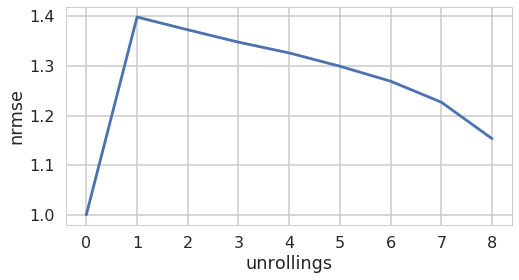

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

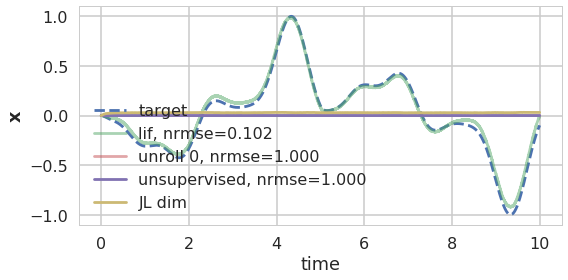

In [130]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=1e-4,
    reg=0.1,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

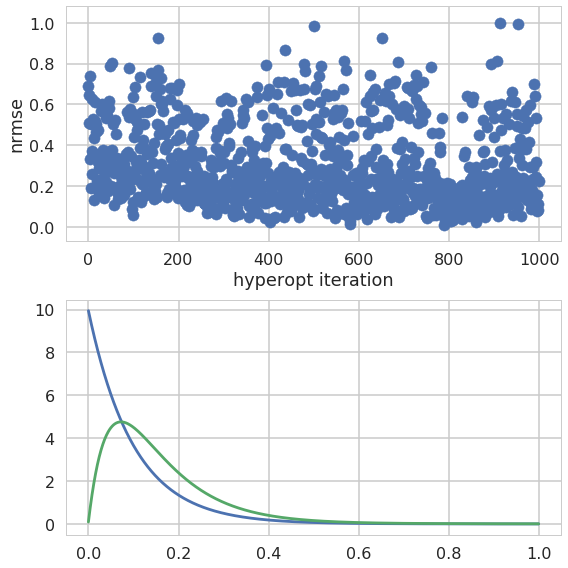

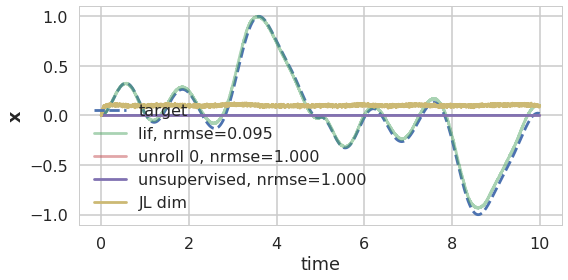

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

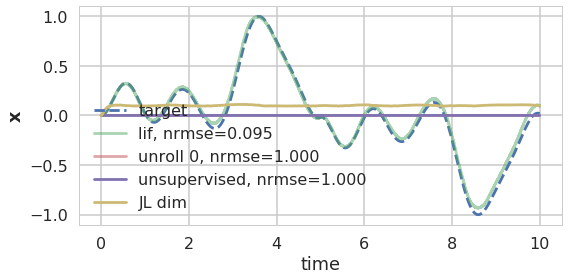

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

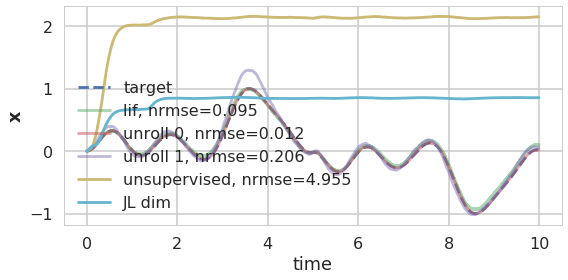

nrmse = 4.955
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

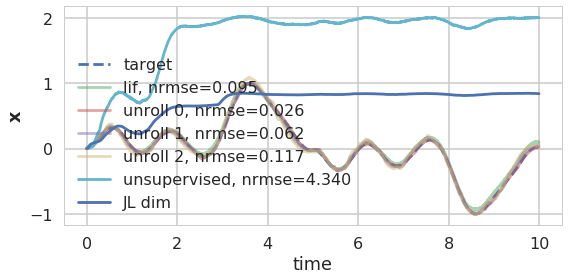

nrmse = 4.340
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

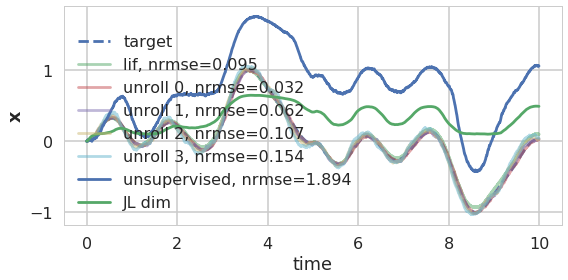

nrmse = 1.894
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

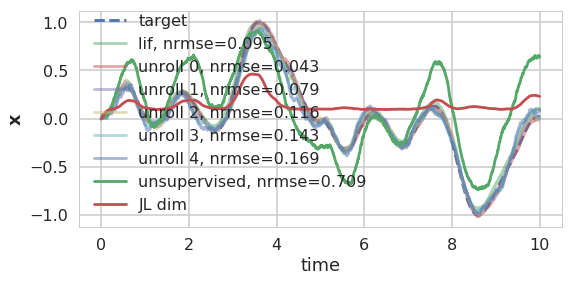

nrmse = 0.709
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

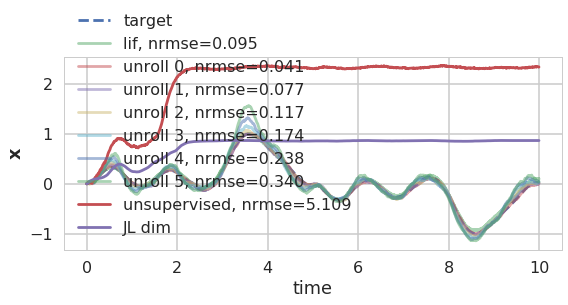

nrmse = 5.109
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

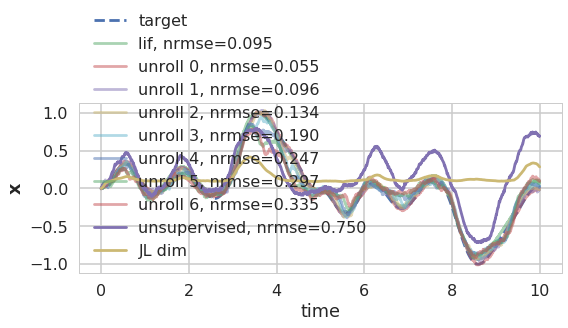

nrmse = 0.750
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

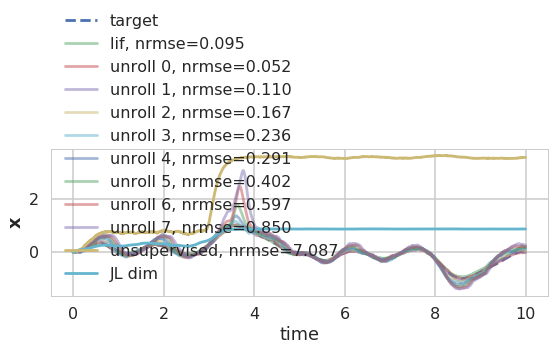

nrmse = 7.087
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

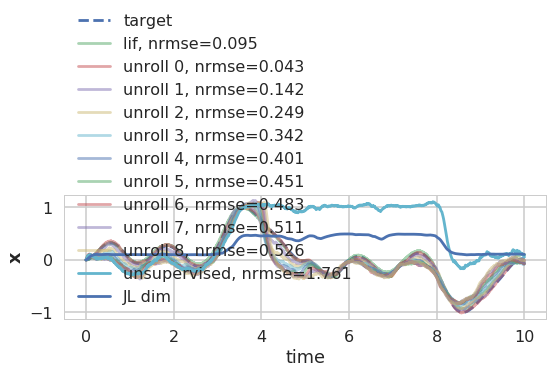

nrmse = 1.761


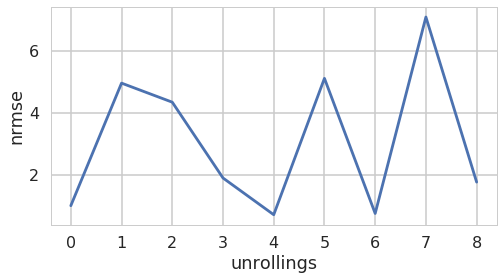

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

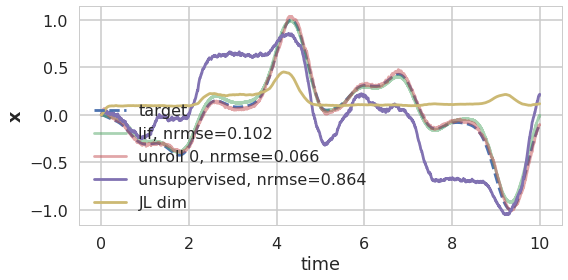

In [131]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=3e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

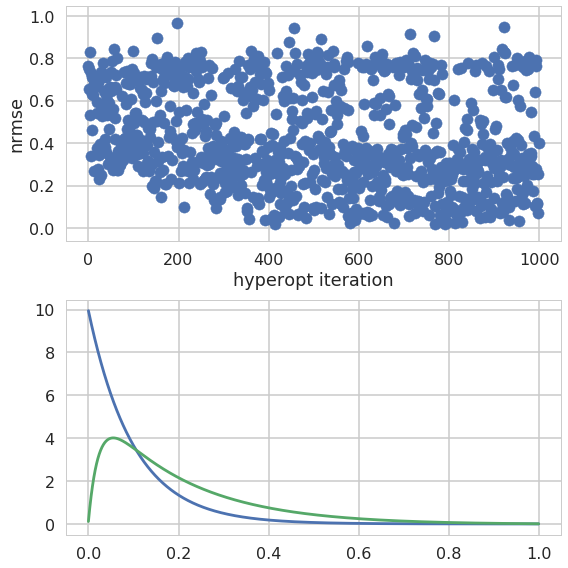

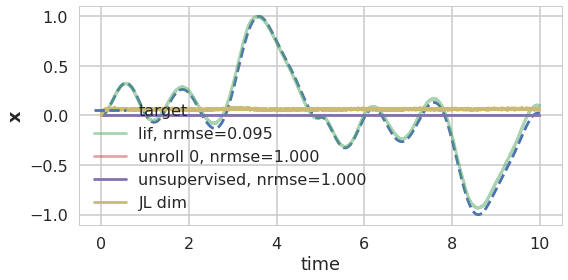

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

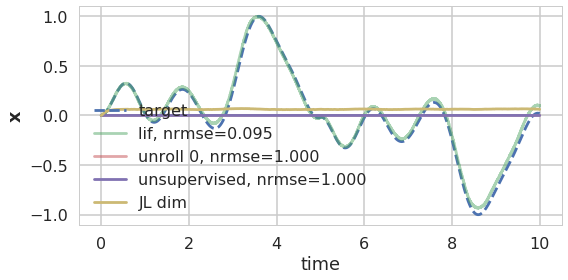

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

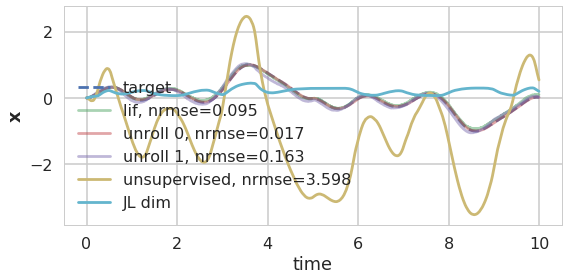

nrmse = 3.598
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

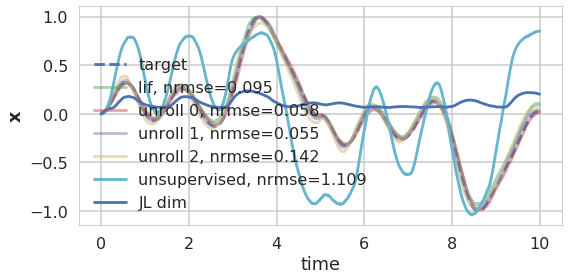

nrmse = 1.109
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

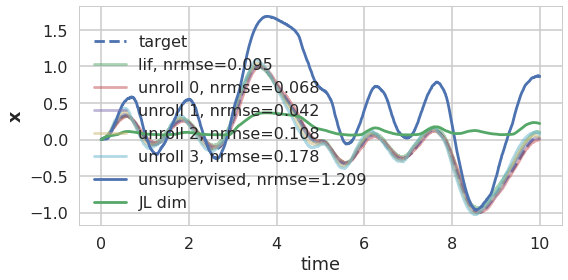

nrmse = 1.209
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

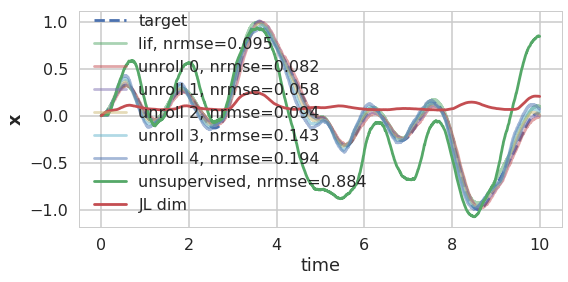

nrmse = 0.884
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

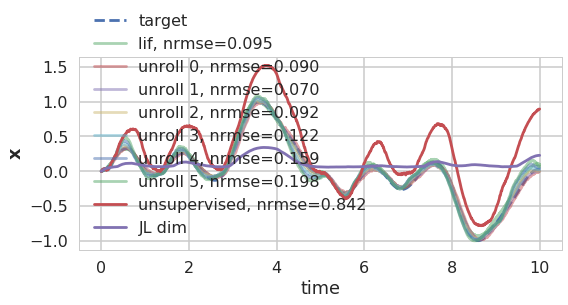

nrmse = 0.842
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

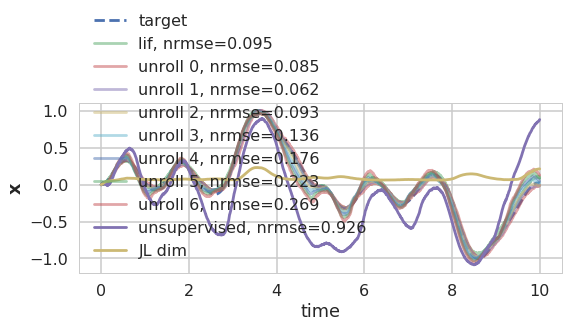

nrmse = 0.926


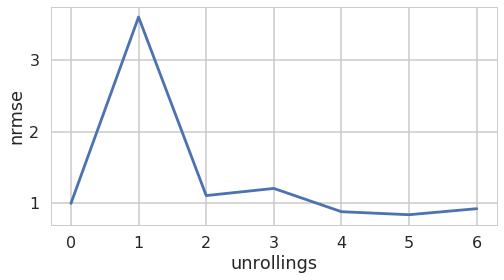

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

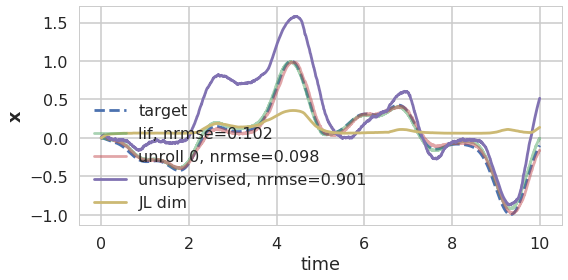

In [132]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=2e-4,
    reg=0.003,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

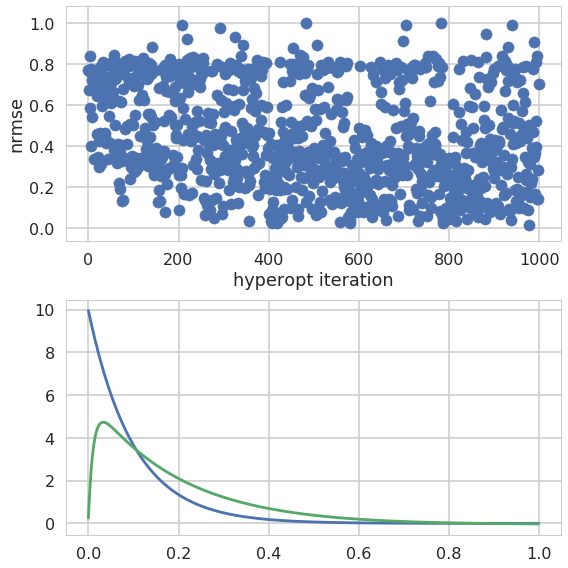

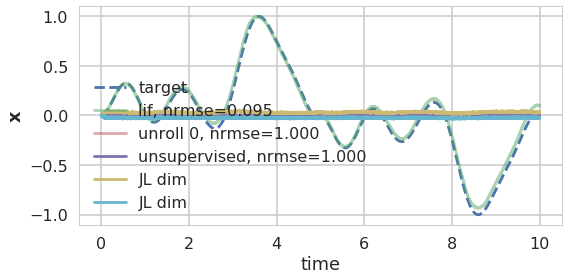

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

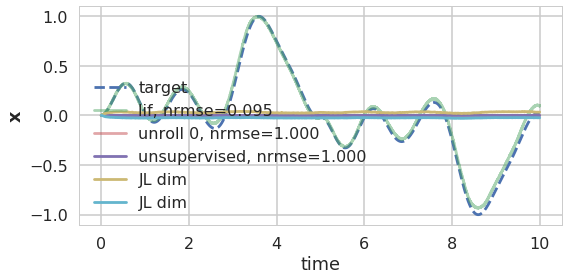

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

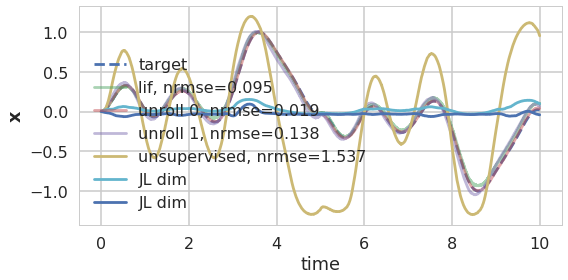

nrmse = 1.537
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

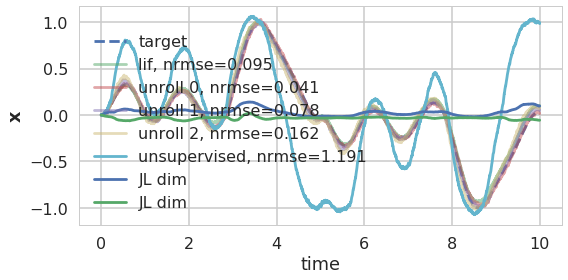

nrmse = 1.191
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

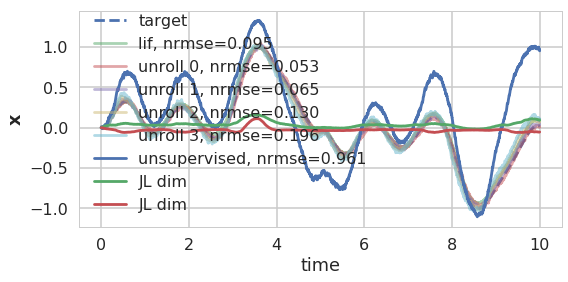

nrmse = 0.961
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

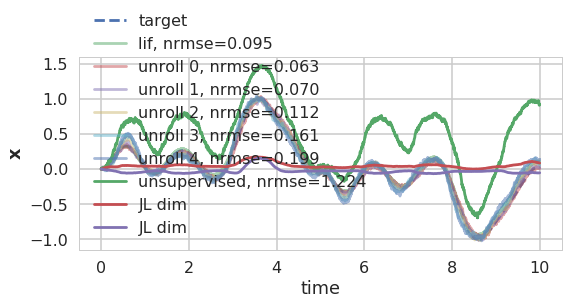

nrmse = 1.224
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

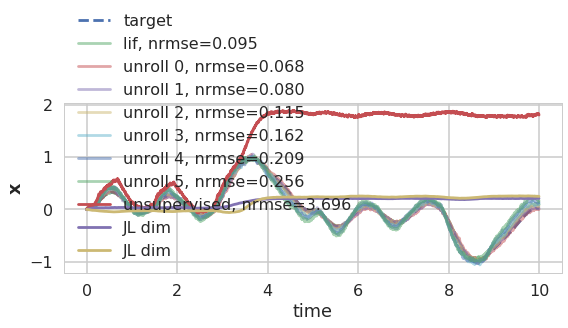

nrmse = 3.696
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

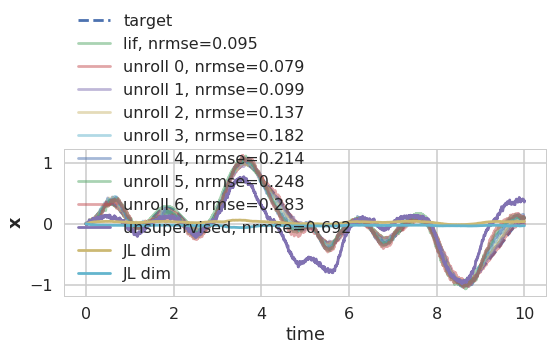

nrmse = 0.692


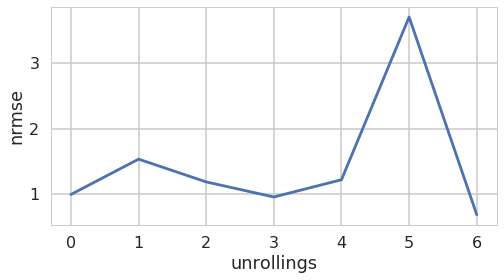

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

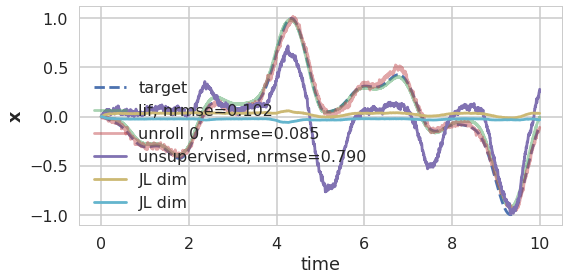

In [133]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=2,
    jl_sigma=2e-4,
    reg=0.003,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

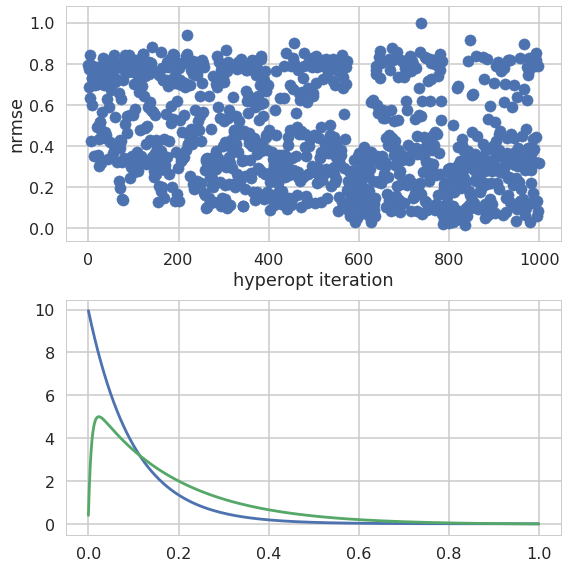

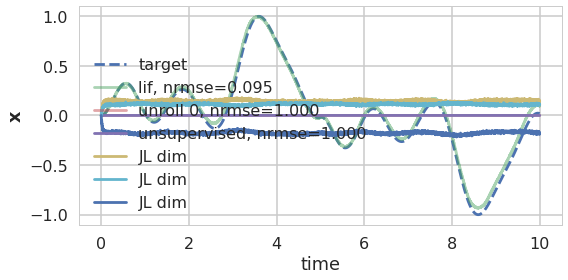

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

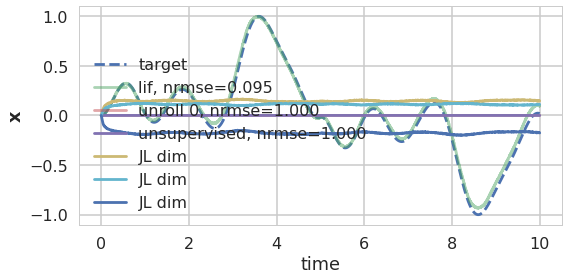

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

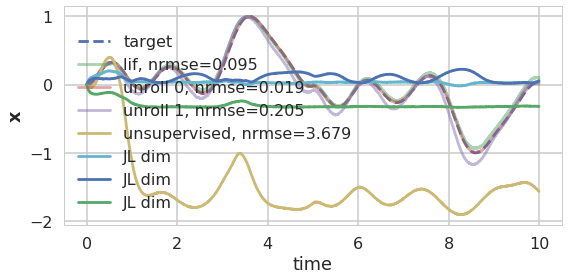

nrmse = 3.679
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

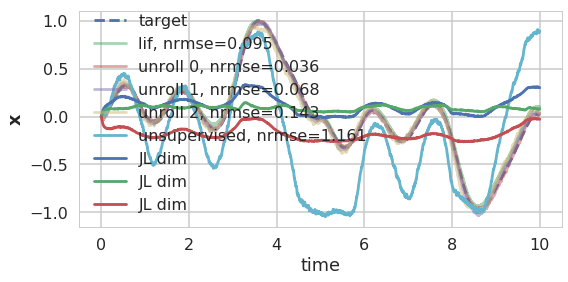

nrmse = 1.161
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

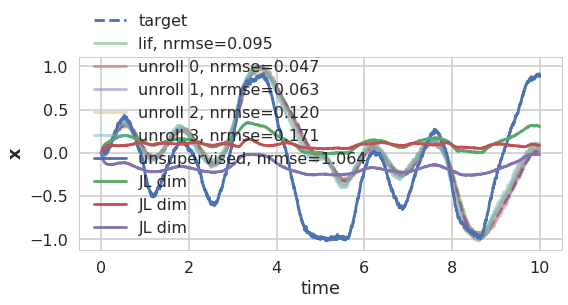

nrmse = 1.064
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

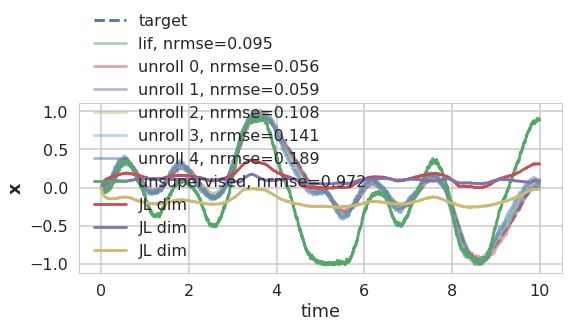

nrmse = 0.972
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

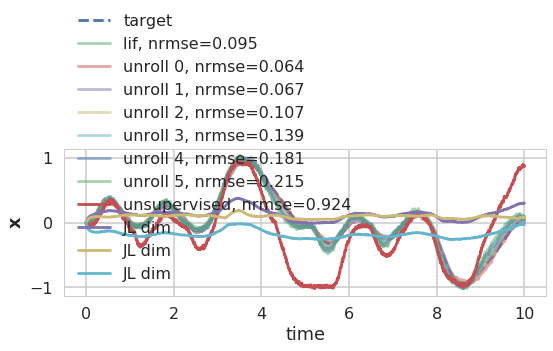

nrmse = 0.924
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

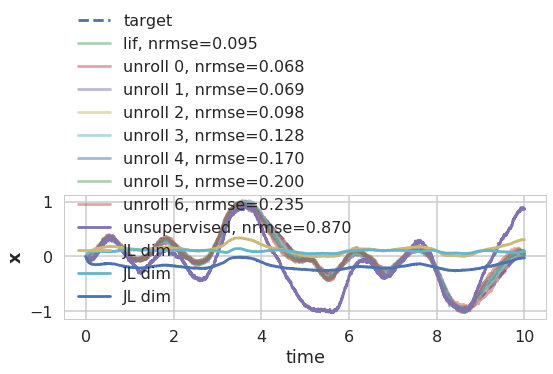

nrmse = 0.870
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

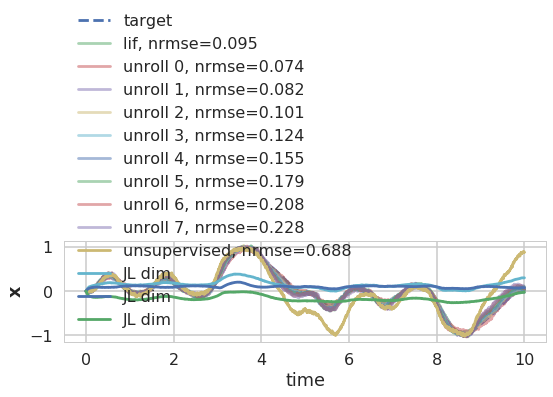

nrmse = 0.688
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

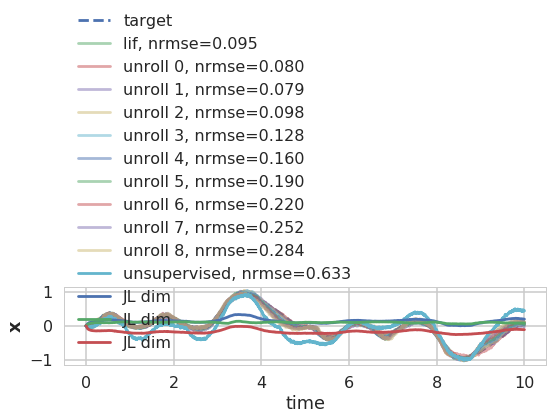

nrmse = 0.633


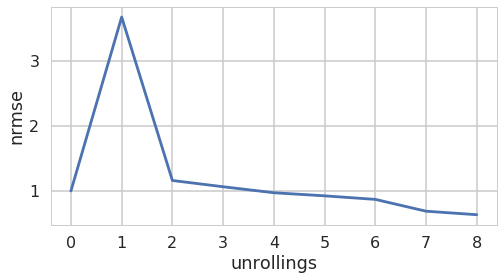

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

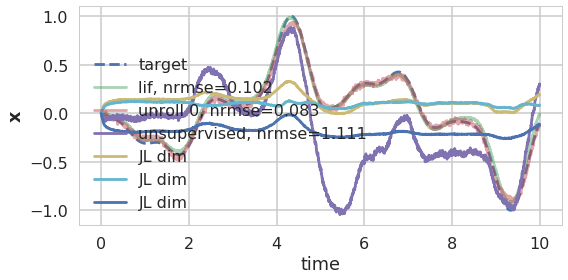

In [134]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=3e-4,
    reg=0.003,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

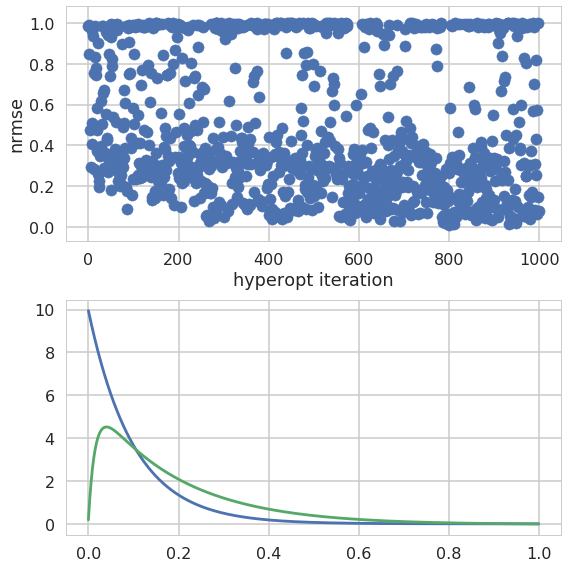

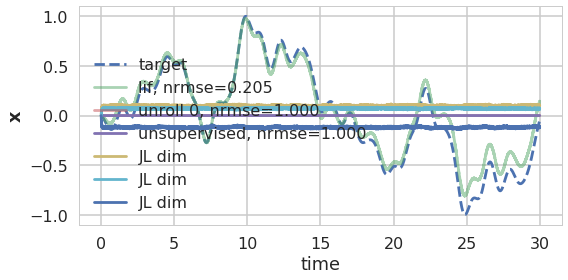

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

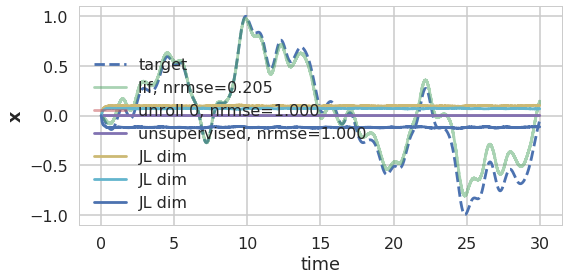

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

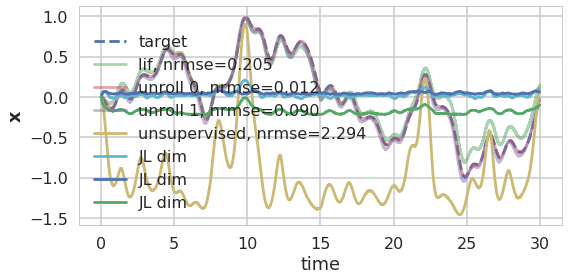

nrmse = 2.294
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

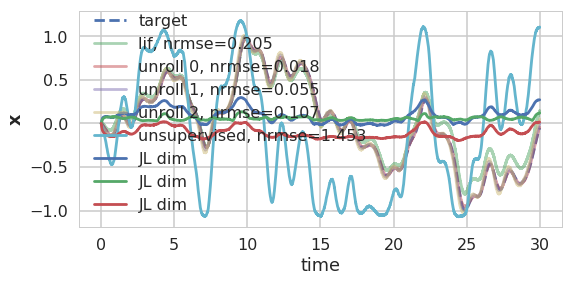

nrmse = 1.453
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

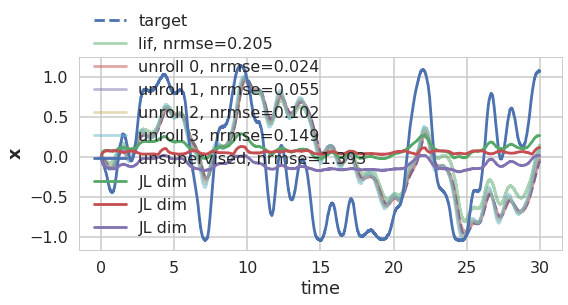

nrmse = 1.393
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

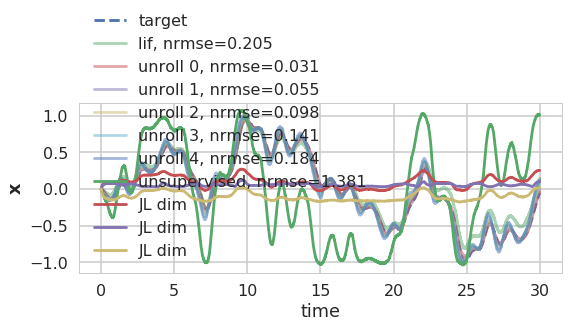

nrmse = 1.381
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

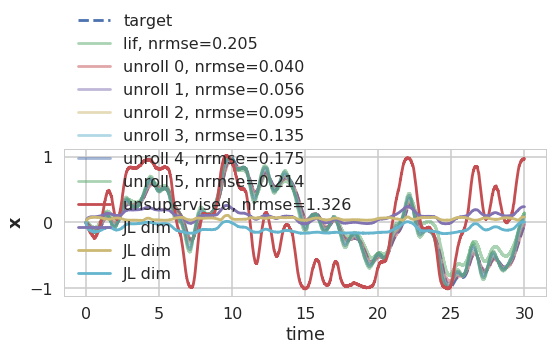

nrmse = 1.326
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

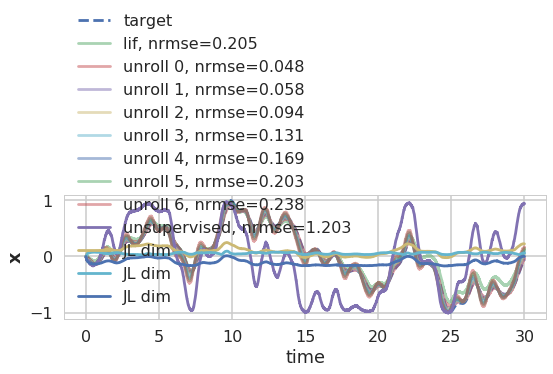

nrmse = 1.203
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

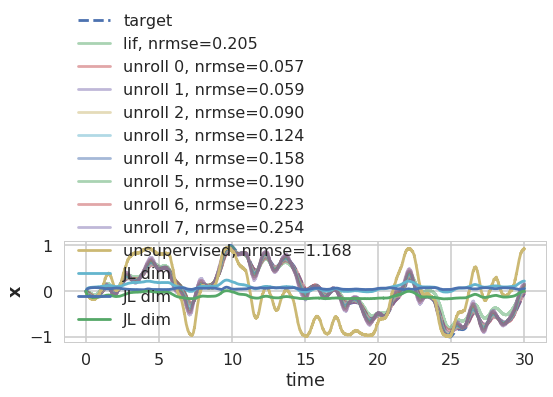

nrmse = 1.168
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

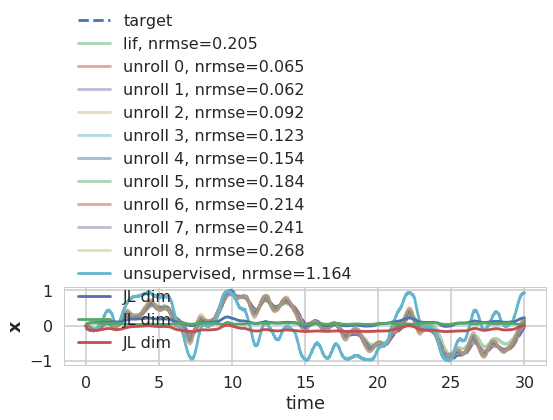

nrmse = 1.164
unrolling #9


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

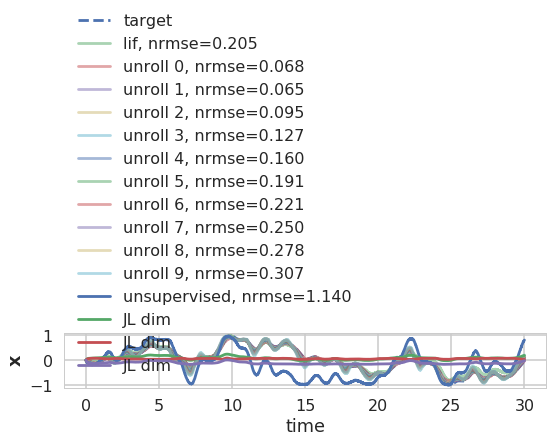

nrmse = 1.140
unrolling #10


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

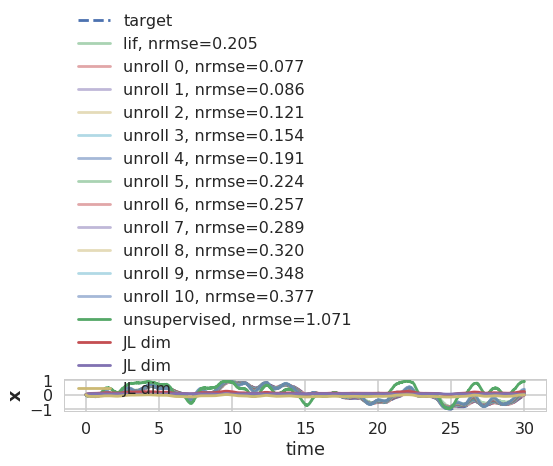

nrmse = 1.071


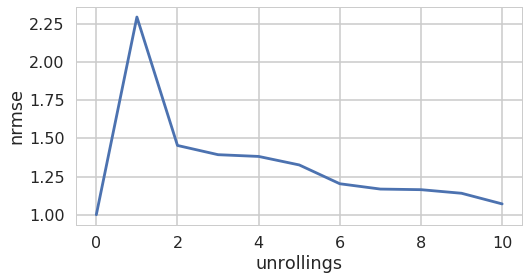

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

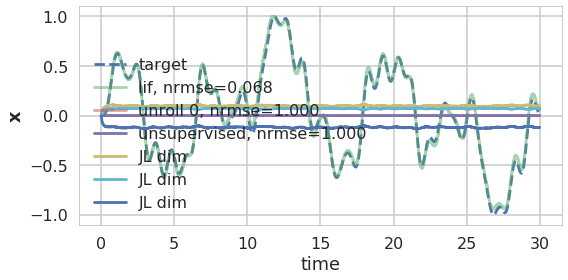

In [135]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=2e-4,
    reg=0.005,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=10, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

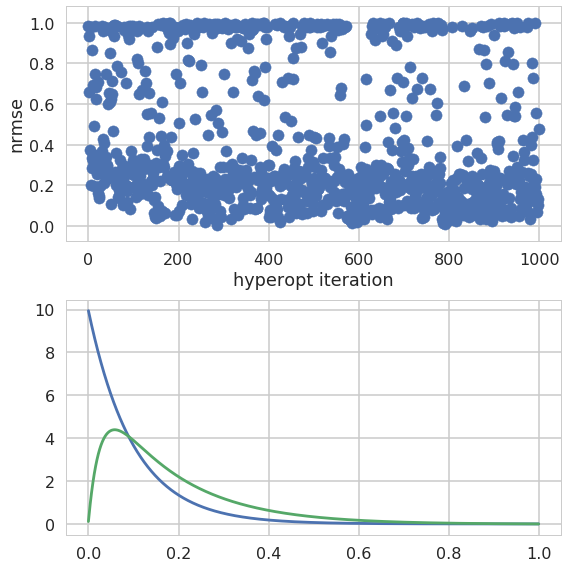

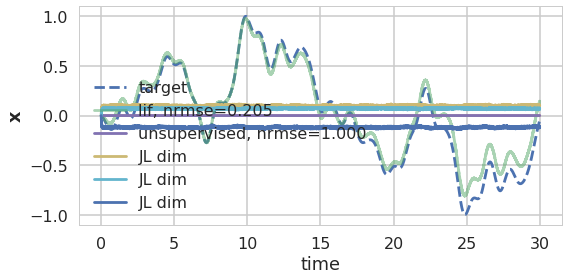

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

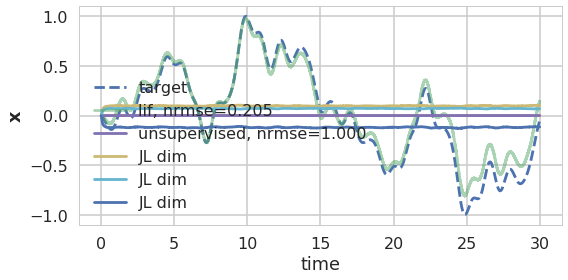

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

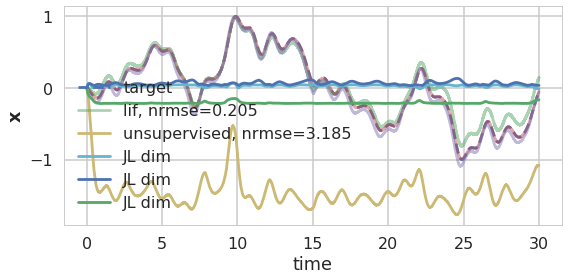

nrmse = 3.185
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

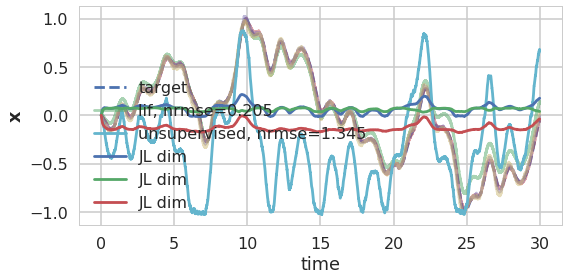

nrmse = 1.345
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

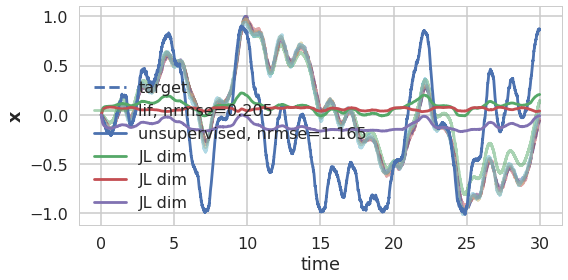

nrmse = 1.165
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

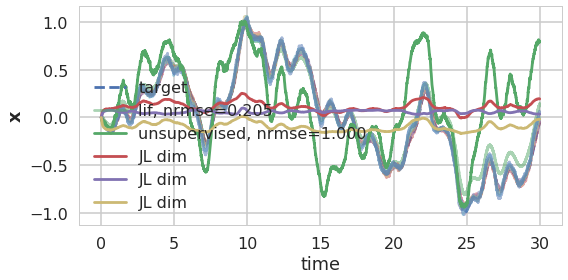

nrmse = 1.000
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

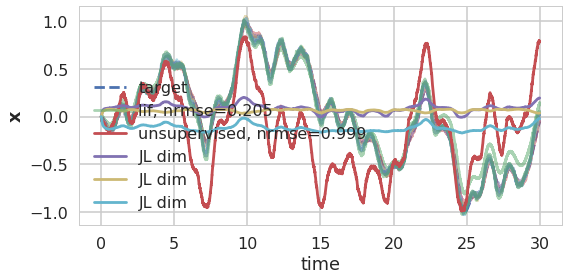

nrmse = 0.999
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

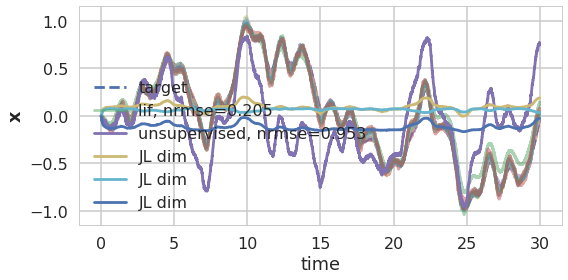

nrmse = 0.953
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

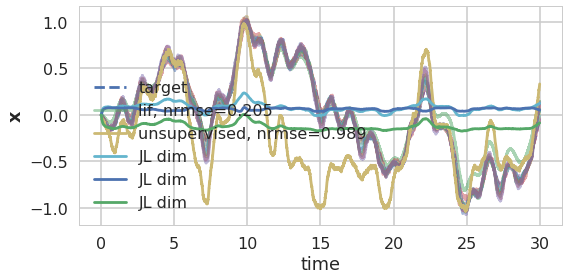

nrmse = 0.989
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

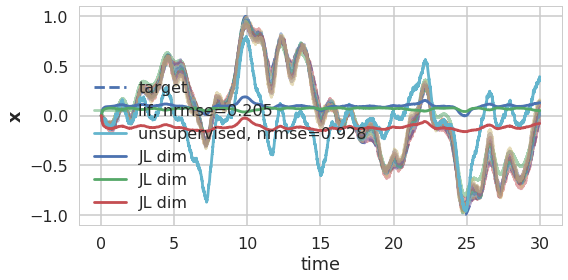

nrmse = 0.928


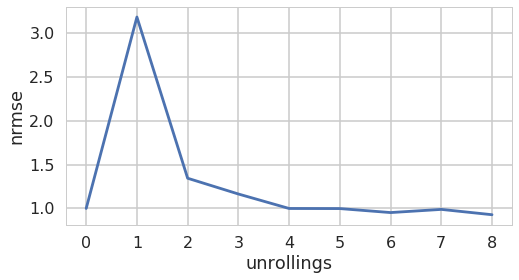

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

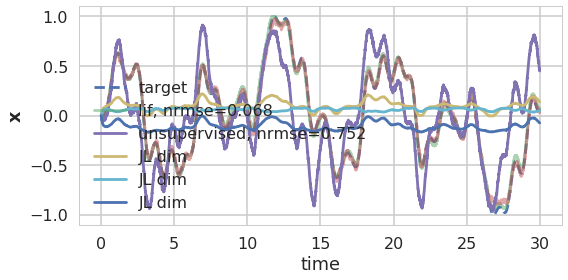

In [140]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=2e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

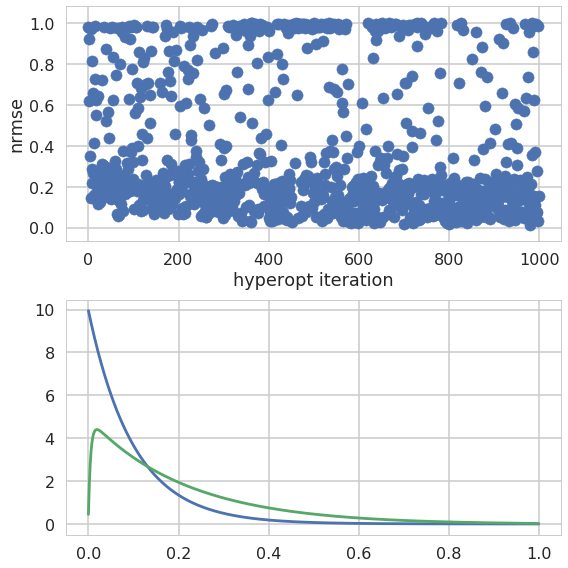

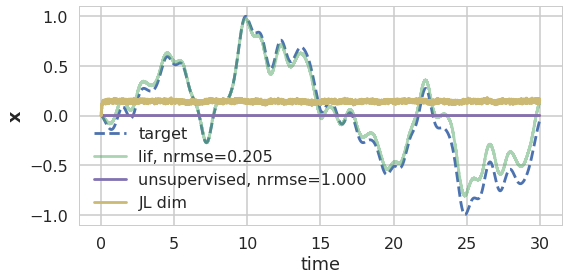

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

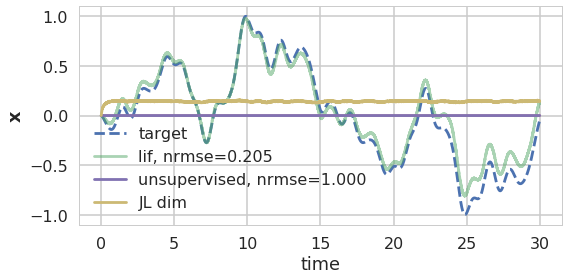

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

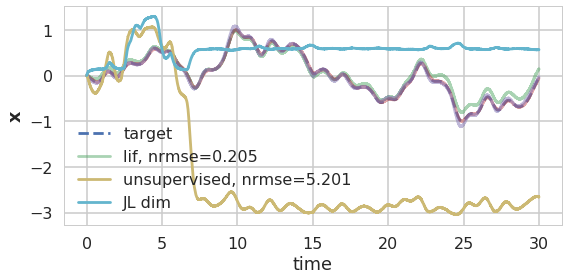

nrmse = 5.201
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

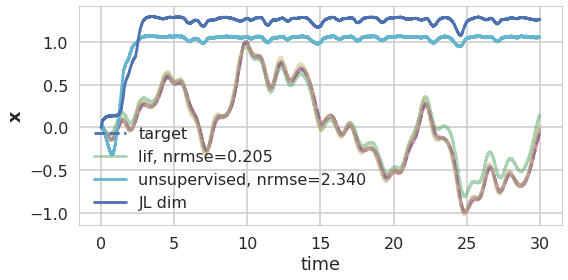

nrmse = 2.340
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

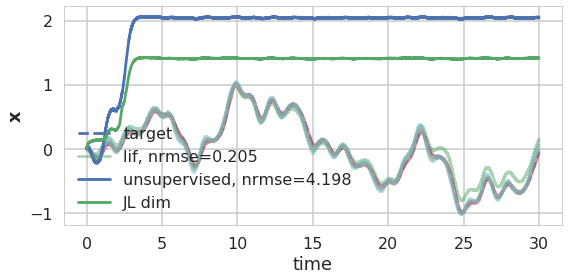

nrmse = 4.198
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

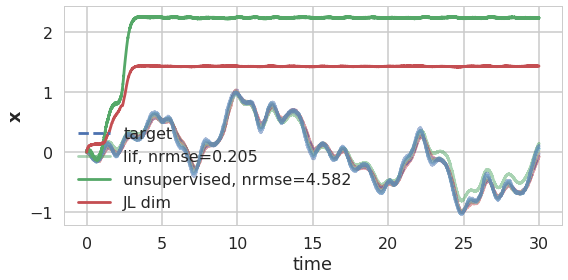

nrmse = 4.582
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

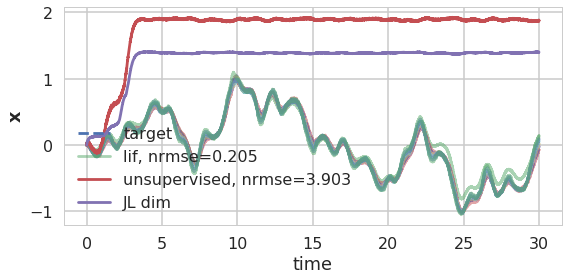

nrmse = 3.903
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

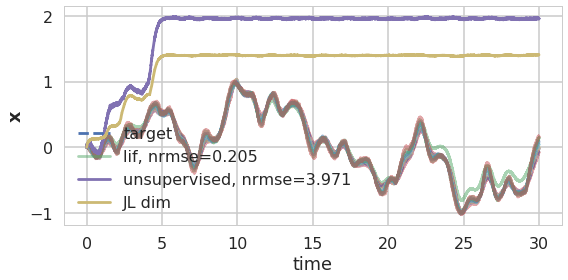

nrmse = 3.971
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

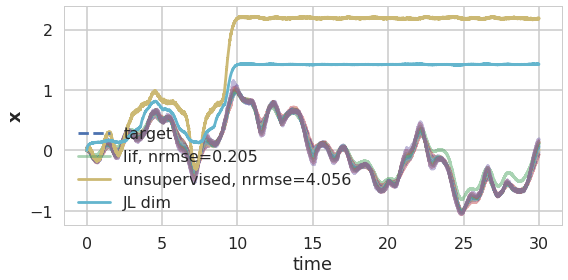

nrmse = 4.056
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

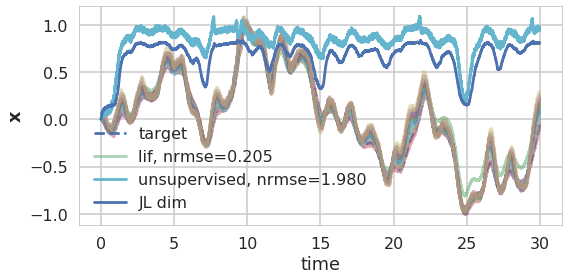

nrmse = 1.980


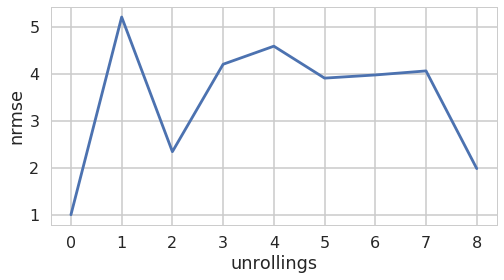

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

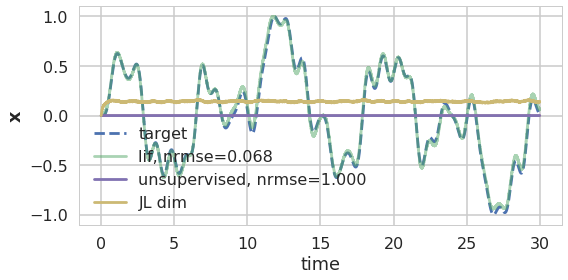

In [141]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=4e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

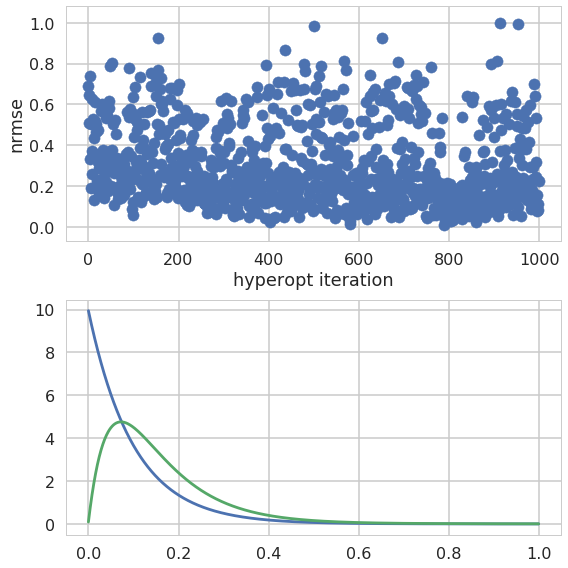

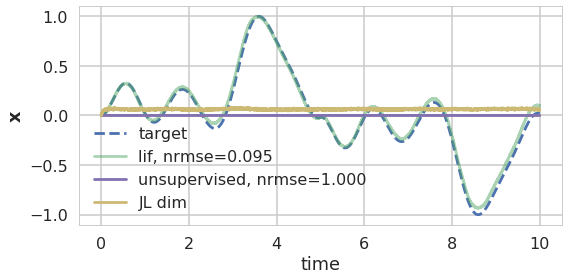

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

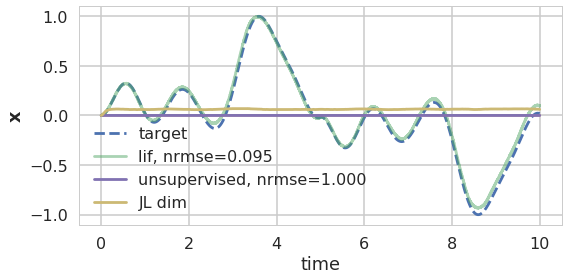

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

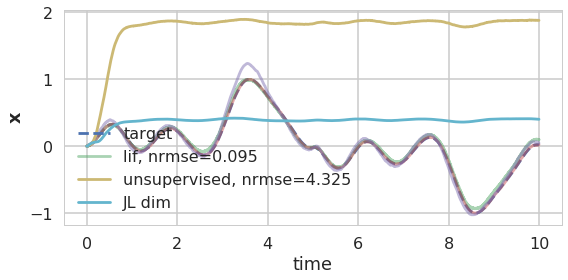

nrmse = 4.325
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

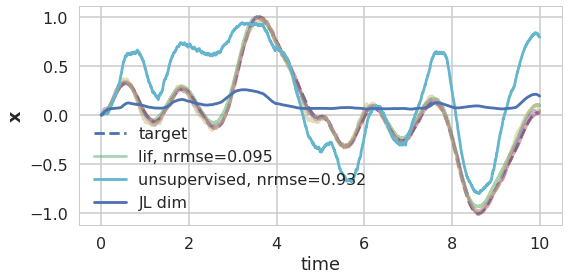

nrmse = 0.932
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

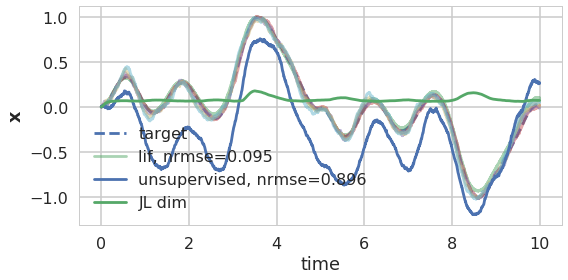

nrmse = 0.896
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

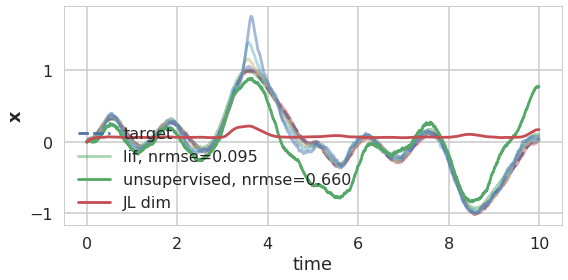

nrmse = 0.660
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

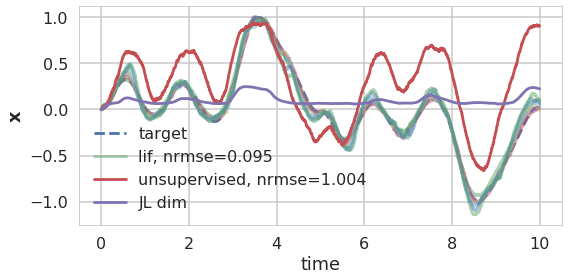

nrmse = 1.004
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

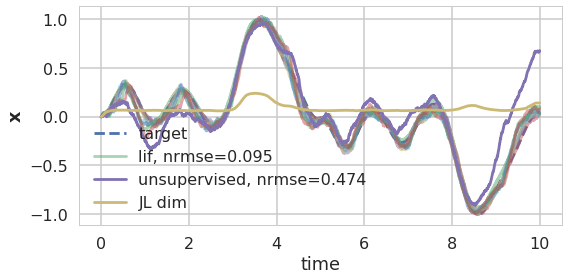

nrmse = 0.474
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

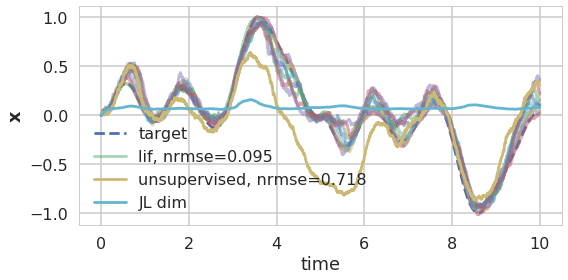

nrmse = 0.718
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

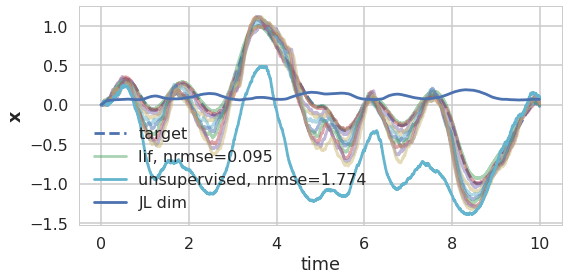

nrmse = 1.774


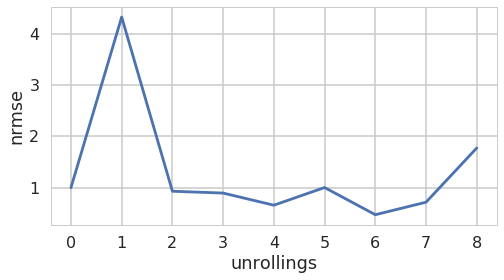

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

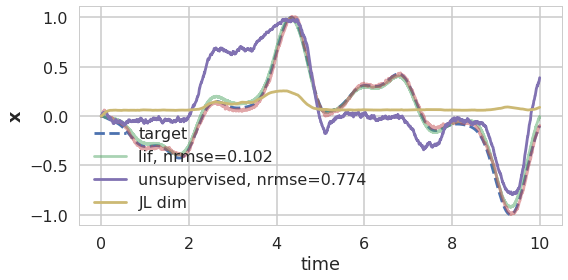

In [144]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=2e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='white_noise', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

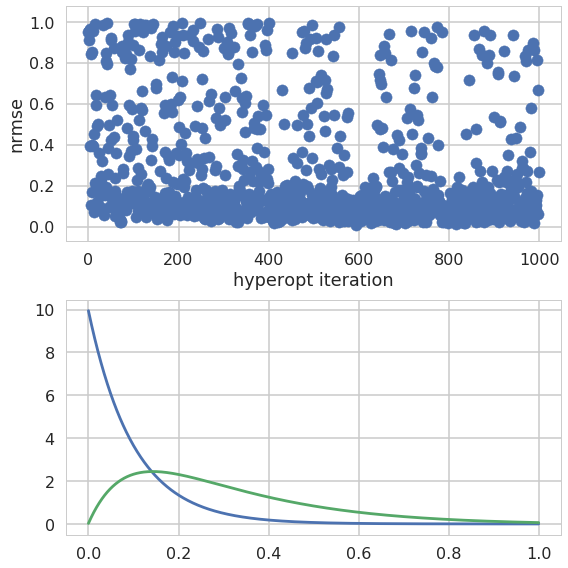

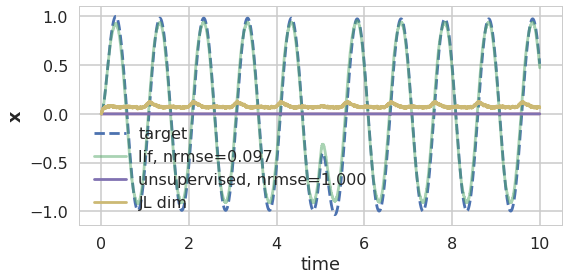

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

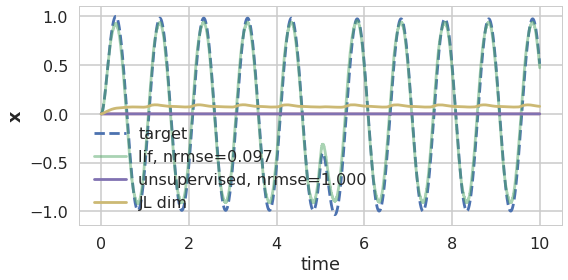

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

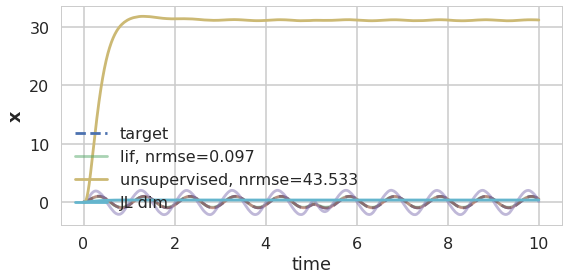

nrmse = 43.533
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

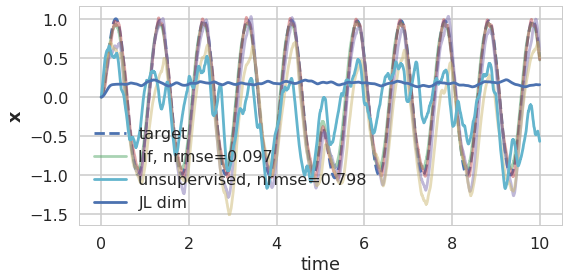

nrmse = 0.798
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

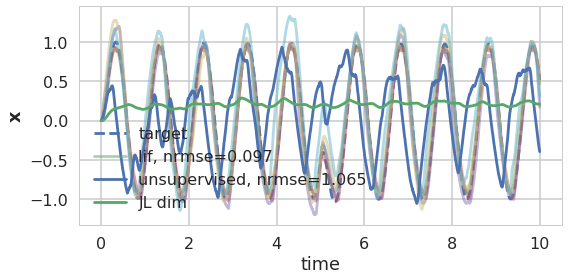

nrmse = 1.065
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

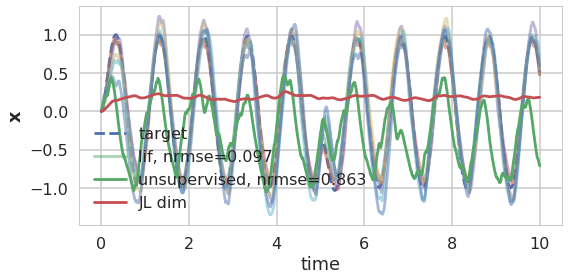

nrmse = 0.863
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

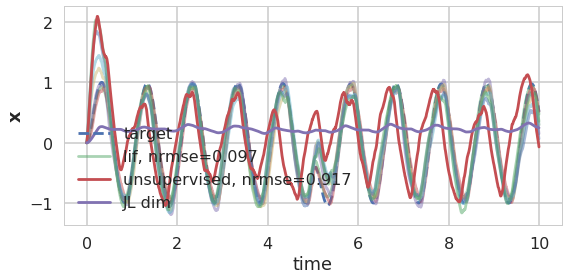

nrmse = 0.917
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

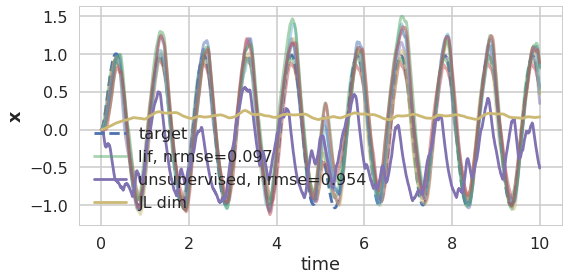

nrmse = 0.954
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

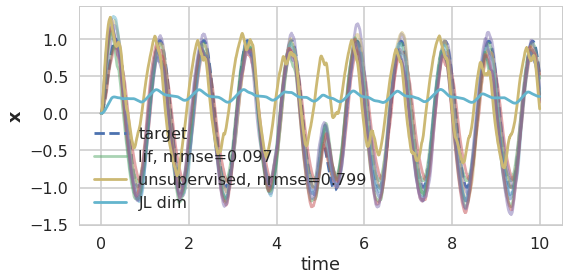

nrmse = 0.799
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

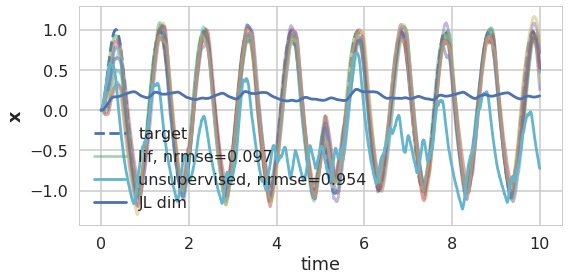

nrmse = 0.954


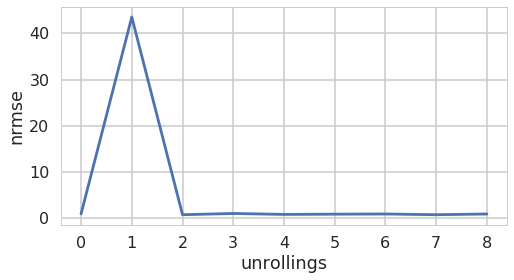

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

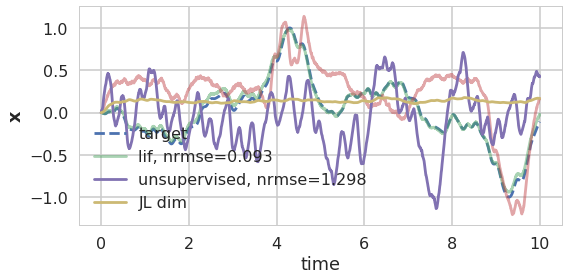

In [146]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=2*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=2e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

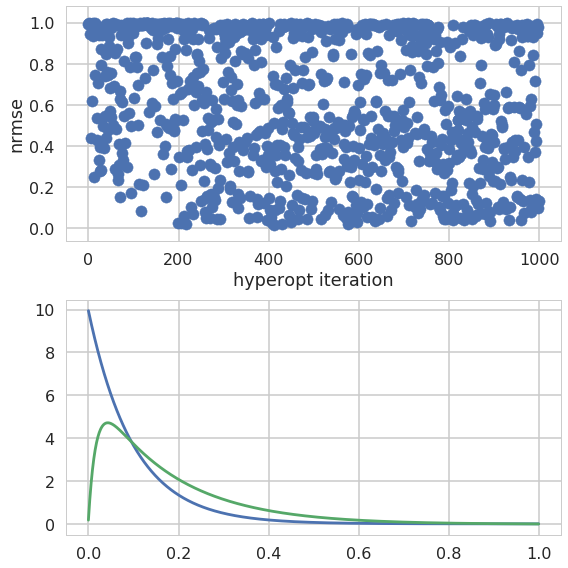

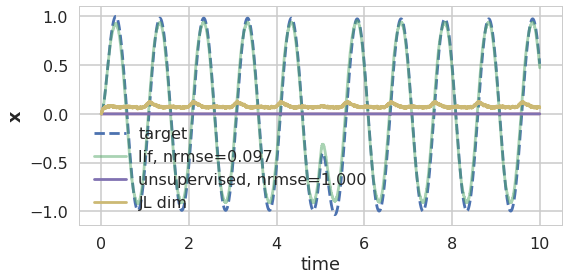

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

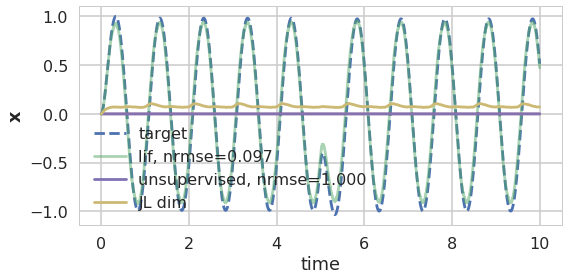

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

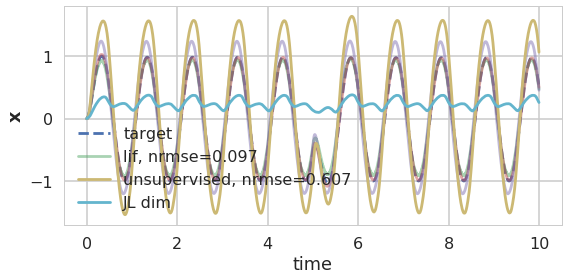

nrmse = 0.607
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

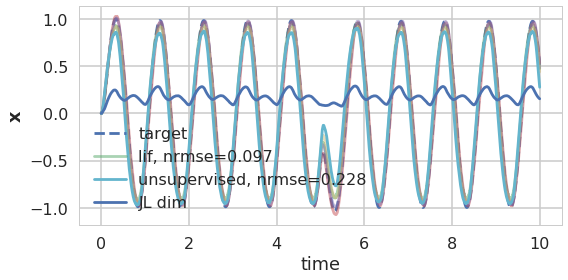

nrmse = 0.228
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

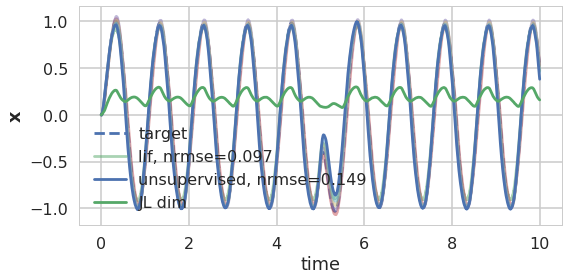

nrmse = 0.149
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

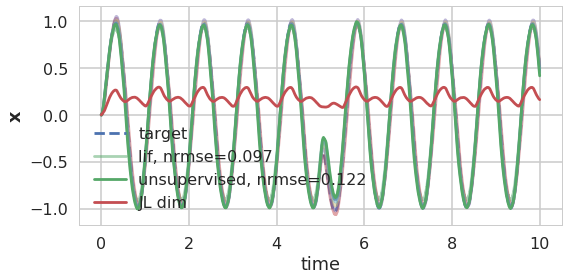

nrmse = 0.122
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

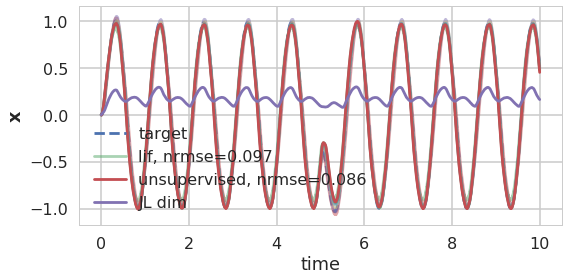

nrmse = 0.086
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

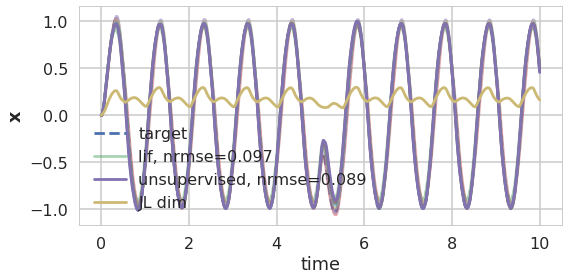

nrmse = 0.089
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

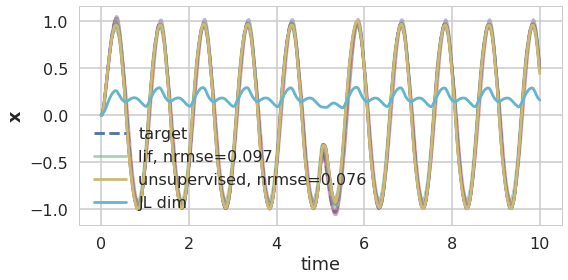

nrmse = 0.076
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

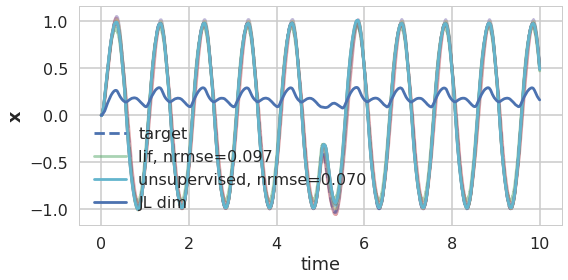

nrmse = 0.070


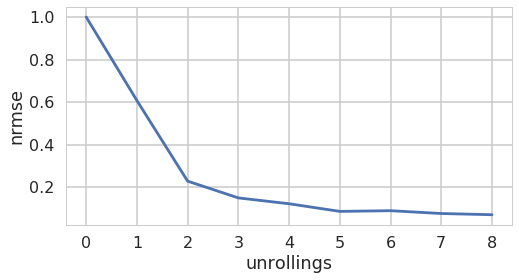

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

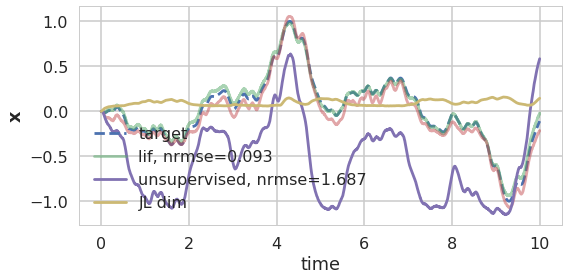

In [147]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=2*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

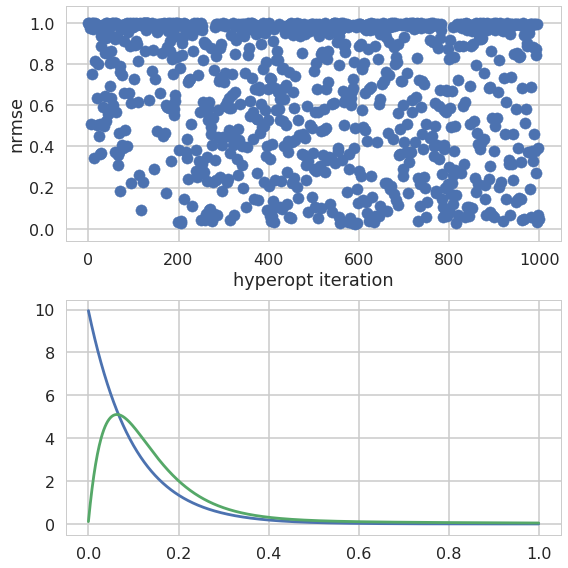

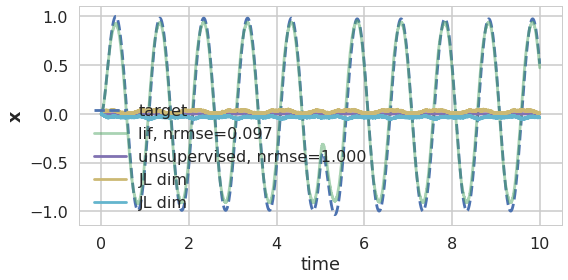

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

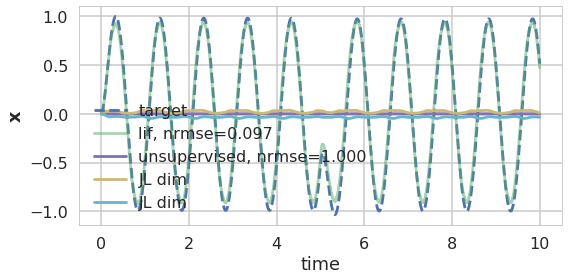

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

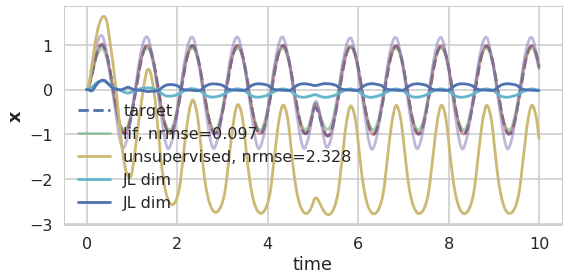

nrmse = 2.328
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

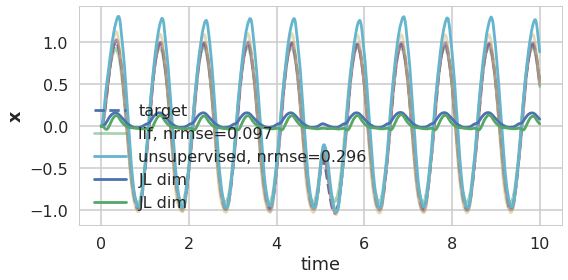

nrmse = 0.296
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

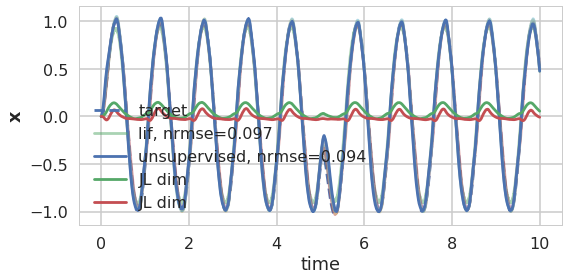

nrmse = 0.094
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

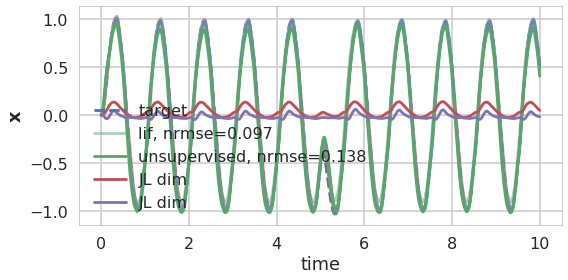

nrmse = 0.138
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

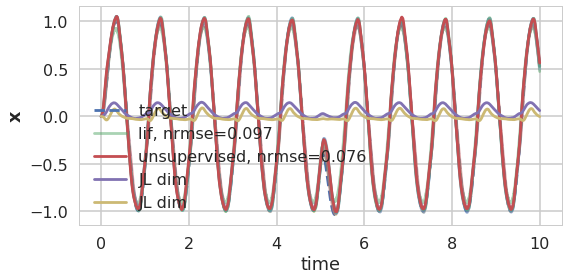

nrmse = 0.076
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

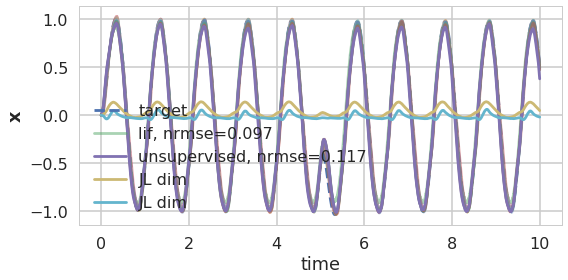

nrmse = 0.117
unrolling #7


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

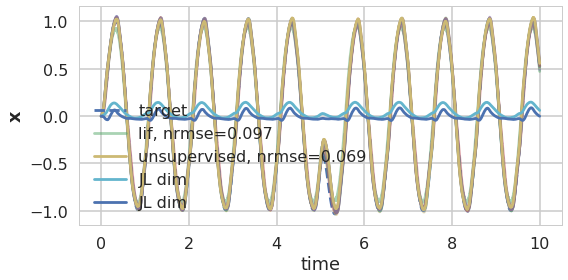

nrmse = 0.069
unrolling #8


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

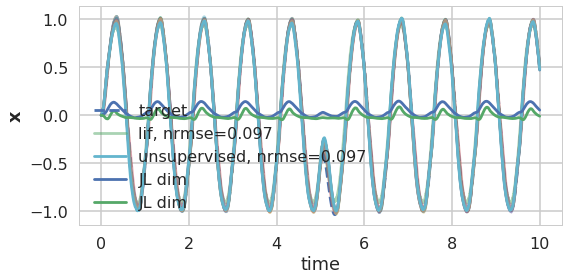

nrmse = 0.097


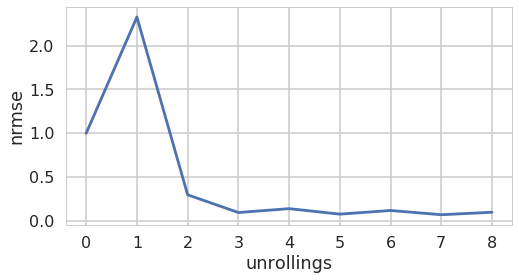

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

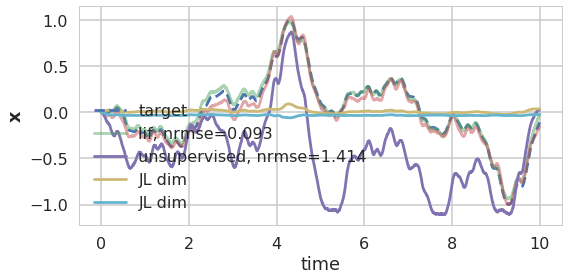

In [149]:
kwargs = dict(
    t=10,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=2*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=2,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=8, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

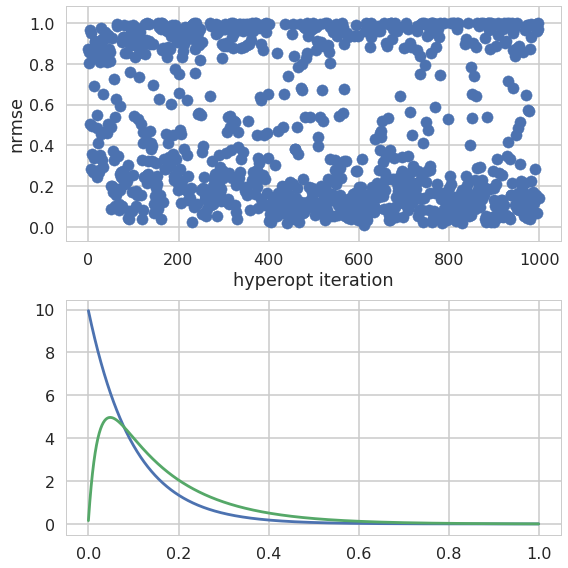

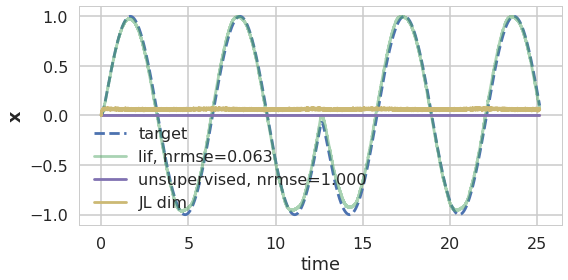

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

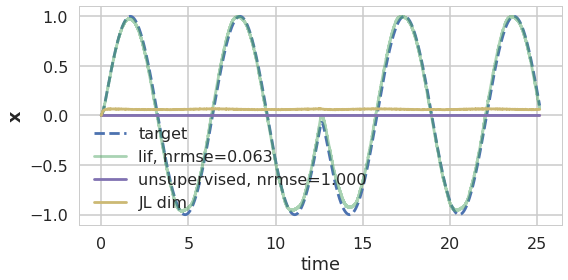

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

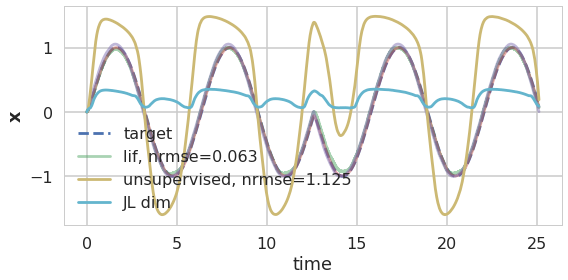

nrmse = 1.125
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

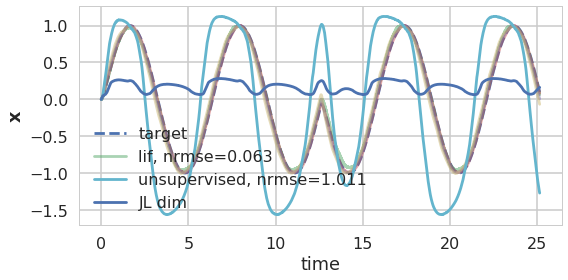

nrmse = 1.011
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

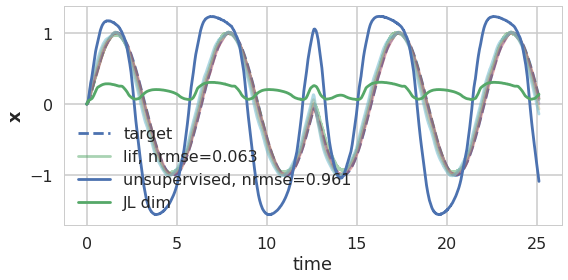

nrmse = 0.961
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

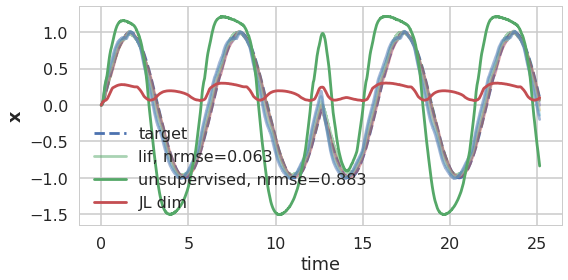

nrmse = 0.883
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

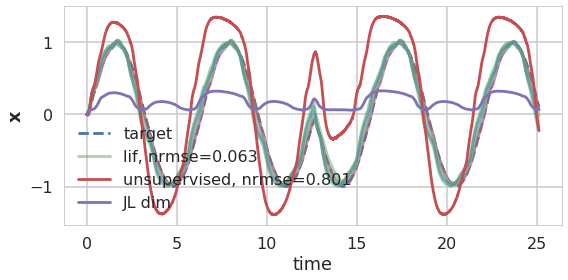

nrmse = 0.801
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

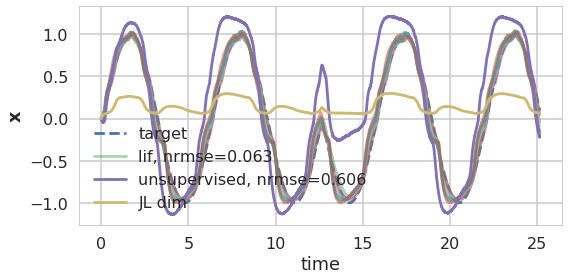

nrmse = 0.606


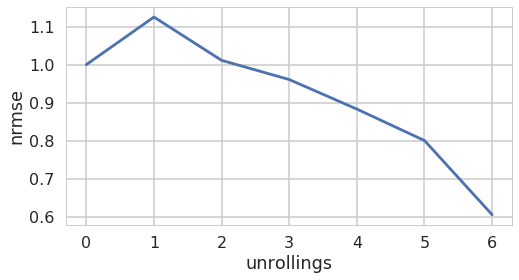

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

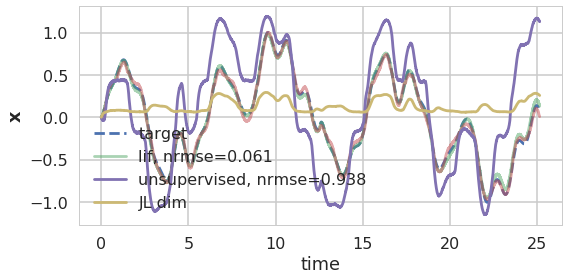

In [165]:
kwargs = dict(
    t=8*np.pi,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

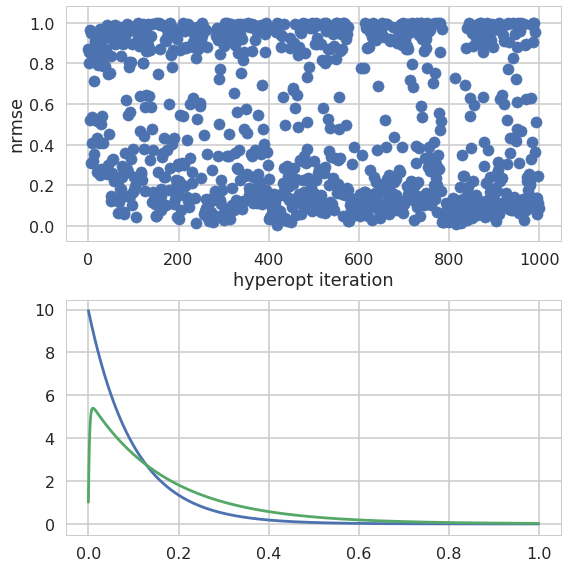

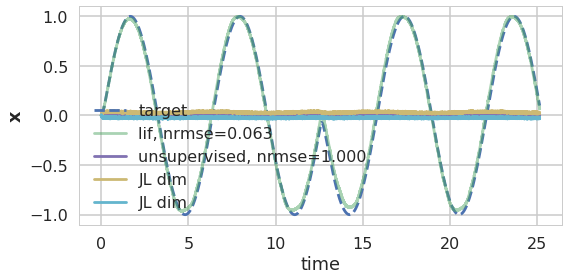

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

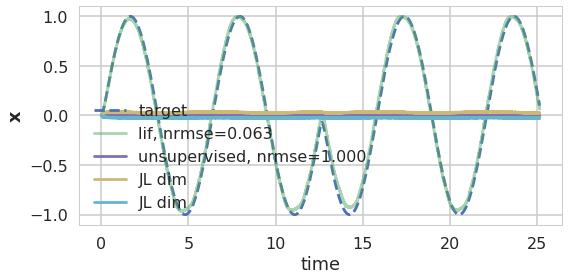

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

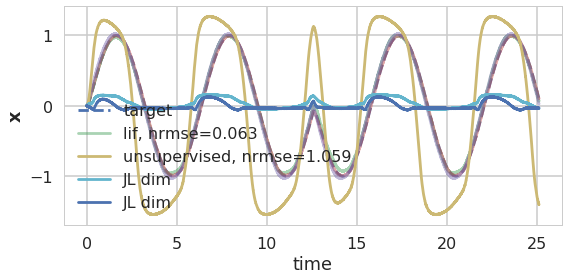

nrmse = 1.059
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

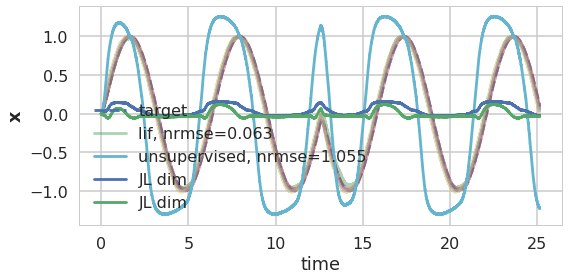

nrmse = 1.055
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

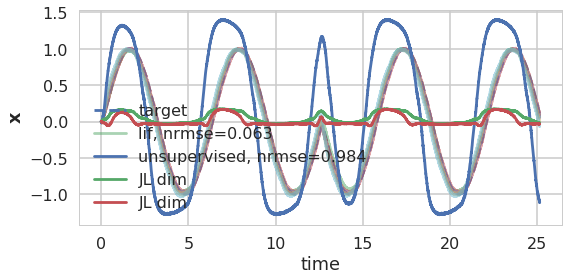

nrmse = 0.984
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

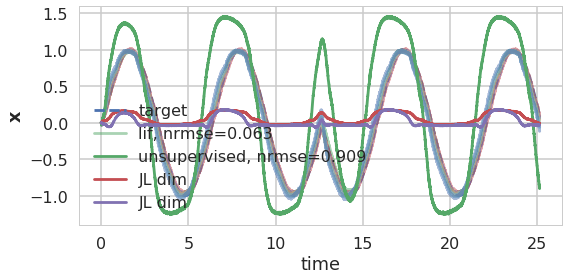

nrmse = 0.909
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

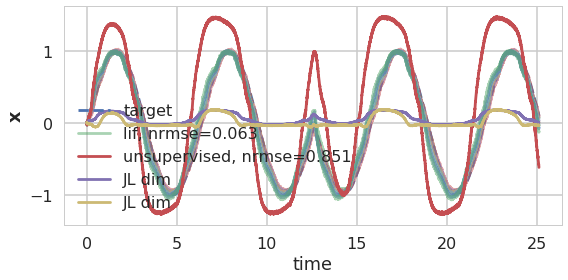

nrmse = 0.851
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

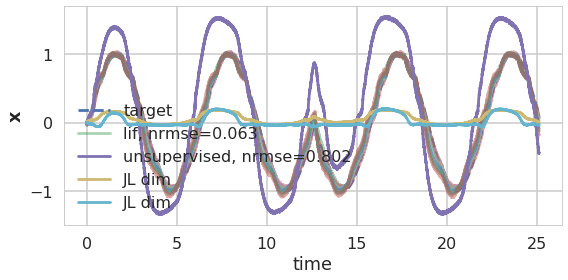

nrmse = 0.802


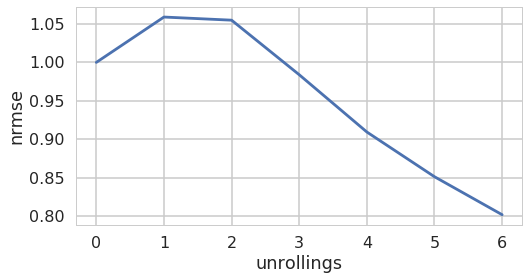

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

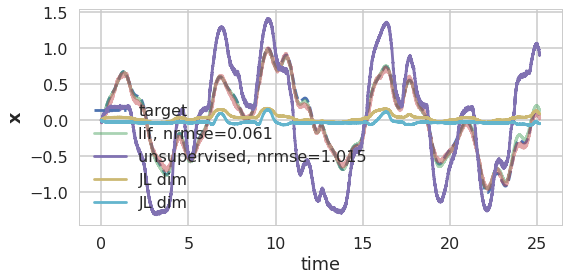

In [166]:
kwargs = dict(
    t=8*np.pi,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=2,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

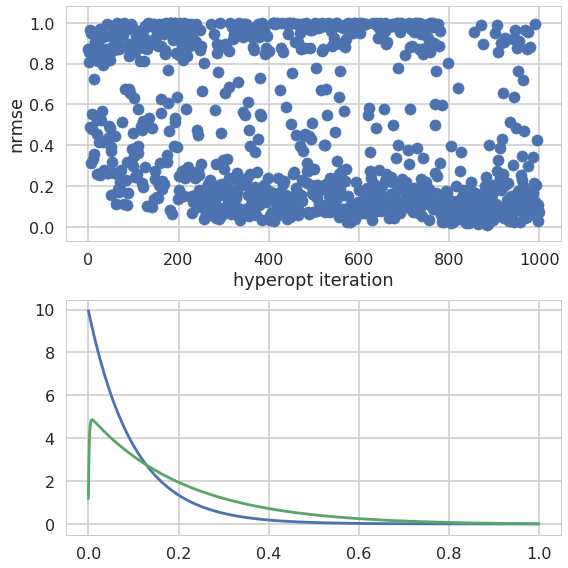

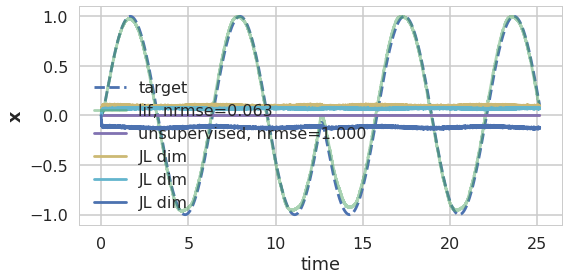

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

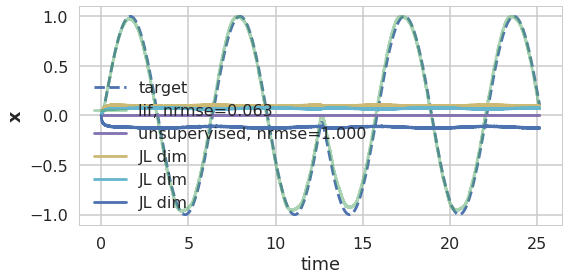

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

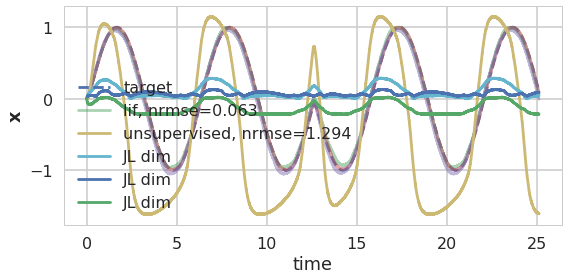

nrmse = 1.294
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

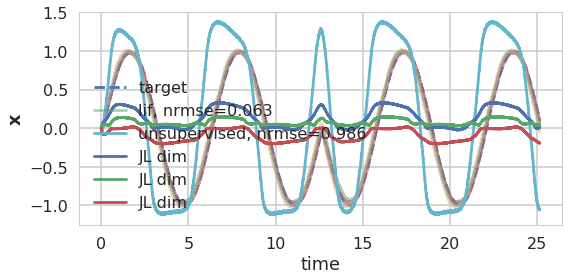

nrmse = 0.986
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

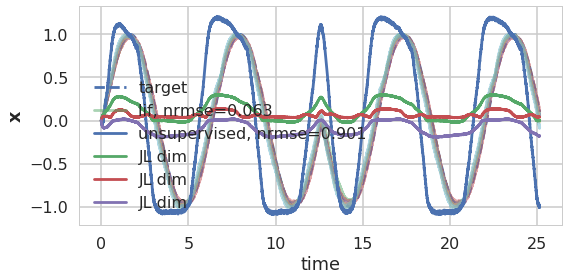

nrmse = 0.901
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

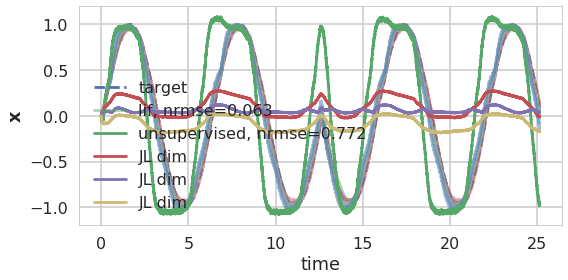

nrmse = 0.772
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

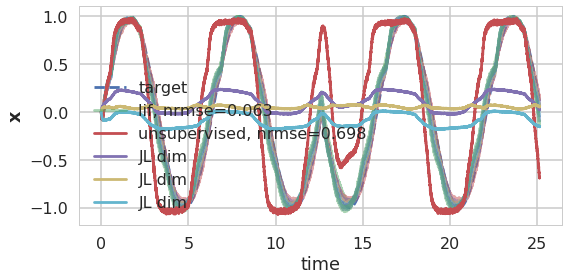

nrmse = 0.698
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

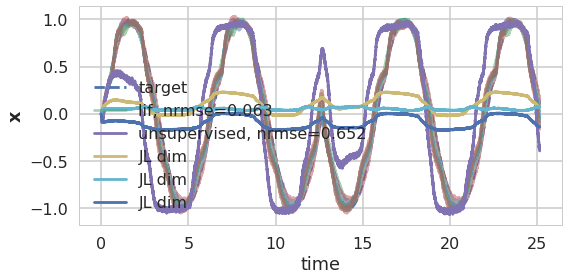

nrmse = 0.652


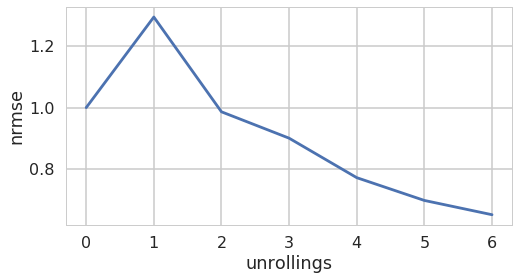

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

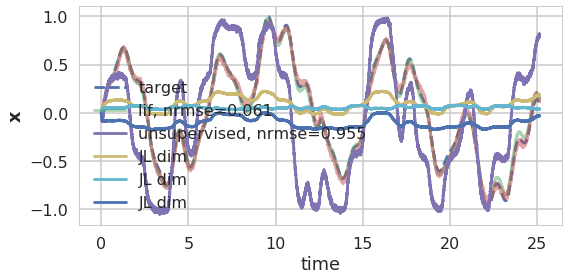

In [167]:
kwargs = dict(
    t=8*np.pi,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=1,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

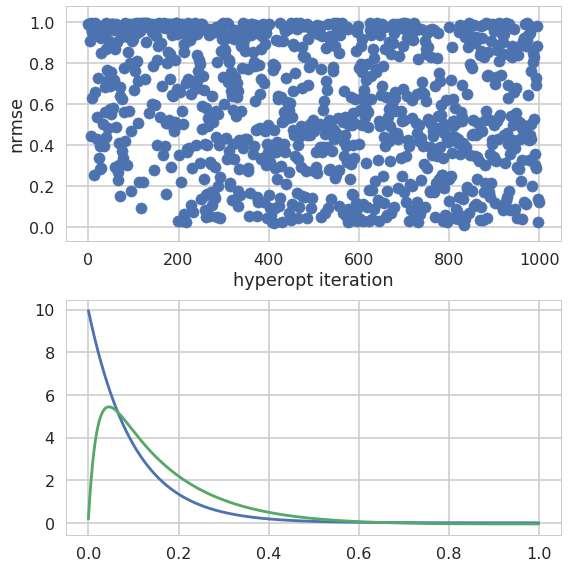

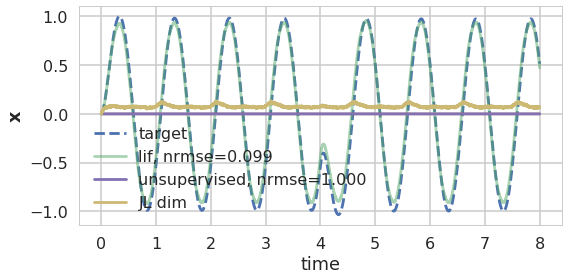

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

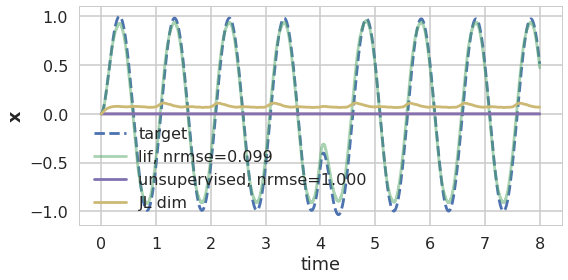

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

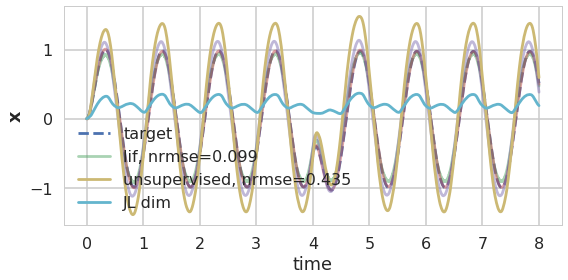

nrmse = 0.435
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

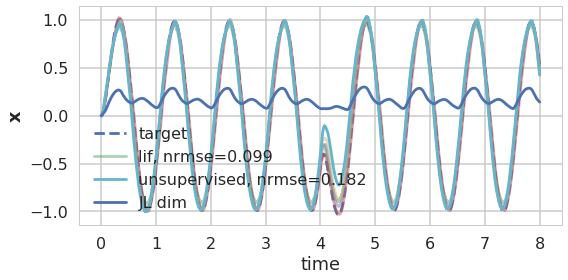

nrmse = 0.182
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

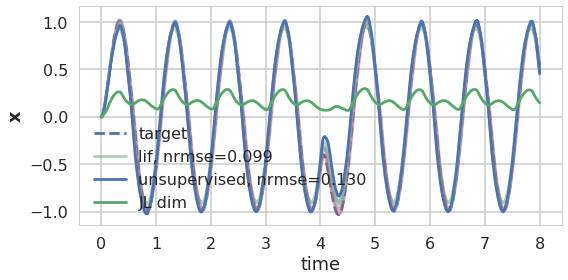

nrmse = 0.130
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

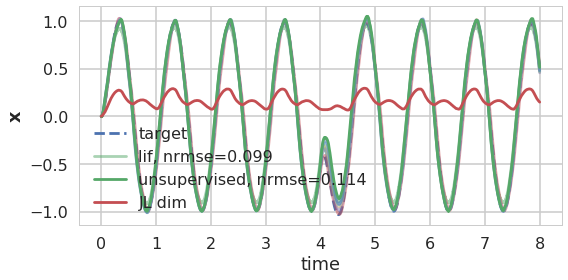

nrmse = 0.114
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

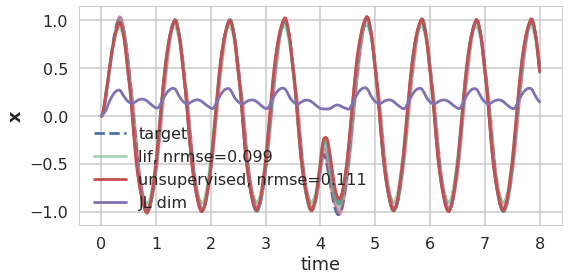

nrmse = 0.111
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

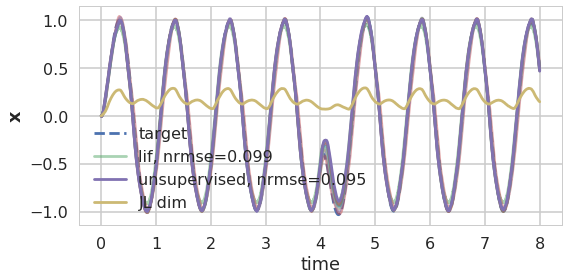

nrmse = 0.095


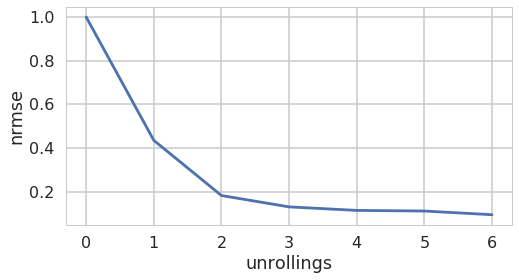

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

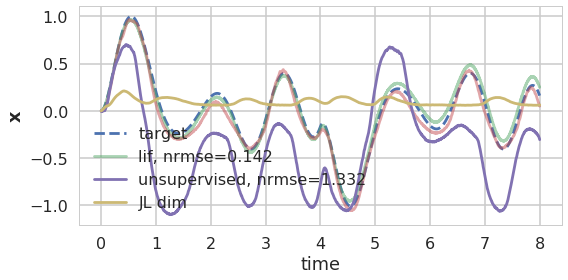

In [174]:
kwargs = dict(
    t=8,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=2*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=1,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

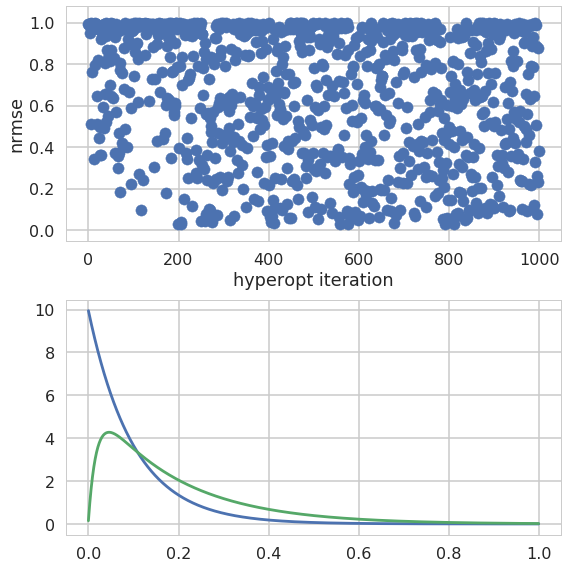

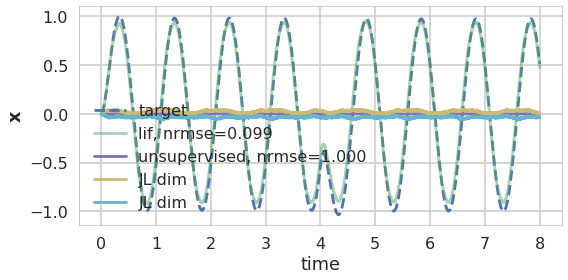

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

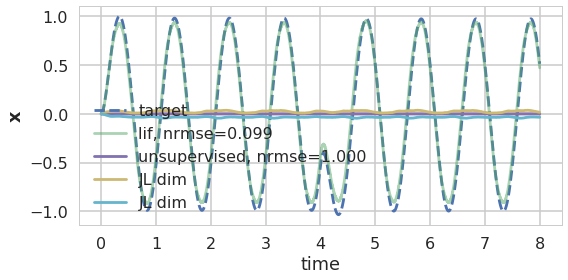

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

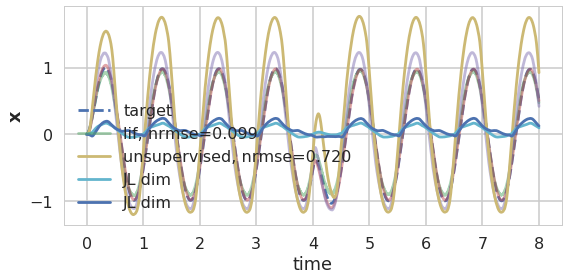

nrmse = 0.720
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

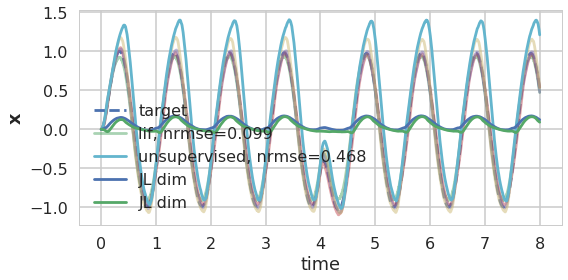

nrmse = 0.468
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

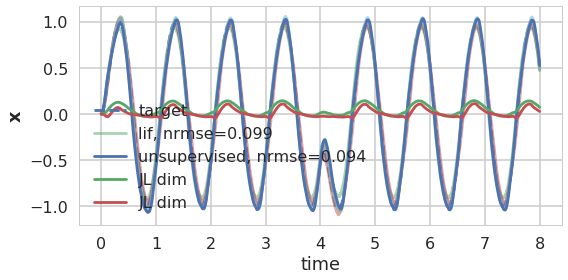

nrmse = 0.094
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

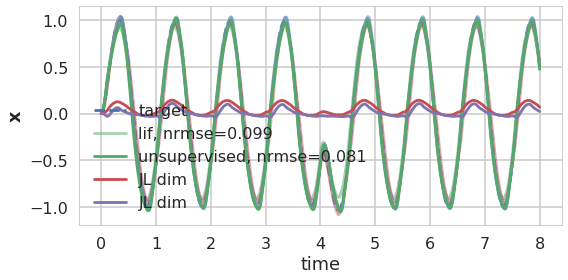

nrmse = 0.081
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

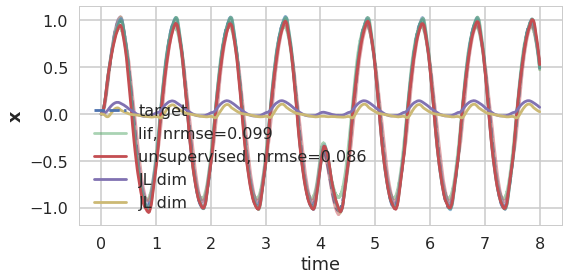

nrmse = 0.086
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

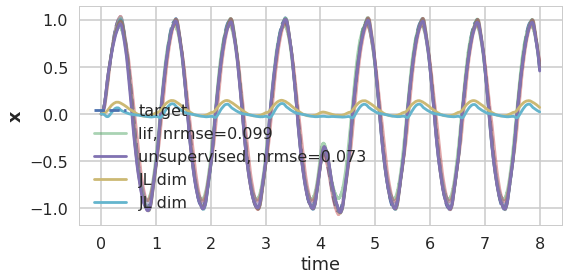

nrmse = 0.073


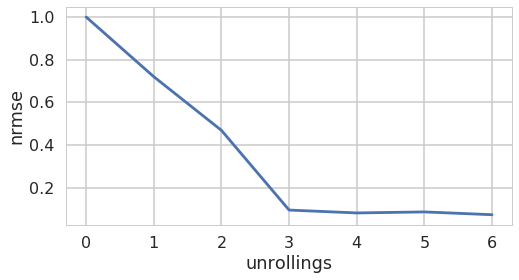

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

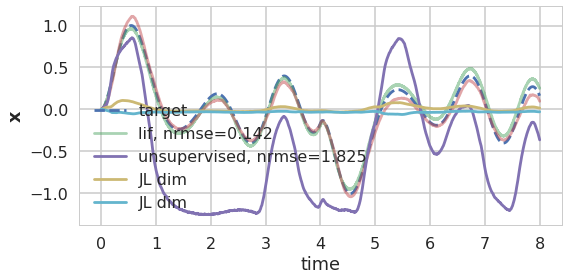

In [84]:
kwargs = dict(
    t=8,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=2*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=2,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

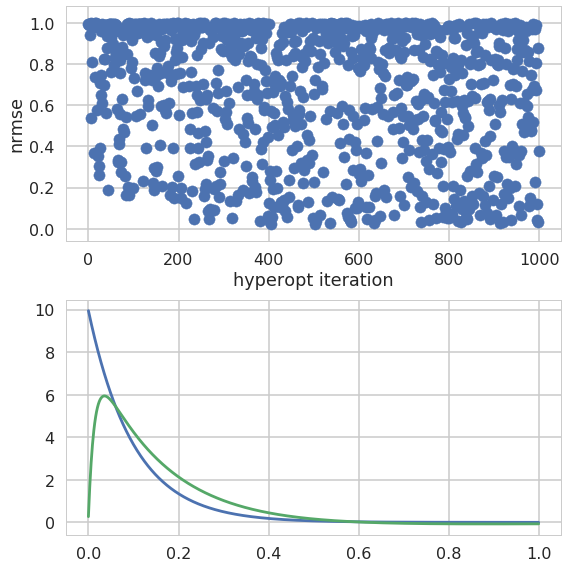

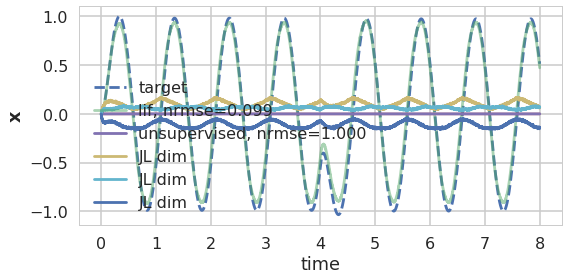

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

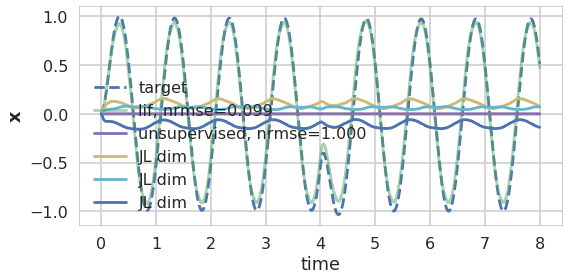

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

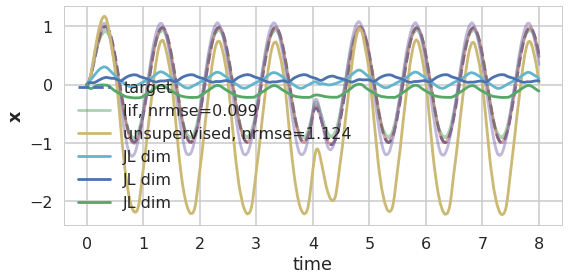

nrmse = 1.124
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

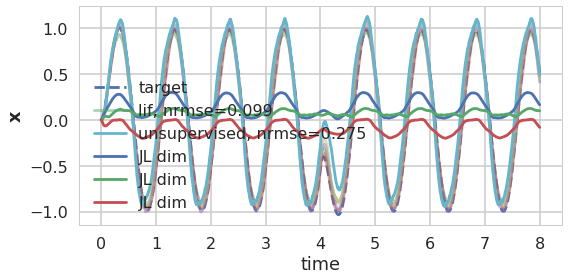

nrmse = 0.275
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

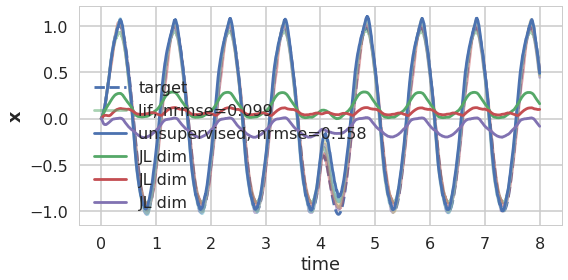

nrmse = 0.158
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

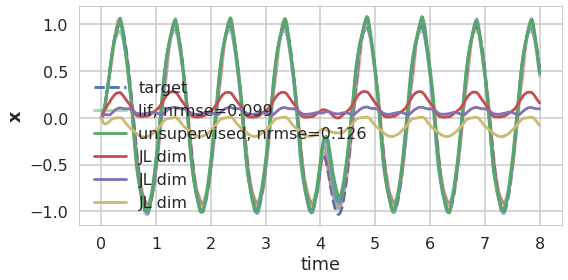

nrmse = 0.126
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

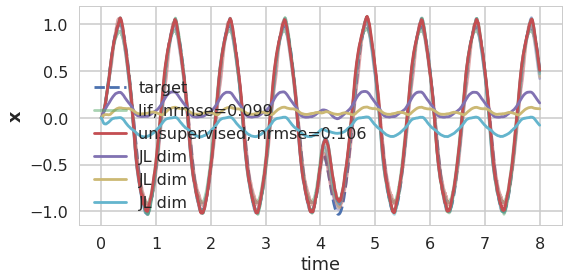

nrmse = 0.106
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

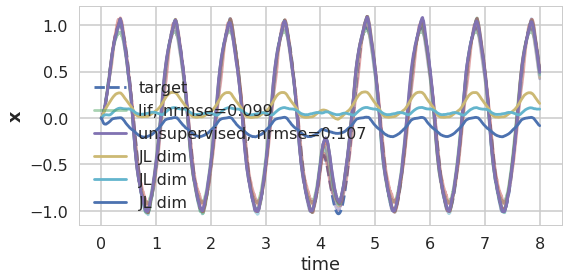

nrmse = 0.107


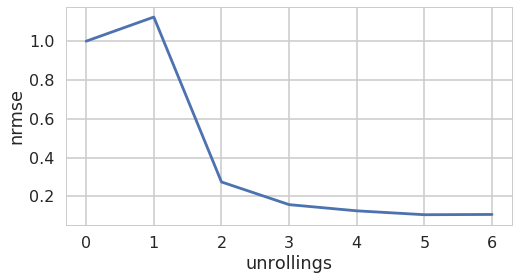

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

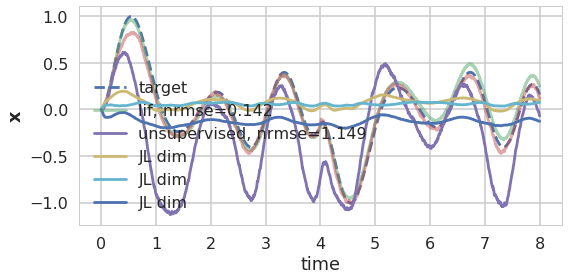

In [10]:
kwargs = dict(
    t=8,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=2*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=2e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

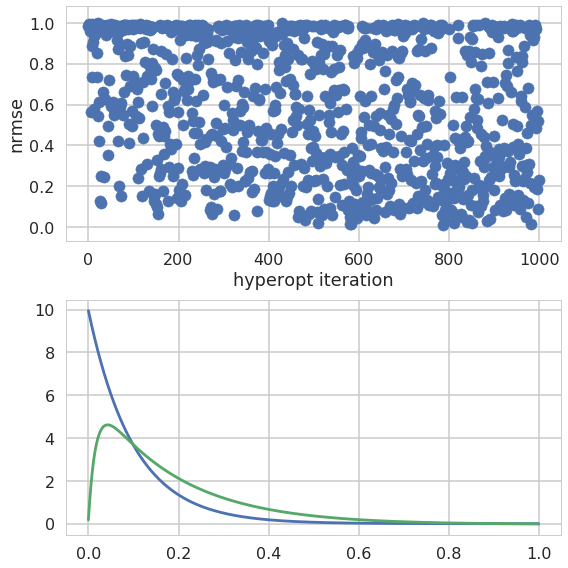

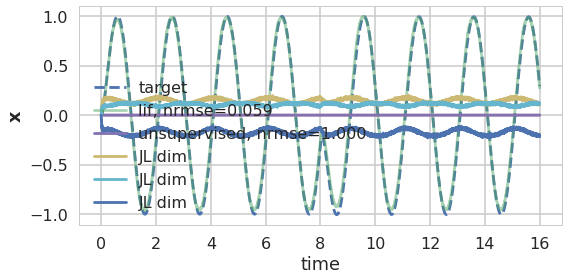

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

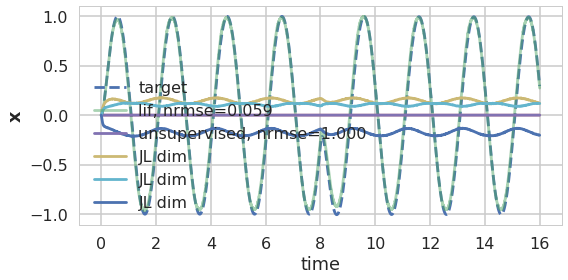

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

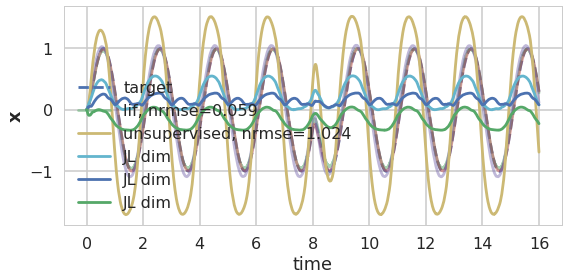

nrmse = 1.024
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

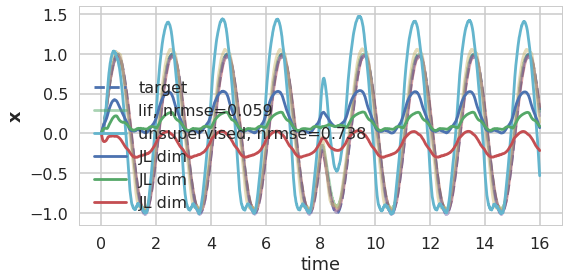

nrmse = 0.738
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

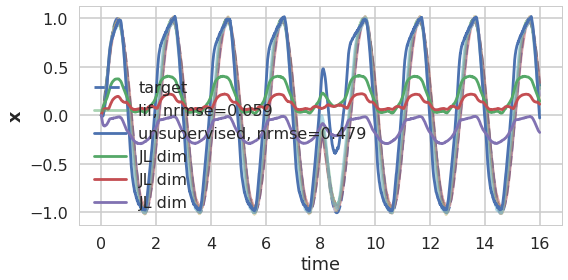

nrmse = 0.479
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

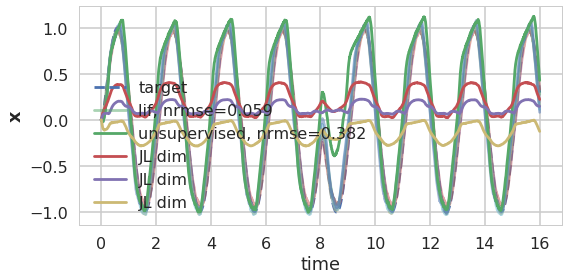

nrmse = 0.382
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

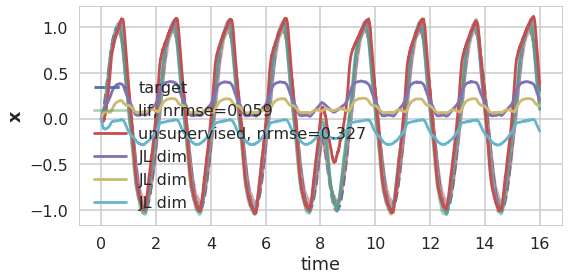

nrmse = 0.327
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

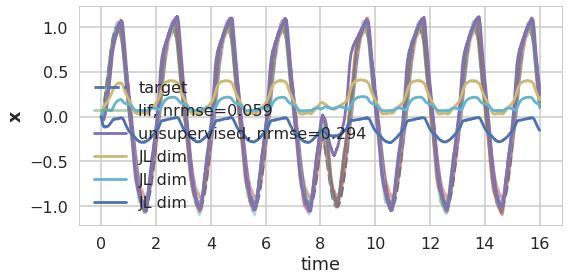

nrmse = 0.294


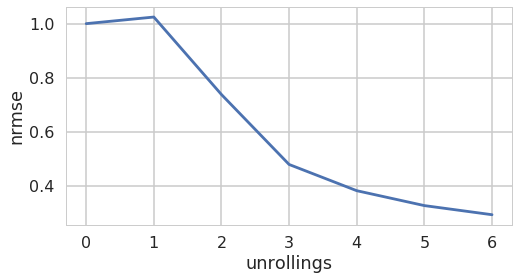

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

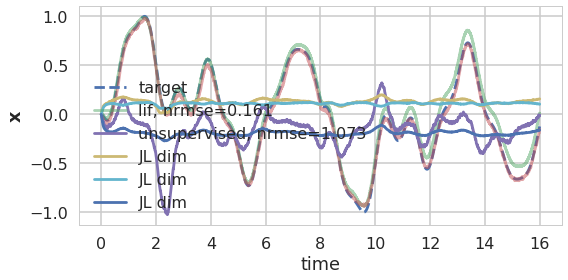

In [11]:
kwargs = dict(
    t=16,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=3e-4,
    reg=0.01,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

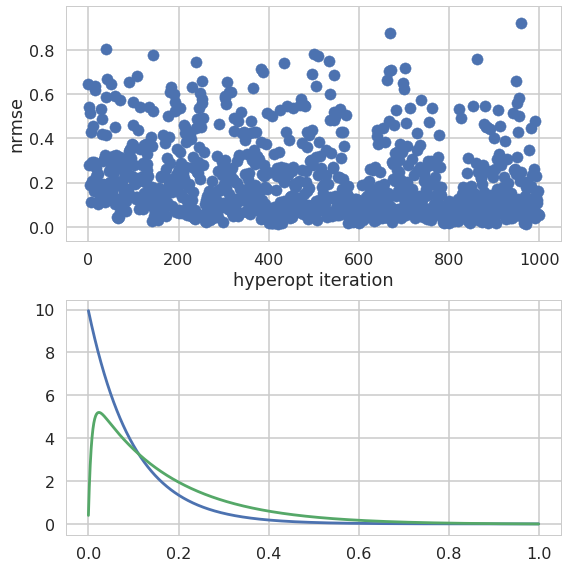

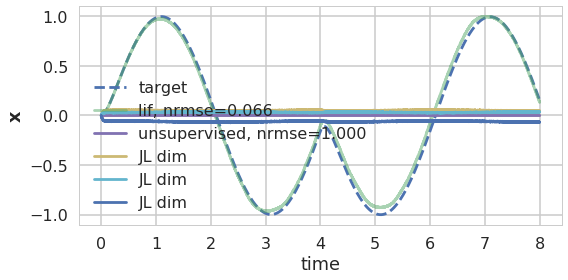

unrolling #0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

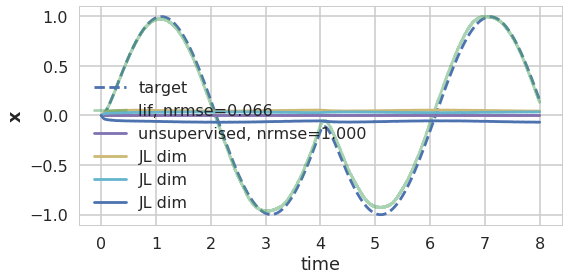

nrmse = 1.000
unrolling #1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

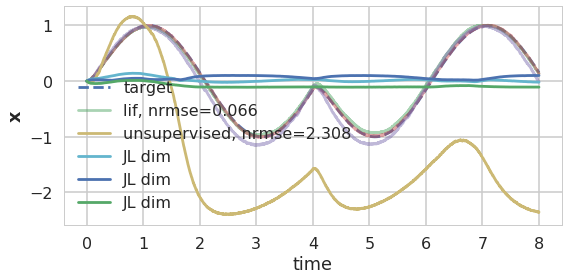

nrmse = 2.308
unrolling #2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

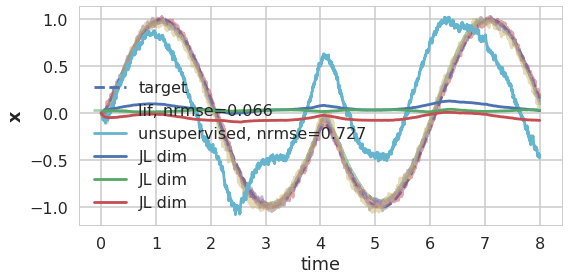

nrmse = 0.727
unrolling #3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

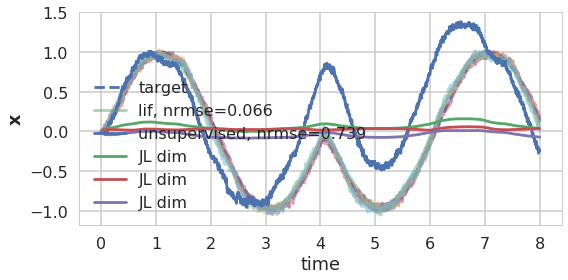

nrmse = 0.739
unrolling #4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

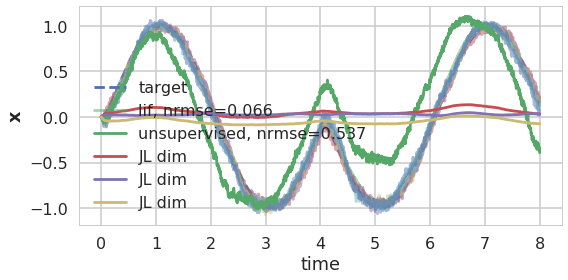

nrmse = 0.537
unrolling #5


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

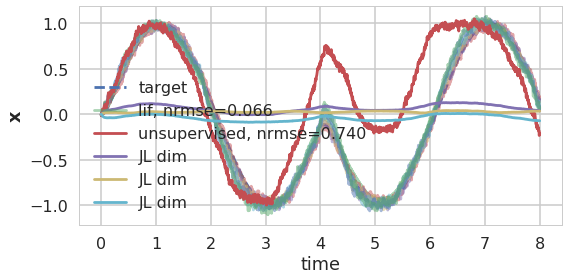

nrmse = 0.740
unrolling #6


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

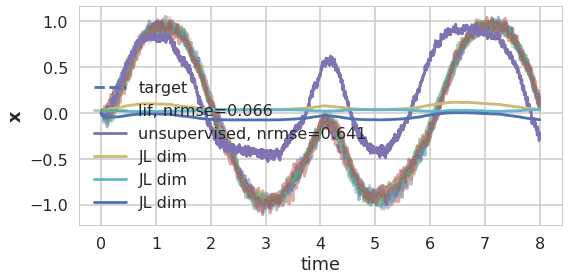

nrmse = 0.641


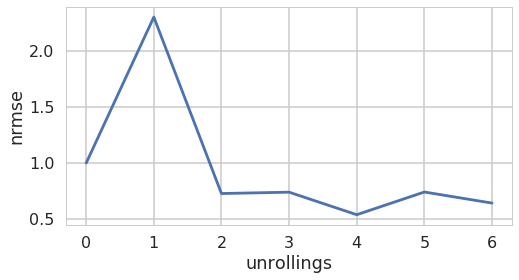

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

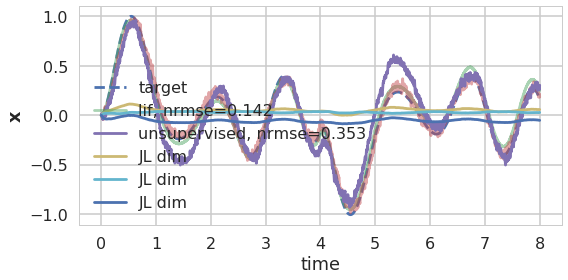

In [12]:
kwargs = dict(
    t=8,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    n_pre=100,
    freq=0.5*np.pi,
    amp=1,
    gain=Default,
    bias=Default,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    jl_dim=3,
    jl_sigma=1e-4,
    reg=0.001,
    n_zeros=1, 
    n_poles=3,
    z_min=0,
    z_max=1,
    p_min=0,
    p_max=1,
    max_evals=1000)

d_best, h_best = filter_first(n_unroll=6, signal='cos', optimize=True, plot=True, **kwargs)